<a href="https://colab.research.google.com/github/why2011btv/6d_pose_estimation/blob/master/Copy_of_C5_ML%26IA_image_human_pose_estimation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Human pose estimation

   
>    Zhe Cao, Tomas Simon, Shih-En Wei, and Yaser Sheikh
>
>   Realtime Multi-Person 2D Pose Estimation using Part Affinity Fields.   CVPR 2017

![alt text](https://github.com/ZheC/Multi-Person-Pose-Estimation/raw/master/readme/shake.gif)

This notebook is based on: https://github.com/ZheC/Realtime_Multi-Person_Pose_Estimation


In [1]:
# look at https://modelzoo.co/model/keras-realtime-multi-person-pose-estimation
!git clone https://github.com/kevinlin311tw/keras-openpose-reproduce.git
!mv keras-openpose-reproduce/* ./    &&    mkdir model/keras
!cd model   && sh get_keras_model.sh
!pip3 -q install Cython scikit-image pandas zmq h5py opencv-python configobj


Cloning into 'keras-openpose-reproduce'...
remote: Enumerating objects: 132, done.
remote: Total 132 (delta 0), reused 0 (delta 0), pack-reused 132
Receiving objects: 100% (132/132), 9.28 MiB | 8.77 MiB/s, done.
Resolving deltas: 100% (45/45), done.
--2024-01-29 15:12:46--  https://www.dropbox.com/s/llpxd14is7gyj0z/model.h5
Resolving www.dropbox.com (www.dropbox.com)... 162.125.2.18, 2620:100:6017:18::a27d:212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.2.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/llpxd14is7gyj0z/model.h5 [following]
--2024-01-29 15:12:47--  https://www.dropbox.com/s/raw/llpxd14is7gyj0z/model.h5
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc83e7c6a2b9bf77d089caa5d53f.dl.dropboxusercontent.com/cd/0/inline/CMT0QRw99HW20COyaFJMNYdQE7joBNO02uiFBICC1OPjeIM4zwDbgmPmpfEmJNOnVPGSKYPbnGZkuYNPor-Fm1wuJIlpiBqvUuPwhAJtjZLLDdxWobVjNlHkVd_br8OxOD8/fil

In [2]:
!unzip ./image_2470.zip


Archive:  ./image_2470.zip
   creating: image_2470/
  inflating: image_2470/Image_1502.jpg  
  inflating: __MACOSX/image_2470/._Image_1502.jpg  
  inflating: image_2470/Image_811.jpg  
  inflating: __MACOSX/image_2470/._Image_811.jpg  
  inflating: image_2470/Image_1264.jpg  
  inflating: __MACOSX/image_2470/._Image_1264.jpg  
  inflating: image_2470/Image_1270.jpg  
  inflating: __MACOSX/image_2470/._Image_1270.jpg  
  inflating: image_2470/Image_805.jpg  
  inflating: __MACOSX/image_2470/._Image_805.jpg  
  inflating: image_2470/Image_1516.jpg  
  inflating: __MACOSX/image_2470/._Image_1516.jpg  
  inflating: image_2470/Image_2037.jpg  
  inflating: __MACOSX/image_2470/._Image_2037.jpg  
  inflating: image_2470/Image_1258.jpg  
  inflating: __MACOSX/image_2470/._Image_1258.jpg  
  inflating: image_2470/Image_193.jpg  
  inflating: __MACOSX/image_2470/._Image_193.jpg  
  inflating: image_2470/Image_187.jpg  
  inflating: __MACOSX/image_2470/._Image_187.jpg  
  inflating: image_2470/Im

In [3]:

from tensorflow.keras import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Activation, Lambda
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Concatenate
from config_reader import config_reader
import scipy
import math



### Definition of model

Helper functions to create a model.  These are the individual blocks.

In [4]:
def relu(x):
    return Activation('relu')(x)

def conv(x, nf, ks, name):
    x1 = Conv2D(nf, (ks, ks), padding='same', name=name)(x)
    return x1

def pooling(x, ks, st, name):
    x = MaxPooling2D((ks, ks), strides=(st, st), name=name)(x)
    return x

def vgg_block(x):

    # Block 1
    x = conv(x, 64, 3, "conv1_1")
    x = relu(x)
    x = conv(x, 64, 3, "conv1_2")
    x = relu(x)
    x = pooling(x, 2, 2, "pool1_1")

    # Block 2
    x = conv(x, 128, 3, "conv2_1")
    x = relu(x)
    x = conv(x, 128, 3, "conv2_2")
    x = relu(x)
    x = pooling(x, 2, 2, "pool2_1")

    # Block 3
    x = conv(x, 256, 3, "conv3_1")
    x = relu(x)
    x = conv(x, 256, 3, "conv3_2")
    x = relu(x)
    x = conv(x, 256, 3, "conv3_3")
    x = relu(x)
    x = conv(x, 256, 3, "conv3_4")
    x = relu(x)
    x = pooling(x, 2, 2, "pool3_1")

    # Block 4
    x = conv(x, 512, 3, "conv4_1")
    x = relu(x)
    x = conv(x, 512, 3, "conv4_2")
    x = relu(x)

    # Additional non vgg layers
    x = conv(x, 256, 3, "conv4_3_CPM")
    x = relu(x)
    x = conv(x, 128, 3, "conv4_4_CPM")
    x = relu(x)

    return x

def stage1_block(x, num_p, branch):

    # Block 1
    x = conv(x, 128, 3, "conv5_1_CPM_L%d" % branch)
    x = relu(x)
    x = conv(x, 128, 3, "conv5_2_CPM_L%d" % branch)
    x = relu(x)
    x = conv(x, 128, 3, "conv5_3_CPM_L%d" % branch)
    x = relu(x)
    x = conv(x, 512, 1, "conv5_4_CPM_L%d" % branch)
    x = relu(x)
    x = conv(x, num_p, 1, "conv5_5_CPM_L%d" % branch)

    return x

def stageT_block(x, num_p, stage, branch):

    # Block 1
    x = conv(x, 128, 7, "Mconv1_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 7, "Mconv2_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 7, "Mconv3_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 7, "Mconv4_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 7, "Mconv5_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, 128, 1, "Mconv6_stage%d_L%d" % (stage, branch))
    x = relu(x)
    x = conv(x, num_p, 1, "Mconv7_stage%d_L%d" % (stage, branch))

    return x

![openpose architecture](https://github.com/ZheC/Multi-Person-Pose-Estimation/raw/master/readme/arch.png)

Create keras model by assembling the blocks and load the pretrained weights.

In [5]:
weights_path = "model/keras/model.h5" # orginal weights converted from caffe
#weights_path = "training/weights.best.h5" # weights tarined from scratch

input_shape = (None,None,3)

img_input = Input(shape=input_shape)

stages = 6
np_branch1 = 38
np_branch2 = 19

img_normalized = Lambda(lambda x: x / 256 - 0.5)(img_input)  # [-0.5, 0.5]

# VGG
stage0_out = vgg_block(img_normalized)

# stage 1
stage1_branch1_out = stage1_block(stage0_out, np_branch1, 1)
stage1_branch2_out = stage1_block(stage0_out, np_branch2, 2)
x = Concatenate()([stage1_branch1_out, stage1_branch2_out, stage0_out])

# stage t >= 2
for sn in range(2, stages + 1):
    stageT_branch1_out = stageT_block(x, np_branch1, sn, 1)
    stageT_branch2_out = stageT_block(x, np_branch2, sn, 2)
    if (sn < stages):
        x = Concatenate()([stageT_branch1_out, stageT_branch2_out, stage0_out])

model = Model(img_input, [stageT_branch1_out, stageT_branch2_out])
model.load_weights(weights_path)

### Applying the model to an image

Load a sample image

In [6]:
%matplotlib inline
import cv2
import matplotlib
import pylab as plt
import numpy as np
import util

Folder './out' created.
scale factors for this image: [1.15, 2.3, 3.45, 4.6]
Input shape: (1, 184, 280, 3)
1/1 [==============================] - 4s 4s/step
Output shape (heatmap): (1, 23, 35, 19)
Input shape: (1, 368, 552, 3)
1/1 [==============================] - 3s 3s/step
Output shape (heatmap): (1, 46, 69, 19)
Input shape: (1, 552, 832, 3)
1/1 [==============================] - 3s 3s/step
Output shape (heatmap): (1, 69, 104, 19)
Input shape: (1, 736, 1104, 3)
1/1 [==============================] - 5s 5s/step
Output shape (heatmap): (1, 92, 138, 19)


<ipython-input-7-26d7ad35f678>:113: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter
<ipython-input-7-26d7ad35f678>:143: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('hsv')


Printing keypoint
scale factors for this image: [1.005464480874317, 2.010928961748634, 3.0163934426229506, 4.021857923497268]
Input shape: (1, 184, 280, 3)
1/1 [==============================] - 0s 23ms/step
Output shape (heatmap): (1, 23, 35, 19)
Input shape: (1, 368, 560, 3)
1/1 [==============================] - 2s 2s/step
Output shape (heatmap): (1, 46, 70, 19)
Input shape: (1, 552, 832, 3)
1/1 [==============================] - 0s 25ms/step
Output shape (heatmap): (1, 69, 104, 19)
Input shape: (1, 736, 1112, 3)
1/1 [==============================] - 5s 5s/step
Output shape (heatmap): (1, 92, 139, 19)
Printing keypoint
scale factors for this image: [1.005464480874317, 2.010928961748634, 3.0163934426229506, 4.021857923497268]
Input shape: (1, 184, 280, 3)
1/1 [==============================] - 0s 32ms/step
Output shape (heatmap): (1, 23, 35, 19)
Input shape: (1, 368, 560, 3)
1/1 [==============================] - 0s 40ms/step
Output shape (heatmap): (1, 46, 70, 19)
Input shape: (1, 

<ipython-input-7-26d7ad35f678>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12,12))


Input shape: (1, 184, 216, 3)
1/1 [==============================] - 1s 1s/step
Output shape (heatmap): (1, 23, 27, 19)
Input shape: (1, 368, 424, 3)
1/1 [==============================] - 2s 2s/step
Output shape (heatmap): (1, 46, 53, 19)
Input shape: (1, 552, 632, 3)
1/1 [==============================] - 3s 3s/step
Output shape (heatmap): (1, 69, 79, 19)
Input shape: (1, 736, 848, 3)
1/1 [==============================] - 5s 5s/step
Output shape (heatmap): (1, 92, 106, 19)
Printing keypoint
scale factors for this image: [2.1904761904761907, 4.380952380952381, 6.571428571428571, 8.761904761904763]
Input shape: (1, 184, 280, 3)
1/1 [==============================] - 0s 21ms/step
Output shape (heatmap): (1, 23, 35, 19)
Input shape: (1, 368, 552, 3)
1/1 [==============================] - 0s 22ms/step
Output shape (heatmap): (1, 46, 69, 19)
Input shape: (1, 552, 832, 3)
1/1 [==============================] - 0s 24ms/step
Output shape (heatmap): (1, 69, 104, 19)
Input shape: (1, 736, 1104

AttributeError: 'Figure' object has no attribute 'close'

<Figure size 1200x1200 with 0 Axes>

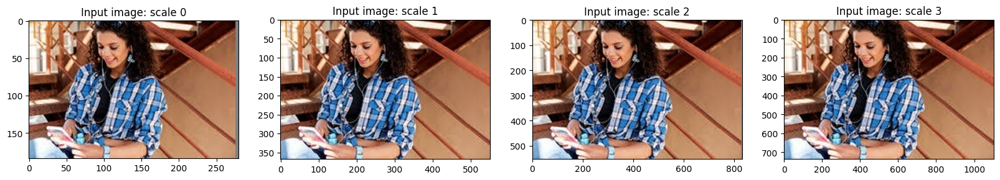

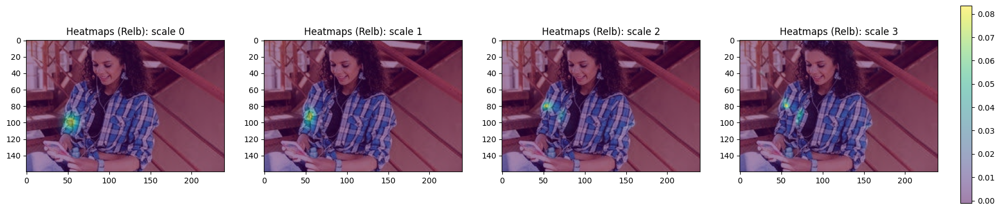

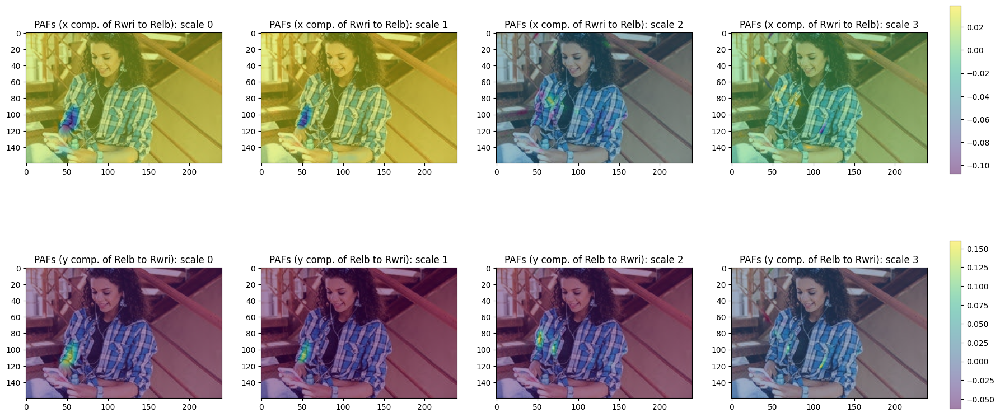

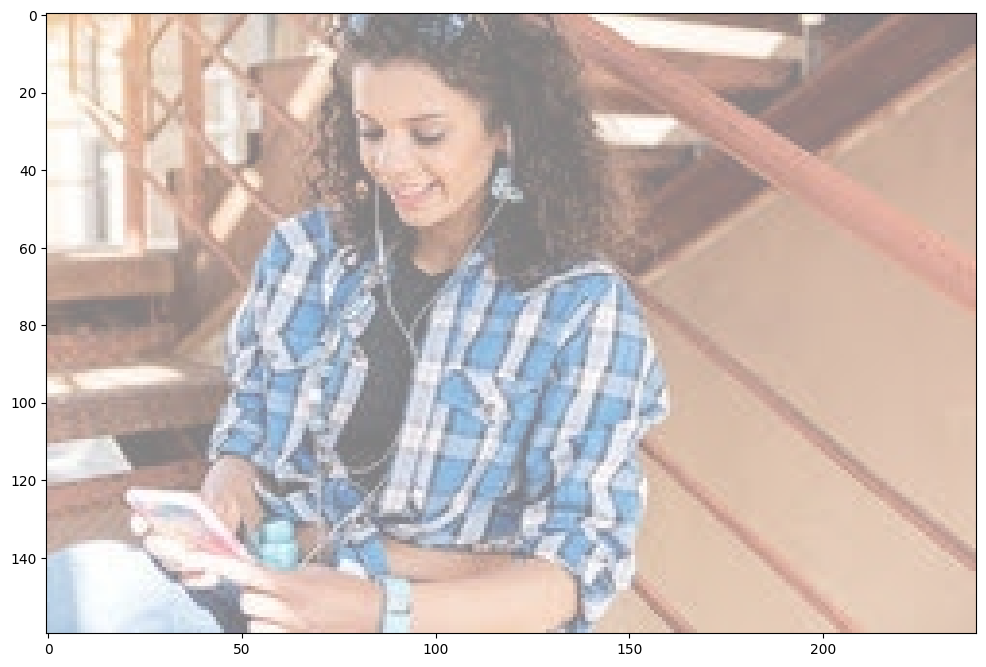

<Figure size 1200x1200 with 0 Axes>

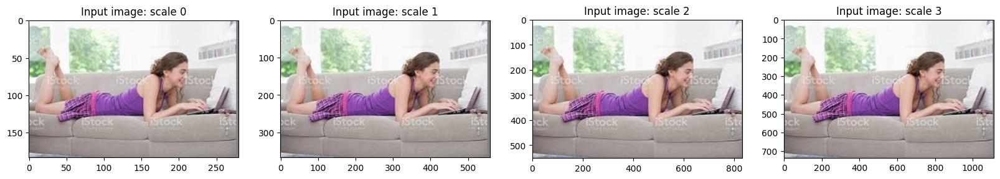

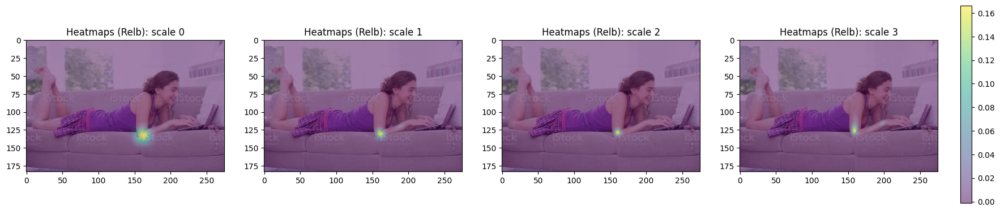

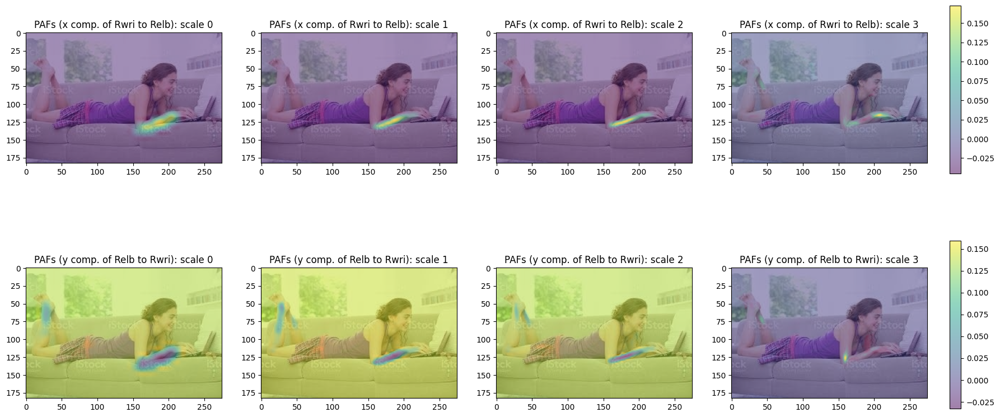

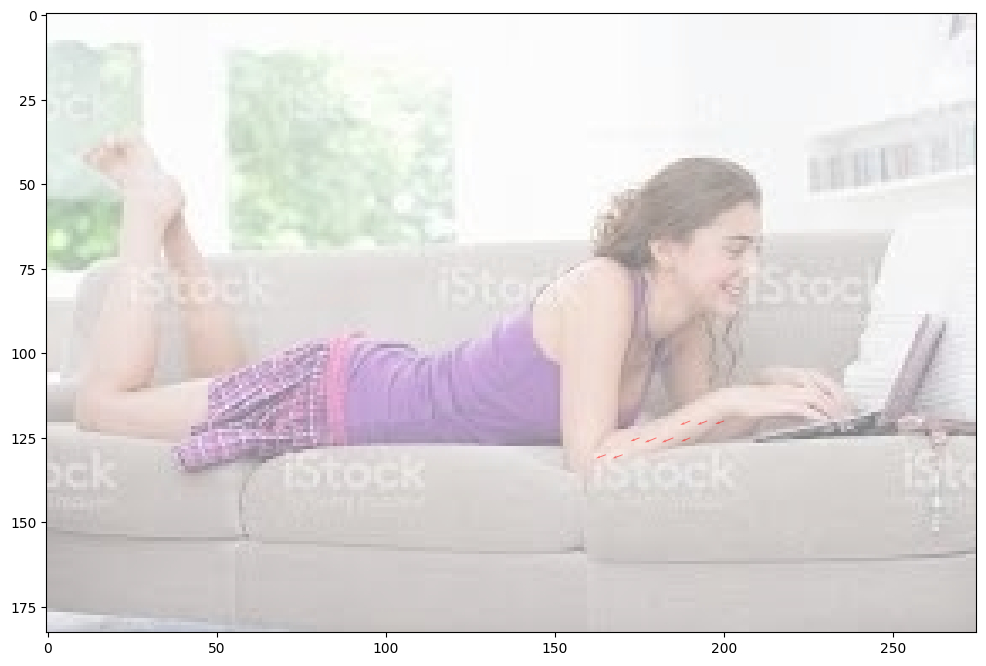

<Figure size 1200x1200 with 0 Axes>

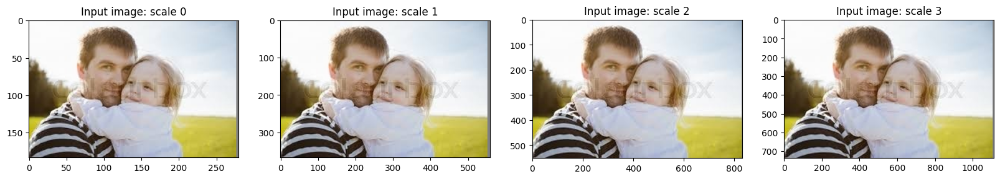

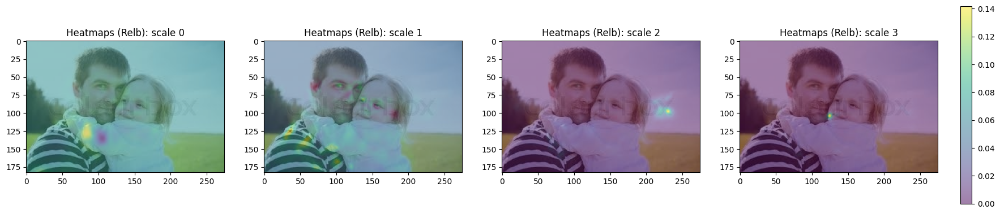

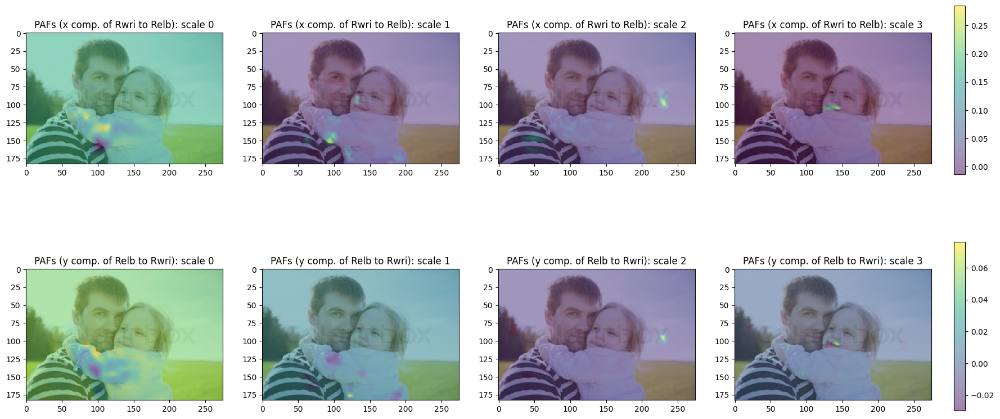

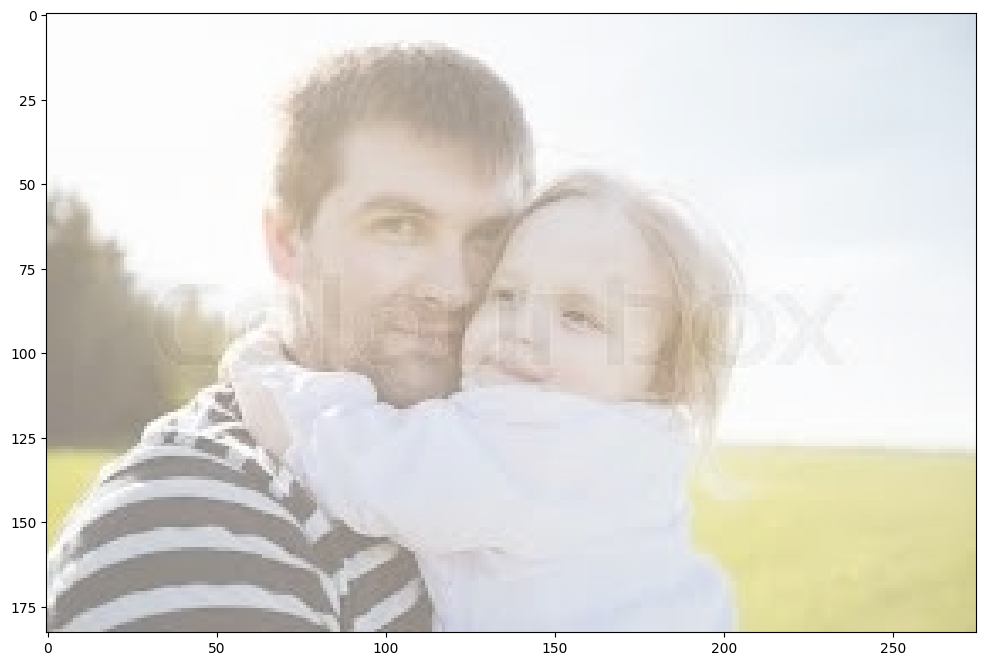

<Figure size 1200x1200 with 0 Axes>

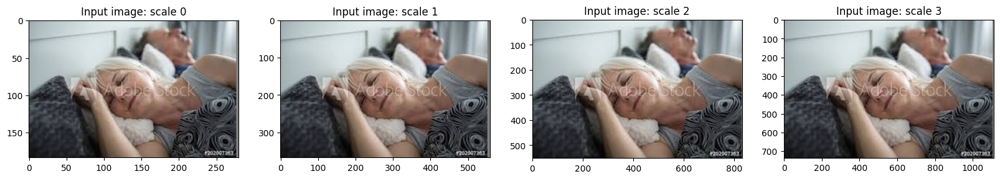

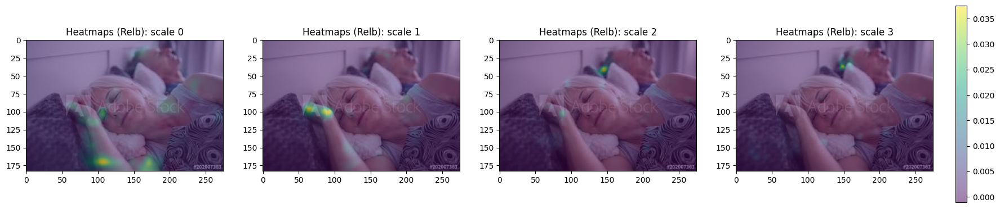

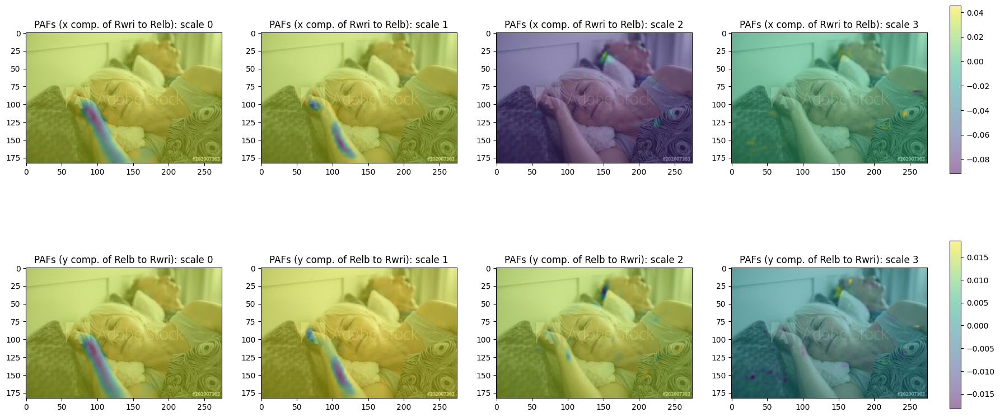

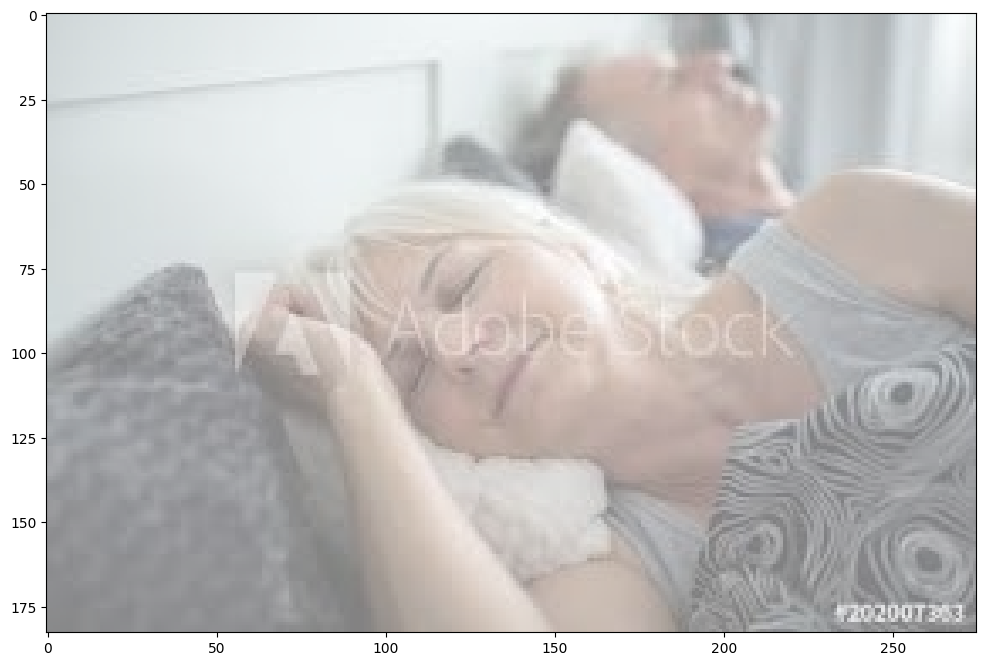

<Figure size 1200x1200 with 0 Axes>

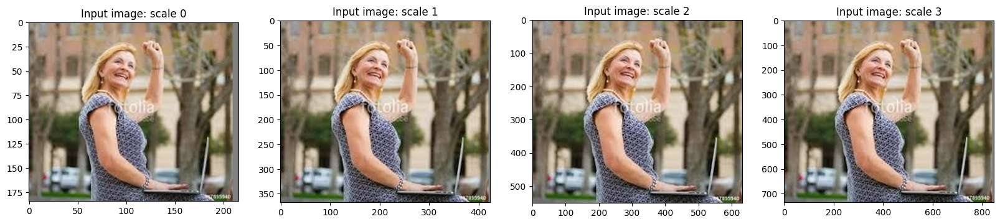

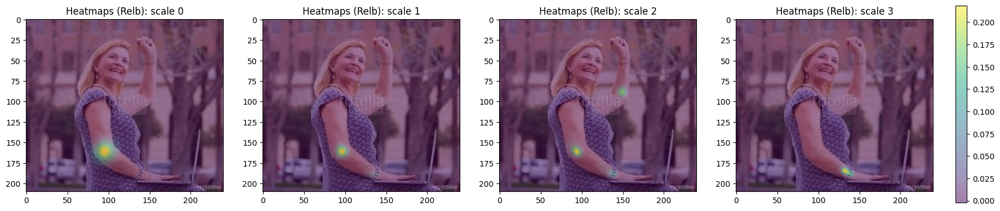

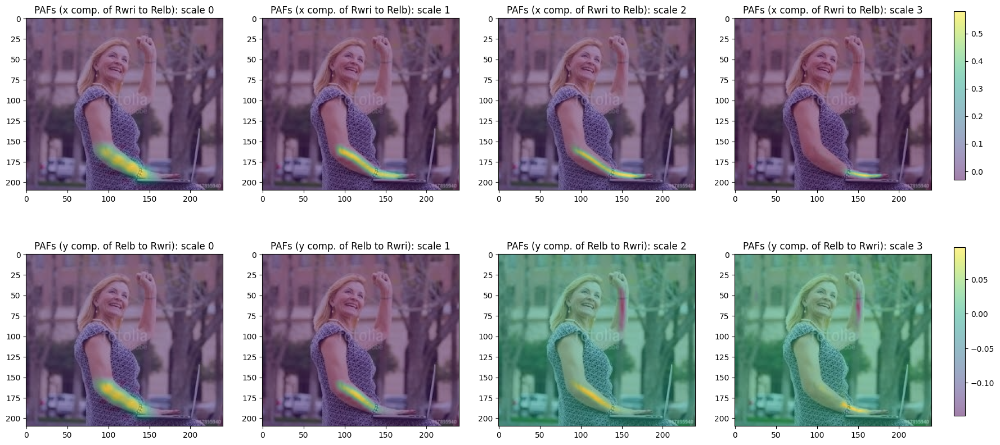

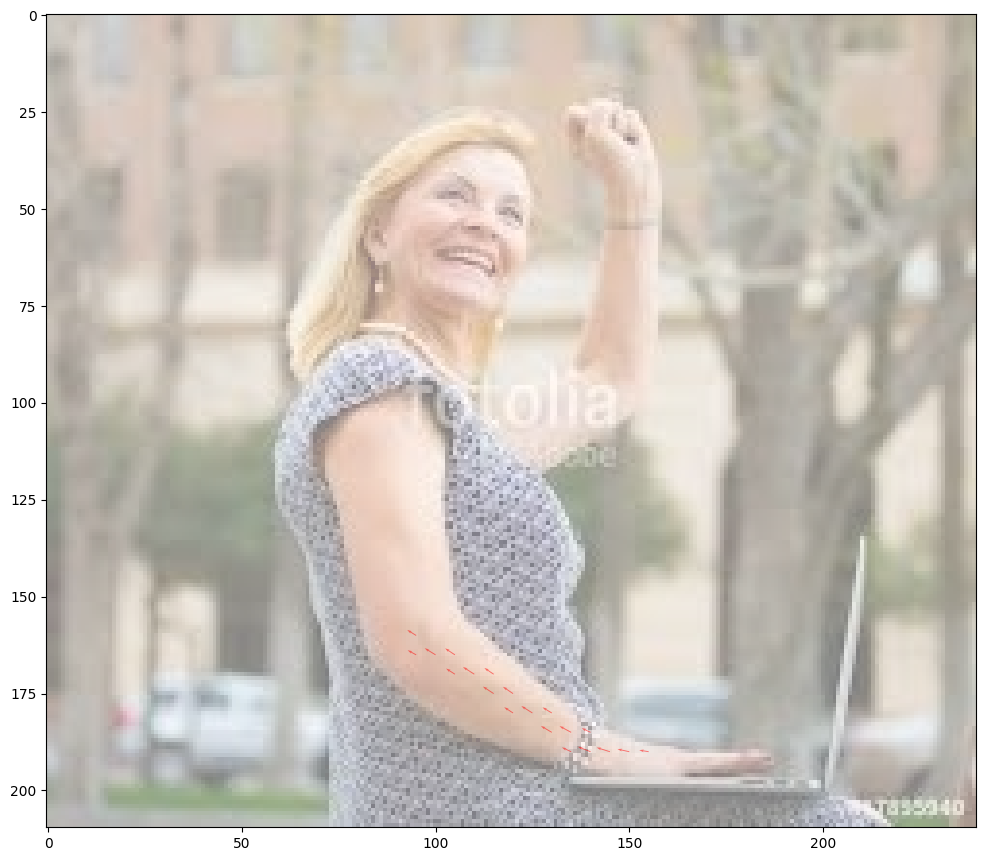

<Figure size 1200x1200 with 0 Axes>

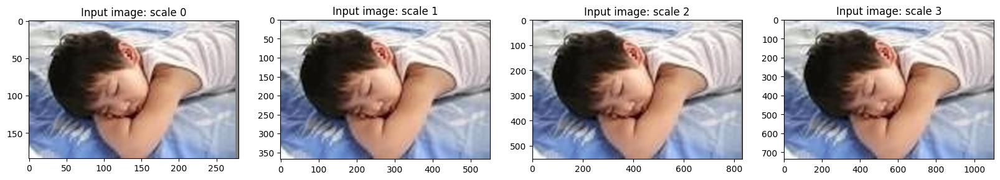

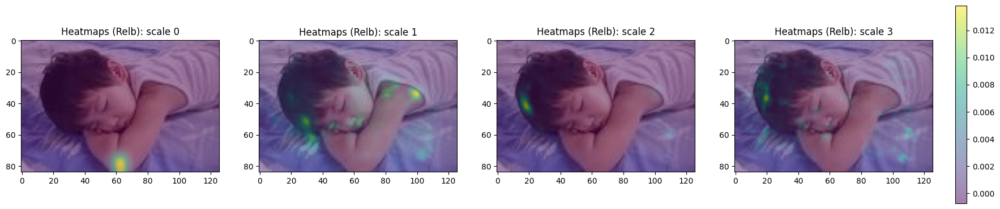

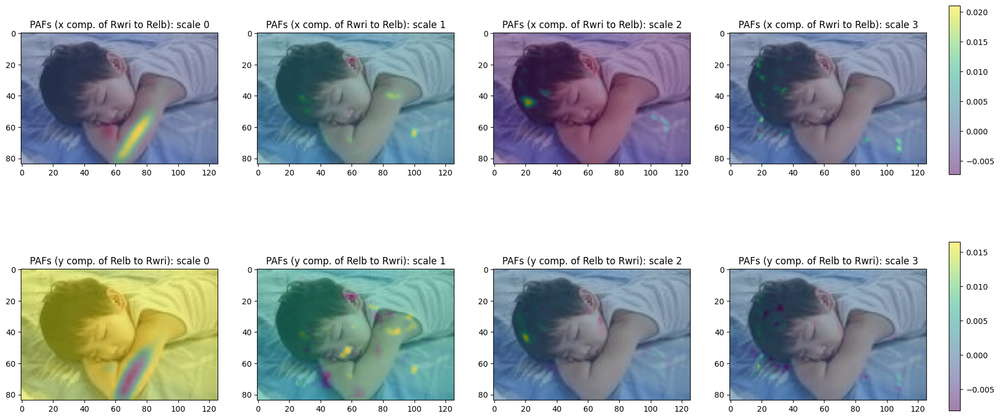

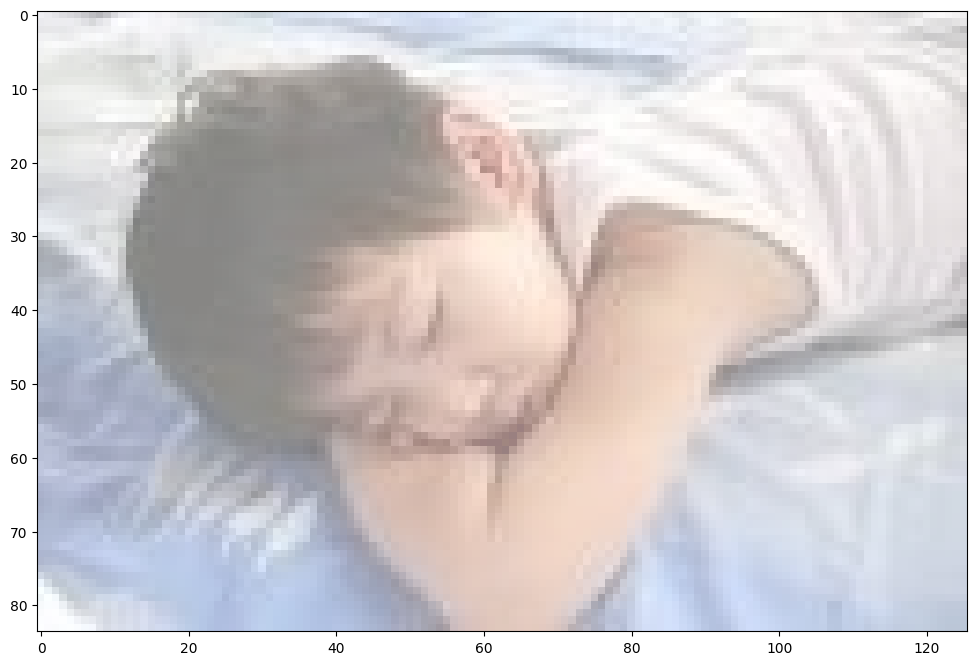

<Figure size 1200x1200 with 0 Axes>

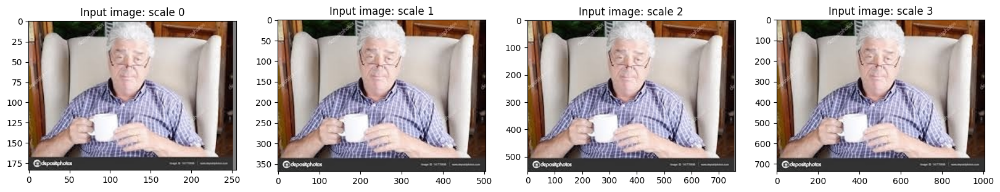

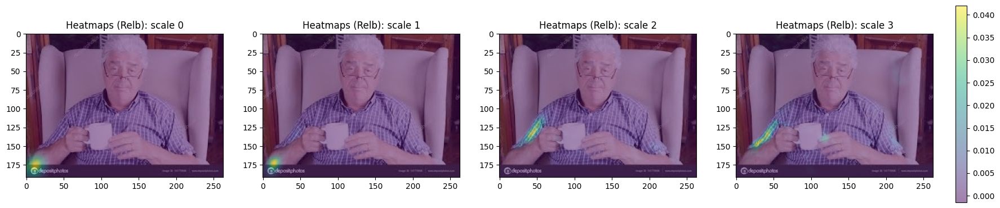

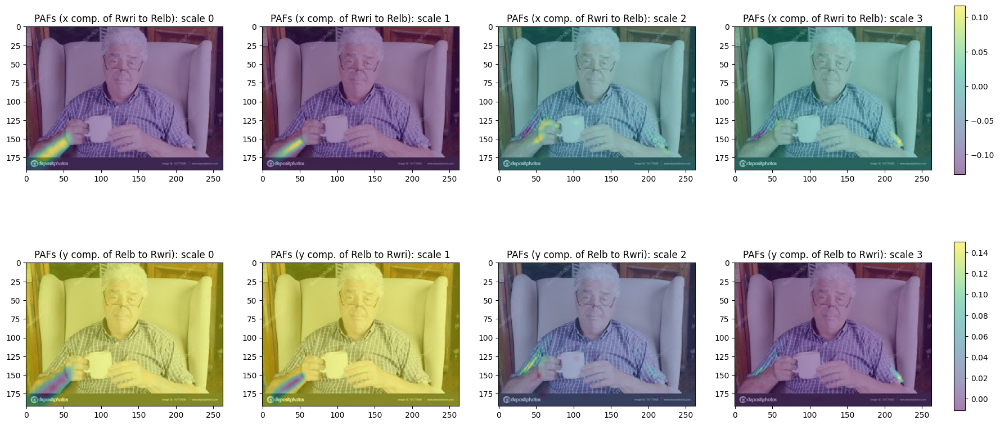

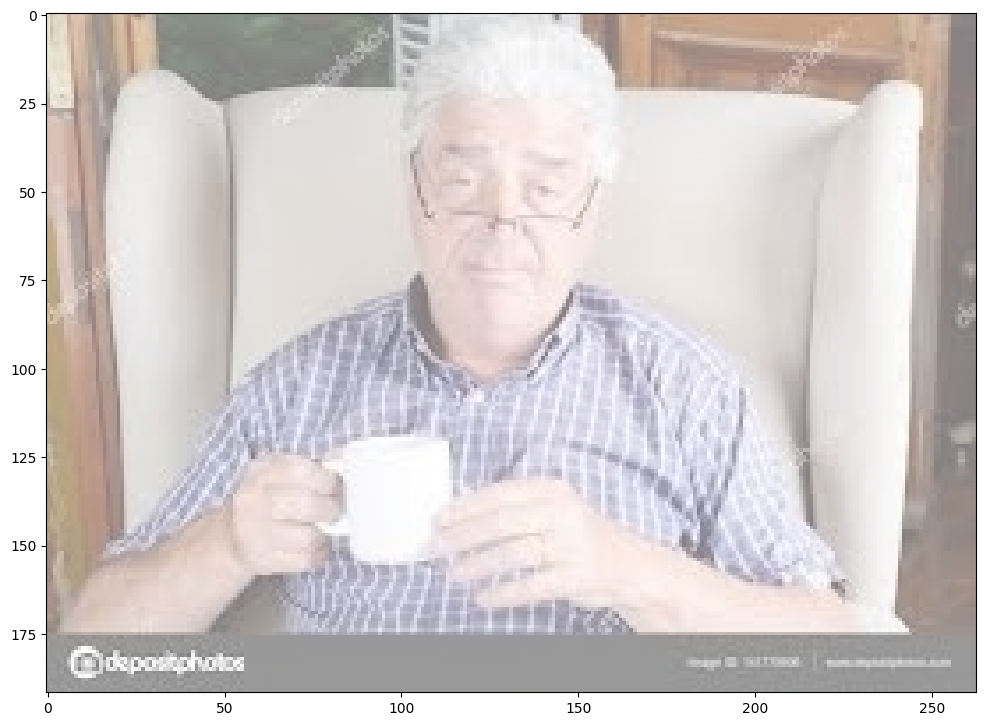

<Figure size 1200x1200 with 0 Axes>

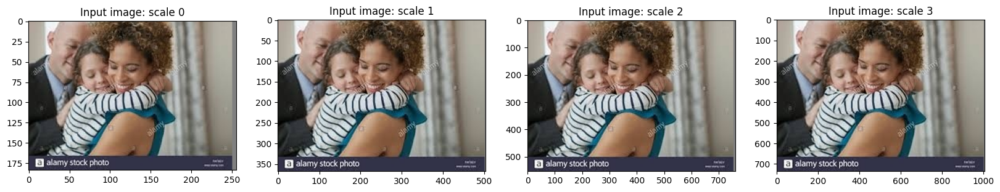

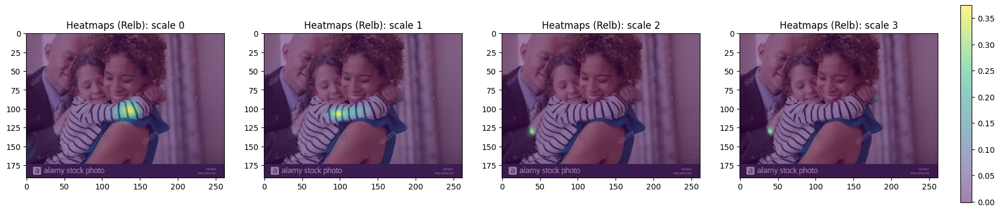

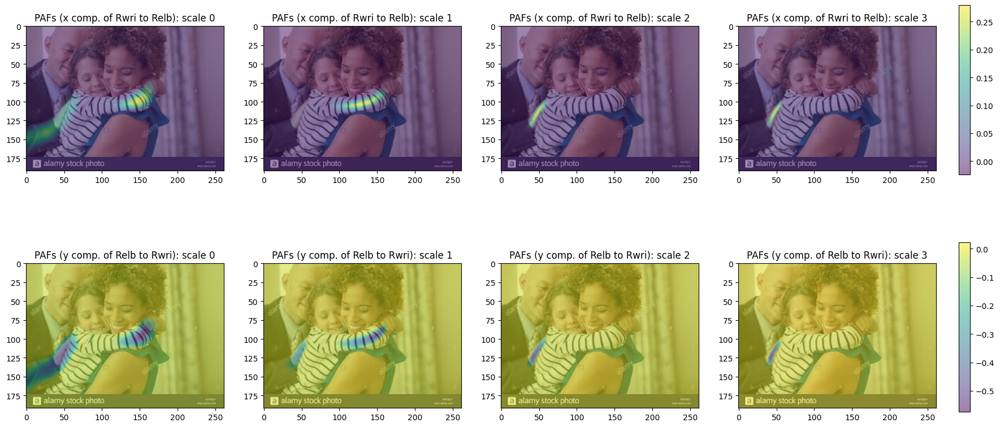

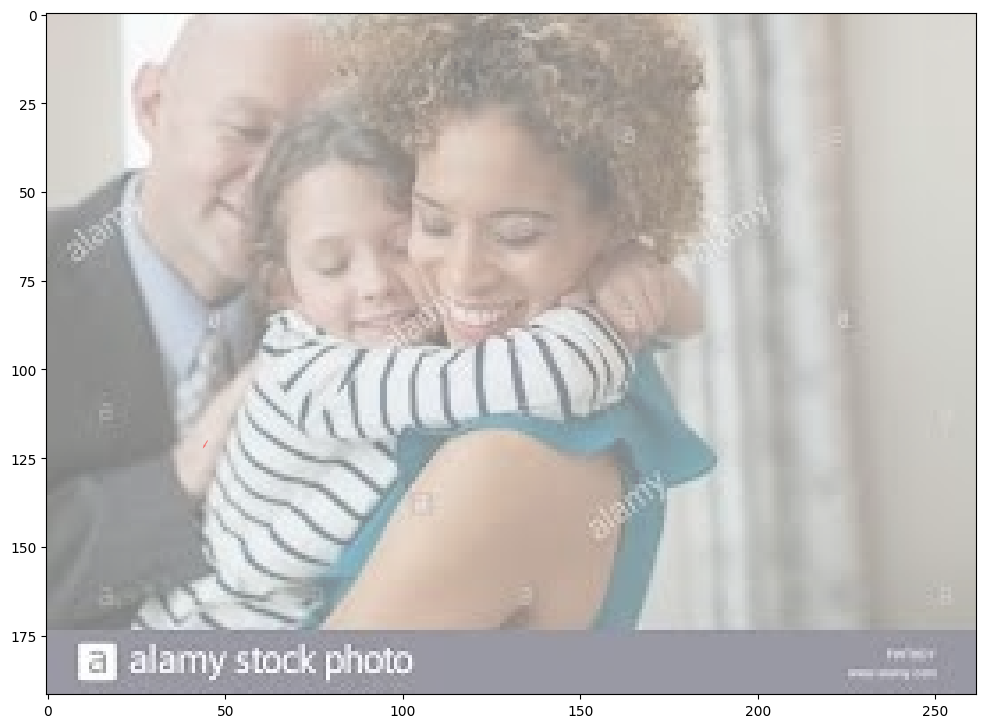

<Figure size 1200x1200 with 0 Axes>

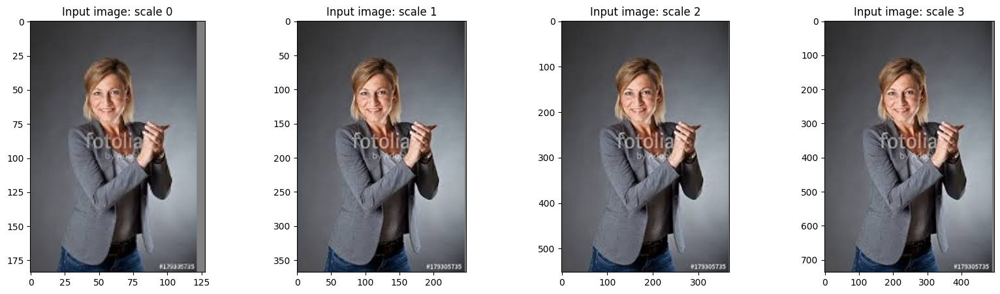

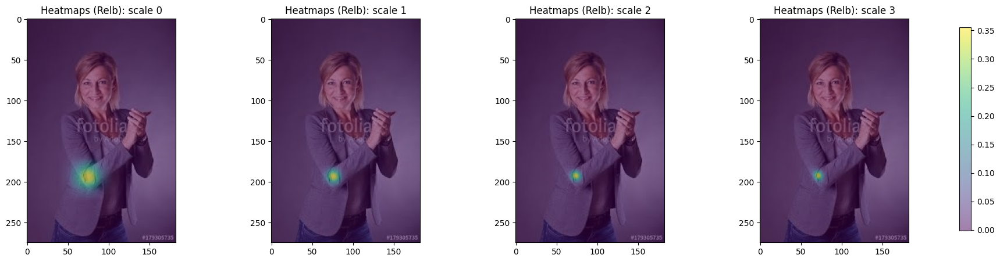

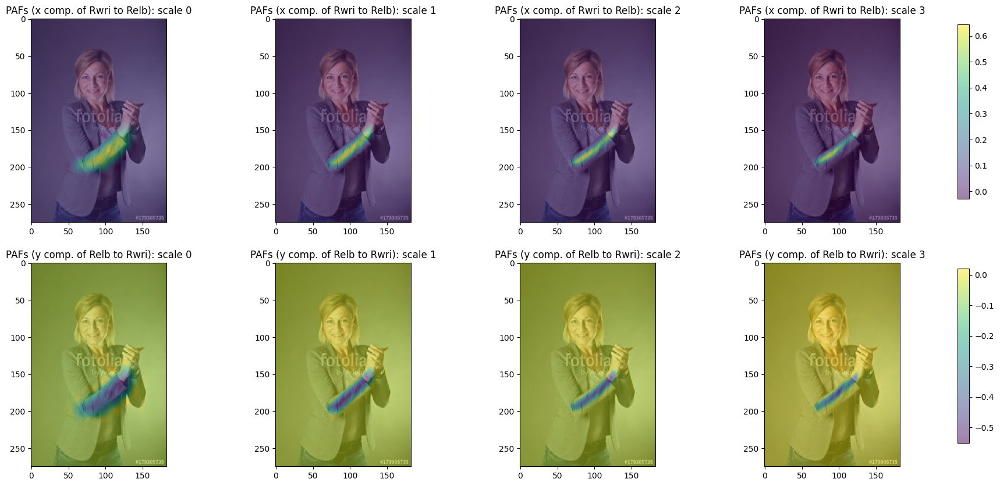

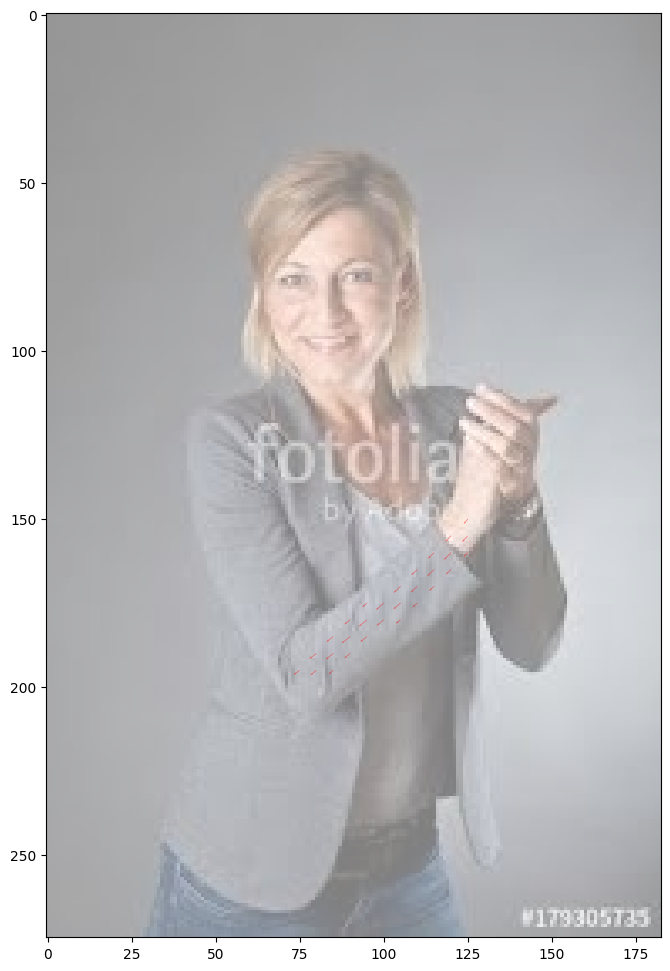

In [7]:
import os
from tqdm import tqdm

def create_folder(folder_path):
    # Check if the folder exists
    if not os.path.exists(folder_path):
        # Create the folder
        os.makedirs(folder_path)
        print(f"Folder '{folder_path}' created.")
    else:
        print(f"Folder '{folder_path}' already exists.")

# Test the function
folder_path = "./out"
create_folder(folder_path)

result = []
result_file = open('./result.txt', 'w')
for image_c in tqdm(range(1, 10)):
    try:
        test_image = 'image_2470/Image_' + str(image_c) + '.jpg'
        oriImg = cv2.imread(test_image) # B,G,R order
        plt.figure(figsize=(12,12))
        #plt.imshow(oriImg[:,:,[2,1,0]])
        param, model_params = config_reader()

        multiplier = [x * model_params['boxsize'] / oriImg.shape[0] for x in param['scale_search']]
        print ('scale factors for this image:', multiplier)


        heatmap_avg = np.zeros((oriImg.shape[0], oriImg.shape[1], 19))
        paf_avg = np.zeros((oriImg.shape[0], oriImg.shape[1], 38))


        # first figure shows padded images
        f, axarr = plt.subplots(1, len(multiplier))
        f.set_size_inches((20, 5))
        # second figure shows heatmaps
        f2, axarr2 = plt.subplots(1, len(multiplier))
        f2.set_size_inches((20, 5))
        # third figure shows PAFs
        f3, axarr3 = plt.subplots(2, len(multiplier))
        f3.set_size_inches((20, 10))


        for m in range(len(multiplier)):
            scale = multiplier[m]
            imageToTest = cv2.resize(oriImg, (0,0), fx=scale, fy=scale, interpolation=cv2.INTER_CUBIC)
            imageToTest_padded, pad = util.padRightDownCorner(imageToTest, model_params['stride'], model_params['padValue'])
            axarr[m].imshow(imageToTest_padded[:,:,[2,1,0]])
            axarr[m].set_title('Input image: scale %d' % m)

            input_img = np.transpose(np.float32(imageToTest_padded[:,:,:,np.newaxis]), (3,0,1,2)) # required shape (1, width, height, channels)
            print("Input shape: " + str(input_img.shape))

            output_blobs = model.predict(input_img)
            print("Output shape (heatmap): " + str(output_blobs[1].shape))

            # extract outputs, resize, and remove padding
            heatmap = np.squeeze(output_blobs[1]) # output 1 is heatmaps
            heatmap = cv2.resize(heatmap, (0,0), fx=model_params['stride'], fy=model_params['stride'], interpolation=cv2.INTER_CUBIC)
            heatmap = heatmap[:imageToTest_padded.shape[0]-pad[2], :imageToTest_padded.shape[1]-pad[3], :]
            heatmap = cv2.resize(heatmap, (oriImg.shape[1], oriImg.shape[0]), interpolation=cv2.INTER_CUBIC)

            paf = np.squeeze(output_blobs[0]) # output 0 is PAFs
            paf = cv2.resize(paf, (0,0), fx=model_params['stride'], fy=model_params['stride'], interpolation=cv2.INTER_CUBIC)
            paf = paf[:imageToTest_padded.shape[0]-pad[2], :imageToTest_padded.shape[1]-pad[3], :]
            paf = cv2.resize(paf, (oriImg.shape[1], oriImg.shape[0]), interpolation=cv2.INTER_CUBIC)

            # visualization
            axarr2[m].imshow(oriImg[:,:,[2,1,0]])
            ax2 = axarr2[m].imshow(heatmap[:,:,3], alpha=.5) # right elbow
            axarr2[m].set_title('Heatmaps (Relb): scale %d' % m)

            axarr3.flat[m].imshow(oriImg[:,:,[2,1,0]])
            ax3x = axarr3.flat[m].imshow(paf[:,:,16], alpha=.5) # right elbow
            axarr3.flat[m].set_title('PAFs (x comp. of Rwri to Relb): scale %d' % m)
            axarr3.flat[len(multiplier) + m].imshow(oriImg[:,:,[2,1,0]])
            ax3y = axarr3.flat[len(multiplier) + m].imshow(paf[:,:,17], alpha=.5) # right wrist
            axarr3.flat[len(multiplier) + m].set_title('PAFs (y comp. of Relb to Rwri): scale %d' % m)

            heatmap_avg = heatmap_avg + heatmap / len(multiplier)
            paf_avg = paf_avg + paf / len(multiplier)

        f2.subplots_adjust(right=0.93)
        cbar_ax = f2.add_axes([0.95, 0.15, 0.01, 0.7])
        _ = f2.colorbar(ax2, cax=cbar_ax)

        f3.subplots_adjust(right=0.93)
        cbar_axx = f3.add_axes([0.95, 0.57, 0.01, 0.3])
        _ = f3.colorbar(ax3x, cax=cbar_axx)
        cbar_axy = f3.add_axes([0.95, 0.15, 0.01, 0.3])
        _ = f3.colorbar(ax3y, cax=cbar_axy)

        from numpy import ma
        U = paf_avg[:,:,16] * -1
        V = paf_avg[:,:,17]
        X, Y = np.meshgrid(np.arange(U.shape[1]), np.arange(U.shape[0]))
        M = np.zeros(U.shape, dtype='bool')
        M[U**2 + V**2 < 0.5 * 0.5] = True
        U = ma.masked_array(U, mask=M)
        V = ma.masked_array(V, mask=M)

        # 1
        plt.figure()
        plt.imshow(oriImg[:,:,[2,1,0]], alpha = .5)
        s = 5
        Q = plt.quiver(X[::s,::s], Y[::s,::s], U[::s,::s], V[::s,::s],
                      scale=50, headaxislength=4, alpha=.5, width=0.001, color='r')

        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(12, 12)

        from scipy.ndimage.filters import gaussian_filter
        all_peaks = []
        peak_counter = 0

        for part in range(19-1):
            map_ori = heatmap_avg[:,:,part]
            map = gaussian_filter(map_ori, sigma=3)

            map_left = np.zeros(map.shape)
            map_left[1:,:] = map[:-1,:]
            map_right = np.zeros(map.shape)
            map_right[:-1,:] = map[1:,:]
            map_up = np.zeros(map.shape)
            map_up[:,1:] = map[:,:-1]
            map_down = np.zeros(map.shape)
            map_down[:,:-1] = map[:,1:]

            peaks_binary = np.logical_and.reduce((map>=map_left, map>=map_right, map>=map_up, map>=map_down, map > param['thre1']))
            peaks = list(zip(np.nonzero(peaks_binary)[1], np.nonzero(peaks_binary)[0])) # note reverse
            peaks_with_score = [x + (map_ori[x[1],x[0]],) for x in peaks]
            id = range(peak_counter, peak_counter + len(peaks))
            peaks_with_score_and_id = [peaks_with_score[i] + (id[i],) for i in range(len(id))]

            all_peaks.append(peaks_with_score_and_id)
            peak_counter += len(peaks)

        # visualize
        colors = [[255, 0, 0], [255, 85, 0], [255, 170, 0], [255, 255, 0], [170, 255, 0], [85, 255, 0], [0, 255, 0], \
                  [0, 255, 85], [0, 255, 170], [0, 255, 255], [0, 170, 255], [0, 85, 255], [0, 0, 255], [85, 0, 255], \
                  [170, 0, 255], [255, 0, 255], [255, 0, 170], [255, 0, 85]]
        cmap = matplotlib.cm.get_cmap('hsv')

        canvas = cv2.imread(test_image) # B,G,R order


        print("Printing keypoint")
        yes = []
        for i in range(18):
            if len(all_peaks[i]) > 0:
              yes.append(i)
        import random
        if yes:
            random_element = random.choice(yes)
            result.append(random_element)
            result_file.write(f"{random_element}\n")

            if True:
                #for i in range(18):
                i = random_element
                rgba = np.array(cmap(1 - i/18. - 1./36))
                rgba[0:3] *= 255
                print(len(all_peaks[i]))
                for j in range(len(all_peaks[i])):
                    #cv2.circle(canvas, all_peaks[i][j][0:2], 4, colors[i], thickness=-1)
                    cv2.circle(canvas, all_peaks[i][j][0:2], 4, colors[6], thickness=-1)

            to_plot = cv2.addWeighted(oriImg, 0.3, canvas, 0.7, 0)
            plt.imshow(to_plot[:,:,[2,1,0]])
            fig = matplotlib.pyplot.gcf()
            fig.set_size_inches(12, 12)

            fig.savefig("./out/image_" + str(image_c) + "_out.jpg")
    except:
        continue


result_file.close()

In [9]:
import os
from tqdm import tqdm

def create_folder(folder_path):
    # Check if the folder exists
    if not os.path.exists(folder_path):
        # Create the folder
        os.makedirs(folder_path)
        print(f"Folder '{folder_path}' created.")
    else:
        print(f"Folder '{folder_path}' already exists.")

# Test the function
folder_path = "./out"
create_folder(folder_path)

result = []
result_file = open('./result.txt', 'w')
for image_c in tqdm(range(1, 2501)):
    try:
        test_image = 'image_2470/Image_' + str(image_c) + '.jpg'
        oriImg = cv2.imread(test_image) # B,G,R order
        #plt.figure(figsize=(12,12))
        #plt.imshow(oriImg[:,:,[2,1,0]])
        param, model_params = config_reader()

        multiplier = [x * model_params['boxsize'] / oriImg.shape[0] for x in param['scale_search']]
        #print ('scale factors for this image:', multiplier)


        heatmap_avg = np.zeros((oriImg.shape[0], oriImg.shape[1], 19))
        paf_avg = np.zeros((oriImg.shape[0], oriImg.shape[1], 38))


        # first figure shows padded images
        #f, axarr = plt.subplots(1, len(multiplier))
        #f.set_size_inches((20, 5))
        # second figure shows heatmaps
        #f2, axarr2 = plt.subplots(1, len(multiplier))
        #f2.set_size_inches((20, 5))
        # third figure shows PAFs
        #f3, axarr3 = plt.subplots(2, len(multiplier))
        #f3.set_size_inches((20, 10))


        for m in range(len(multiplier)):
            scale = multiplier[m]
            imageToTest = cv2.resize(oriImg, (0,0), fx=scale, fy=scale, interpolation=cv2.INTER_CUBIC)
            imageToTest_padded, pad = util.padRightDownCorner(imageToTest, model_params['stride'], model_params['padValue'])
            #axarr[m].imshow(imageToTest_padded[:,:,[2,1,0]])
            #axarr[m].set_title('Input image: scale %d' % m)

            input_img = np.transpose(np.float32(imageToTest_padded[:,:,:,np.newaxis]), (3,0,1,2)) # required shape (1, width, height, channels)
            #print("Input shape: " + str(input_img.shape))

            output_blobs = model.predict(input_img)
            #print("Output shape (heatmap): " + str(output_blobs[1].shape))

            # extract outputs, resize, and remove padding
            heatmap = np.squeeze(output_blobs[1]) # output 1 is heatmaps
            heatmap = cv2.resize(heatmap, (0,0), fx=model_params['stride'], fy=model_params['stride'], interpolation=cv2.INTER_CUBIC)
            heatmap = heatmap[:imageToTest_padded.shape[0]-pad[2], :imageToTest_padded.shape[1]-pad[3], :]
            heatmap = cv2.resize(heatmap, (oriImg.shape[1], oriImg.shape[0]), interpolation=cv2.INTER_CUBIC)

            paf = np.squeeze(output_blobs[0]) # output 0 is PAFs
            paf = cv2.resize(paf, (0,0), fx=model_params['stride'], fy=model_params['stride'], interpolation=cv2.INTER_CUBIC)
            paf = paf[:imageToTest_padded.shape[0]-pad[2], :imageToTest_padded.shape[1]-pad[3], :]
            paf = cv2.resize(paf, (oriImg.shape[1], oriImg.shape[0]), interpolation=cv2.INTER_CUBIC)

            # visualization
            #axarr2[m].imshow(oriImg[:,:,[2,1,0]])
            #ax2 = axarr2[m].imshow(heatmap[:,:,3], alpha=.5) # right elbow
            #axarr2[m].set_title('Heatmaps (Relb): scale %d' % m)

            #axarr3.flat[m].imshow(oriImg[:,:,[2,1,0]])
            #ax3x = axarr3.flat[m].imshow(paf[:,:,16], alpha=.5) # right elbow
            #axarr3.flat[m].set_title('PAFs (x comp. of Rwri to Relb): scale %d' % m)
            #axarr3.flat[len(multiplier) + m].imshow(oriImg[:,:,[2,1,0]])
            #ax3y = axarr3.flat[len(multiplier) + m].imshow(paf[:,:,17], alpha=.5) # right wrist
            #axarr3.flat[len(multiplier) + m].set_title('PAFs (y comp. of Relb to Rwri): scale %d' % m)

            heatmap_avg = heatmap_avg + heatmap / len(multiplier)
            paf_avg = paf_avg + paf / len(multiplier)

        #f2.subplots_adjust(right=0.93)
        #cbar_ax = f2.add_axes([0.95, 0.15, 0.01, 0.7])
        #_ = f2.colorbar(ax2, cax=cbar_ax)

        #f3.subplots_adjust(right=0.93)
        #cbar_axx = f3.add_axes([0.95, 0.57, 0.01, 0.3])
        #_ = f3.colorbar(ax3x, cax=cbar_axx)
        #cbar_axy = f3.add_axes([0.95, 0.15, 0.01, 0.3])
        #_ = f3.colorbar(ax3y, cax=cbar_axy)

        from numpy import ma
        U = paf_avg[:,:,16] * -1
        V = paf_avg[:,:,17]
        X, Y = np.meshgrid(np.arange(U.shape[1]), np.arange(U.shape[0]))
        M = np.zeros(U.shape, dtype='bool')
        M[U**2 + V**2 < 0.5 * 0.5] = True
        U = ma.masked_array(U, mask=M)
        V = ma.masked_array(V, mask=M)

        # 1
        #plt.figure()
        #plt.imshow(oriImg[:,:,[2,1,0]], alpha = .5)
        #s = 5
        #Q = plt.quiver(X[::s,::s], Y[::s,::s], U[::s,::s], V[::s,::s],
        #              scale=50, headaxislength=4, alpha=.5, width=0.001, color='r')

        #fig = matplotlib.pyplot.gcf()
        #fig.set_size_inches(12, 12)

        from scipy.ndimage.filters import gaussian_filter
        all_peaks = []
        peak_counter = 0

        for part in range(19-1):
            map_ori = heatmap_avg[:,:,part]
            map = gaussian_filter(map_ori, sigma=3)

            map_left = np.zeros(map.shape)
            map_left[1:,:] = map[:-1,:]
            map_right = np.zeros(map.shape)
            map_right[:-1,:] = map[1:,:]
            map_up = np.zeros(map.shape)
            map_up[:,1:] = map[:,:-1]
            map_down = np.zeros(map.shape)
            map_down[:,:-1] = map[:,1:]

            peaks_binary = np.logical_and.reduce((map>=map_left, map>=map_right, map>=map_up, map>=map_down, map > param['thre1']))
            peaks = list(zip(np.nonzero(peaks_binary)[1], np.nonzero(peaks_binary)[0])) # note reverse
            peaks_with_score = [x + (map_ori[x[1],x[0]],) for x in peaks]
            id = range(peak_counter, peak_counter + len(peaks))
            peaks_with_score_and_id = [peaks_with_score[i] + (id[i],) for i in range(len(id))]

            all_peaks.append(peaks_with_score_and_id)
            peak_counter += len(peaks)

        # visualize
        colors = [[255, 0, 0], [255, 85, 0], [255, 170, 0], [255, 255, 0], [170, 255, 0], [85, 255, 0], [0, 255, 0], \
                  [0, 255, 85], [0, 255, 170], [0, 255, 255], [0, 170, 255], [0, 85, 255], [0, 0, 255], [85, 0, 255], \
                  [170, 0, 255], [255, 0, 255], [255, 0, 170], [255, 0, 85]]
        cmap = matplotlib.cm.get_cmap('hsv')

        canvas = cv2.imread(test_image) # B,G,R order

        #print("Printing keypoint")
        yes = []
        for i in range(18):
            if len(all_peaks[i]) > 0:
              yes.append(i)
        import random
        if yes:
            random_element = random.choice(yes)
            result.append(random_element)
            result_file.write(f"{random_element}\n")

            #for i in range(18):
            i = random_element
            rgba = np.array(cmap(1 - i/18. - 1./36))
            rgba[0:3] *= 255
            print(len(all_peaks[i]))
            for j in range(len(all_peaks[i])):
                #cv2.circle(canvas, all_peaks[i][j][0:2], 4, colors[i], thickness=-1)
                cv2.circle(canvas, all_peaks[i][j][0:2], 4, colors[6], thickness=-1)

            #to_plot = cv2.addWeighted(oriImg, 0.3, canvas, 0.7, 0)
            #plt.imshow(to_plot[:,:,[2,1,0]])
            #fig = matplotlib.pyplot.gcf()
            #fig.set_size_inches(12, 12)

            fig = cv2.addWeighted(oriImg, 0.3, canvas, 0.7, 0)
            cv2.imwrite("./out/image_" + str(image_c) + "_out.jpg", fig)

    except:
        continue

result_file.close()

Folder './out' already exists.


  0%|          | 0/2500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 27ms/step


<ipython-input-9-21720e5f9bd6>:114: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter
<ipython-input-9-21720e5f9bd6>:144: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = matplotlib.cm.get_cmap('hsv')
  0%|          | 1/2500 [00:01<56:10,  1.35s/it]

1
1/1 [==============================] - 0s 30ms/step


  0%|          | 2/2500 [00:02<54:21,  1.31s/it]

1
1/1 [==============================] - 0s 27ms/step


  0%|          | 3/2500 [00:03<54:10,  1.30s/it]

2
1/1 [==============================] - 0s 24ms/step


  0%|          | 4/2500 [00:05<55:16,  1.33s/it]

1
1/1 [==============================] - 0s 24ms/step


  0%|          | 5/2500 [00:06<51:32,  1.24s/it]

1
1/1 [==============================] - 0s 32ms/step


  0%|          | 6/2500 [00:07<50:31,  1.22s/it]

1
1/1 [==============================] - 0s 38ms/step


  0%|          | 7/2500 [00:09<58:07,  1.40s/it]

1
1/1 [==============================] - 0s 41ms/step


  0%|          | 8/2500 [00:11<1:02:39,  1.51s/it]

2
1/1 [==============================] - 0s 32ms/step


  0%|          | 9/2500 [00:12<58:51,  1.42s/it]  

1
1/1 [==============================] - 7s 7s/step


  0%|          | 10/2500 [00:28<4:07:47,  5.97s/it]

2
1/1 [==============================] - 0s 25ms/step


  0%|          | 11/2500 [00:29<3:09:22,  4.57s/it]

1
1/1 [==============================] - 4s 4s/step


  0%|          | 12/2500 [00:43<5:04:57,  7.35s/it]

1
1/1 [==============================] - 4s 4s/step


  1%|          | 13/2500 [00:50<4:59:16,  7.22s/it]

1
1/1 [==============================] - 5s 5s/step


  1%|          | 14/2500 [01:03<6:07:27,  8.87s/it]

1
1/1 [==============================] - 6s 6s/step


  1%|          | 15/2500 [01:17<7:11:20, 10.41s/it]

1
1/1 [==============================] - 0s 27ms/step


  1%|          | 16/2500 [01:18<5:22:09,  7.78s/it]

1
1/1 [==============================] - 7s 7s/step


  1%|          | 17/2500 [01:35<7:07:08, 10.32s/it]

1
1/1 [==============================] - 0s 25ms/step


  1%|          | 18/2500 [01:39<5:58:51,  8.67s/it]

1
1/1 [==============================] - 5s 5s/step


  1%|          | 19/2500 [01:56<7:31:29, 10.92s/it]

1
1/1 [==============================] - 0s 41ms/step


  1%|          | 20/2500 [01:57<5:38:52,  8.20s/it]

1
1/1 [==============================] - 0s 26ms/step


  1%|          | 21/2500 [01:59<4:13:22,  6.13s/it]

5
1/1 [==============================] - 6s 6s/step


  1%|          | 22/2500 [02:14<6:01:50,  8.76s/it]

5
1/1 [==============================] - 0s 24ms/step


  1%|          | 23/2500 [02:15<4:28:35,  6.51s/it]

1
1/1 [==============================] - 0s 33ms/step


  1%|          | 24/2500 [02:16<3:21:25,  4.88s/it]

1
1/1 [==============================] - 4s 4s/step


  1%|          | 25/2500 [02:26<4:28:10,  6.50s/it]

1
1/1 [==============================] - 0s 25ms/step


  1%|          | 26/2500 [02:28<3:26:59,  5.02s/it]

1
1/1 [==============================] - 0s 25ms/step


  1%|          | 27/2500 [02:29<2:43:37,  3.97s/it]

2
1/1 [==============================] - 3s 3s/step


  1%|          | 28/2500 [02:41<4:18:27,  6.27s/it]

1
1/1 [==============================] - 3s 3s/step


  1%|          | 29/2500 [02:50<4:57:08,  7.22s/it]

1
1/1 [==============================] - 2s 2s/step


  1%|          | 30/2500 [02:58<5:04:14,  7.39s/it]

1
1/1 [==============================] - 3s 3s/step


  1%|          | 31/2500 [03:08<5:37:47,  8.21s/it]

1
1/1 [==============================] - 0s 23ms/step


  1%|▏         | 32/2500 [03:09<4:09:10,  6.06s/it]

2
1/1 [==============================] - 0s 25ms/step


  1%|▏         | 33/2500 [03:11<3:10:13,  4.63s/it]

1
1/1 [==============================] - 5s 5s/step


  1%|▏         | 34/2500 [03:24<4:54:04,  7.16s/it]

1
1/1 [==============================] - 6s 6s/step


  1%|▏         | 35/2500 [03:34<5:32:51,  8.10s/it]

3
1/1 [==============================] - 0s 28ms/step


  1%|▏         | 36/2500 [03:35<4:08:13,  6.04s/it]

2
1/1 [==============================] - 3s 3s/step


  1%|▏         | 37/2500 [03:44<4:44:44,  6.94s/it]

1
1/1 [==============================] - 6s 6s/step


  2%|▏         | 38/2500 [03:57<5:56:15,  8.68s/it]

6
1/1 [==============================] - 0s 25ms/step


  2%|▏         | 39/2500 [03:58<4:24:41,  6.45s/it]

1
1/1 [==============================] - 0s 23ms/step


  2%|▏         | 40/2500 [04:01<3:40:27,  5.38s/it]

2
1/1 [==============================] - 7s 7s/step


  2%|▏         | 41/2500 [04:21<6:37:09,  9.69s/it]

2
1/1 [==============================] - 5s 5s/step


  2%|▏         | 42/2500 [04:34<7:14:01, 10.59s/it]

1
1/1 [==============================] - 0s 28ms/step


  2%|▏         | 43/2500 [04:35<5:22:10,  7.87s/it]

2
1/1 [==============================] - 6s 6s/step


  2%|▏         | 44/2500 [04:50<6:49:28, 10.00s/it]

1
1/1 [==============================] - 0s 28ms/step


  2%|▏         | 45/2500 [04:51<5:01:54,  7.38s/it]

1
1/1 [==============================] - 0s 25ms/step


  2%|▏         | 46/2500 [04:53<3:47:04,  5.55s/it]

1
1/1 [==============================] - 0s 41ms/step


  2%|▏         | 47/2500 [04:54<2:50:09,  4.16s/it]

1
1/1 [==============================] - 0s 37ms/step


  2%|▏         | 48/2500 [04:55<2:12:56,  3.25s/it]

1
1/1 [==============================] - 0s 39ms/step


  2%|▏         | 49/2500 [04:56<1:55:10,  2.82s/it]

1
1/1 [==============================] - 6s 6s/step


  2%|▏         | 50/2500 [05:10<4:04:18,  5.98s/it]

1
1/1 [==============================] - 0s 29ms/step


  2%|▏         | 51/2500 [05:11<3:06:27,  4.57s/it]

2
1/1 [==============================] - 0s 40ms/step


  2%|▏         | 52/2500 [05:13<2:33:20,  3.76s/it]

1
1/1 [==============================] - 6s 6s/step


  2%|▏         | 53/2500 [05:20<3:17:23,  4.84s/it]

1
1/1 [==============================] - 0s 26ms/step


  2%|▏         | 54/2500 [05:22<2:35:33,  3.82s/it]

1/1 [==============================] - 6s 6s/step


  2%|▏         | 55/2500 [05:36<4:43:59,  6.97s/it]

2
1/1 [==============================] - 0s 25ms/step


  2%|▏         | 56/2500 [05:37<3:35:14,  5.28s/it]

2
1/1 [==============================] - 0s 25ms/step


  2%|▏         | 57/2500 [05:39<2:45:56,  4.08s/it]

1
1/1 [==============================] - 0s 26ms/step


  2%|▏         | 58/2500 [05:40<2:14:44,  3.31s/it]

1
1/1 [==============================] - 0s 25ms/step


  2%|▏         | 59/2500 [05:41<1:49:59,  2.70s/it]

1
1/1 [==============================] - 0s 27ms/step


  2%|▏         | 60/2500 [05:43<1:31:49,  2.26s/it]

1
1/1 [==============================] - 0s 41ms/step


  2%|▏         | 61/2500 [05:44<1:21:55,  2.02s/it]

1/1 [==============================] - 0s 40ms/step


  2%|▏         | 62/2500 [05:46<1:20:32,  1.98s/it]

1
1/1 [==============================] - 0s 36ms/step


  3%|▎         | 63/2500 [05:47<1:10:51,  1.74s/it]

1
1/1 [==============================] - 0s 35ms/step


  3%|▎         | 64/2500 [05:49<1:07:42,  1.67s/it]

1
1/1 [==============================] - 5s 5s/step


  3%|▎         | 65/2500 [06:06<4:11:27,  6.20s/it]

1
1/1 [==============================] - 0s 28ms/step


  3%|▎         | 66/2500 [06:07<3:11:47,  4.73s/it]

1
1/1 [==============================] - 3s 3s/step


  3%|▎         | 67/2500 [06:13<3:24:41,  5.05s/it]

2
1/1 [==============================] - 0s 26ms/step


  3%|▎         | 68/2500 [06:14<2:41:31,  3.98s/it]

3
1/1 [==============================] - 0s 23ms/step


  3%|▎         | 69/2500 [06:15<2:03:47,  3.06s/it]

1
1/1 [==============================] - 0s 26ms/step


  3%|▎         | 70/2500 [06:16<1:44:16,  2.57s/it]

1
1/1 [==============================] - 0s 28ms/step


  3%|▎         | 71/2500 [06:18<1:32:03,  2.27s/it]

5
1/1 [==============================] - 0s 23ms/step


  3%|▎         | 72/2500 [06:19<1:15:56,  1.88s/it]

2
1/1 [==============================] - 0s 36ms/step


  3%|▎         | 73/2500 [06:20<1:10:54,  1.75s/it]

3
1/1 [==============================] - 4s 4s/step


  3%|▎         | 74/2500 [06:25<1:44:10,  2.58s/it]

1
1/1 [==============================] - 5s 5s/step


  3%|▎         | 75/2500 [06:38<3:46:14,  5.60s/it]

1
1/1 [==============================] - 5s 5s/step


  3%|▎         | 76/2500 [06:51<5:19:08,  7.90s/it]

2
1/1 [==============================] - 0s 27ms/step


  3%|▎         | 77/2500 [06:52<3:58:54,  5.92s/it]

1
1/1 [==============================] - 3s 3s/step


  3%|▎         | 78/2500 [07:01<4:34:24,  6.80s/it]

3
1/1 [==============================] - 0s 27ms/step


  3%|▎         | 79/2500 [07:02<3:29:29,  5.19s/it]

1
1/1 [==============================] - 0s 32ms/step


  3%|▎         | 80/2500 [07:04<2:43:49,  4.06s/it]

1
1/1 [==============================] - 0s 29ms/step


  3%|▎         | 81/2500 [07:05<2:14:17,  3.33s/it]

6
1/1 [==============================] - 0s 25ms/step


  3%|▎         | 82/2500 [07:07<1:48:53,  2.70s/it]

1
1/1 [==============================] - 5s 5s/step


  3%|▎         | 83/2500 [07:21<4:09:58,  6.21s/it]

1
1/1 [==============================] - 5s 5s/step


  3%|▎         | 84/2500 [07:35<5:38:19,  8.40s/it]

1
1/1 [==============================] - 0s 25ms/step


  3%|▎         | 85/2500 [07:36<4:11:58,  6.26s/it]

4
1/1 [==============================] - 0s 34ms/step


  3%|▎         | 86/2500 [07:38<3:19:01,  4.95s/it]

1
1/1 [==============================] - 0s 26ms/step


  3%|▎         | 87/2500 [07:39<2:37:03,  3.91s/it]

1
1/1 [==============================] - 0s 25ms/step


  4%|▎         | 88/2500 [07:41<2:06:02,  3.14s/it]

1
1/1 [==============================] - 0s 29ms/step


  4%|▎         | 89/2500 [07:42<1:44:27,  2.60s/it]

1
1/1 [==============================] - 0s 40ms/step


  4%|▎         | 90/2500 [07:44<1:36:19,  2.40s/it]

1
1/1 [==============================] - 7s 7s/step


  4%|▎         | 91/2500 [08:02<4:41:26,  7.01s/it]

4
1/1 [==============================] - 0s 32ms/step


  4%|▎         | 92/2500 [08:03<3:38:37,  5.45s/it]

2
1/1 [==============================] - 10s 10s/step


  4%|▎         | 93/2500 [08:28<7:31:15, 11.25s/it]

1
1/1 [==============================] - 0s 31ms/step


  4%|▍         | 94/2500 [08:30<5:33:08,  8.31s/it]

1
1/1 [==============================] - 5s 5s/step


  4%|▍         | 95/2500 [08:42<6:23:17,  9.56s/it]

2
1/1 [==============================] - 0s 37ms/step


  4%|▍         | 96/2500 [08:44<4:47:53,  7.19s/it]

1
1/1 [==============================] - 0s 25ms/step


  4%|▍         | 97/2500 [08:45<3:39:28,  5.48s/it]

1
1/1 [==============================] - 0s 27ms/step


  4%|▍         | 98/2500 [08:47<2:48:49,  4.22s/it]

1
1/1 [==============================] - 0s 41ms/step


  4%|▍         | 99/2500 [08:48<2:10:41,  3.27s/it]

1
1/1 [==============================] - 6s 6s/step


  4%|▍         | 100/2500 [08:59<3:51:51,  5.80s/it]

1
1/1 [==============================] - 0s 26ms/step


  4%|▍         | 101/2500 [09:00<2:52:10,  4.31s/it]

2
1/1 [==============================] - 0s 26ms/step


  4%|▍         | 102/2500 [09:01<2:10:28,  3.26s/it]

1
1/1 [==============================] - 0s 25ms/step


  4%|▍         | 103/2500 [09:02<1:46:05,  2.66s/it]

1
1/1 [==============================] - 0s 25ms/step


  4%|▍         | 104/2500 [09:03<1:29:37,  2.24s/it]

4
1/1 [==============================] - 5s 5s/step


  4%|▍         | 105/2500 [09:17<3:41:17,  5.54s/it]

1
1/1 [==============================] - 3s 3s/step


  4%|▍         | 106/2500 [09:22<3:43:35,  5.60s/it]

1
1/1 [==============================] - 0s 36ms/step


  4%|▍         | 107/2500 [09:24<2:53:44,  4.36s/it]

2
1/1 [==============================] - 7s 7s/step


  4%|▍         | 108/2500 [09:43<5:47:54,  8.73s/it]

1
1/1 [==============================] - 7s 7s/step


  4%|▍         | 109/2500 [10:02<7:54:46, 11.91s/it]

1
1/1 [==============================] - 6s 6s/step


  4%|▍         | 110/2500 [10:10<7:05:03, 10.67s/it]

1
1/1 [==============================] - 0s 26ms/step


  4%|▍         | 111/2500 [10:11<5:15:11,  7.92s/it]

3
1/1 [==============================] - 0s 25ms/step


  4%|▍         | 112/2500 [10:13<3:55:54,  5.93s/it]

1
1/1 [==============================] - 0s 25ms/step


  5%|▍         | 113/2500 [10:14<3:03:29,  4.61s/it]

1
1/1 [==============================] - 0s 25ms/step


  5%|▍         | 114/2500 [10:16<2:23:50,  3.62s/it]

4
1/1 [==============================] - 0s 22ms/step


  5%|▍         | 115/2500 [10:17<1:52:12,  2.82s/it]

2
1/1 [==============================] - 0s 35ms/step


  5%|▍         | 116/2500 [10:18<1:38:15,  2.47s/it]

2
1/1 [==============================] - 0s 24ms/step


  5%|▍         | 117/2500 [10:20<1:24:23,  2.12s/it]

1
1/1 [==============================] - 4s 4s/step


  5%|▍         | 118/2500 [10:30<3:03:01,  4.61s/it]

1
1/1 [==============================] - 5s 5s/step


  5%|▍         | 119/2500 [10:39<4:01:54,  6.10s/it]

1
1/1 [==============================] - 0s 43ms/step


  5%|▍         | 120/2500 [10:41<3:09:46,  4.78s/it]

1
1/1 [==============================] - 0s 26ms/step


  5%|▍         | 121/2500 [10:43<2:33:14,  3.86s/it]

1
1/1 [==============================] - 0s 26ms/step


  5%|▍         | 122/2500 [10:44<2:02:20,  3.09s/it]

1
1/1 [==============================] - 0s 27ms/step


  5%|▍         | 123/2500 [10:46<1:42:05,  2.58s/it]

1
1/1 [==============================] - 0s 27ms/step


  5%|▍         | 124/2500 [10:47<1:26:17,  2.18s/it]

1
1/1 [==============================] - 6s 6s/step


  5%|▌         | 125/2500 [11:02<3:56:38,  5.98s/it]

3
1/1 [==============================] - 0s 28ms/step


  5%|▌         | 126/2500 [11:03<3:01:28,  4.59s/it]

1
1/1 [==============================] - 0s 39ms/step


  5%|▌         | 127/2500 [11:05<2:26:07,  3.69s/it]

5
1/1 [==============================] - 9s 9s/step


  5%|▌         | 128/2500 [11:30<6:39:10, 10.10s/it]

2
1/1 [==============================] - 0s 25ms/step


  5%|▌         | 129/2500 [11:31<4:56:31,  7.50s/it]

2
1/1 [==============================] - 0s 24ms/step


  5%|▌         | 130/2500 [11:32<3:42:49,  5.64s/it]

2
1/1 [==============================] - 4s 4s/step


  5%|▌         | 131/2500 [11:43<4:43:56,  7.19s/it]

2
1/1 [==============================] - 3s 3s/step


  5%|▌         | 132/2500 [11:54<5:23:29,  8.20s/it]

1
1/1 [==============================] - 0s 26ms/step


  5%|▌         | 133/2500 [11:55<4:04:21,  6.19s/it]

1
1/1 [==============================] - 3s 3s/step


  5%|▌         | 134/2500 [12:06<4:53:43,  7.45s/it]

1
1/1 [==============================] - 0s 22ms/step


  5%|▌         | 135/2500 [12:07<3:36:36,  5.50s/it]

1
1/1 [==============================] - 0s 30ms/step


  5%|▌         | 136/2500 [12:08<2:46:41,  4.23s/it]

5
1/1 [==============================] - 0s 23ms/step


  5%|▌         | 137/2500 [12:09<2:06:44,  3.22s/it]

2
1/1 [==============================] - 0s 27ms/step


  6%|▌         | 138/2500 [12:10<1:43:43,  2.63s/it]

1
1/1 [==============================] - 0s 25ms/step


  6%|▌         | 139/2500 [12:11<1:27:16,  2.22s/it]

2
1/1 [==============================] - 0s 26ms/step


  6%|▌         | 140/2500 [12:12<1:15:03,  1.91s/it]

5
1/1 [==============================] - 0s 25ms/step


  6%|▌         | 141/2500 [12:14<1:11:02,  1.81s/it]

2
1/1 [==============================] - 0s 37ms/step


  6%|▌         | 142/2500 [12:15<1:02:22,  1.59s/it]

1
1/1 [==============================] - 0s 24ms/step


  6%|▌         | 143/2500 [12:16<54:22,  1.38s/it]  

3
1/1 [==============================] - 4s 4s/step


  6%|▌         | 144/2500 [12:27<2:44:39,  4.19s/it]

1
1/1 [==============================] - 0s 29ms/step


  6%|▌         | 145/2500 [12:28<2:12:17,  3.37s/it]

3
1/1 [==============================] - 0s 29ms/step


  6%|▌         | 146/2500 [12:30<1:49:57,  2.80s/it]

4
1/1 [==============================] - 0s 25ms/step


  6%|▌         | 147/2500 [12:31<1:31:54,  2.34s/it]

1
1/1 [==============================] - 7s 7s/step


  6%|▌         | 148/2500 [12:47<4:12:38,  6.44s/it]

2
1/1 [==============================] - 0s 30ms/step


  6%|▌         | 149/2500 [12:48<3:11:32,  4.89s/it]

9
1/1 [==============================] - 0s 35ms/step


  6%|▌         | 150/2500 [12:50<2:33:47,  3.93s/it]

1
1/1 [==============================] - 0s 25ms/step


  6%|▌         | 151/2500 [12:51<1:59:42,  3.06s/it]

1
1/1 [==============================] - 0s 28ms/step


  6%|▌         | 152/2500 [12:52<1:40:26,  2.57s/it]

1
1/1 [==============================] - 0s 26ms/step


  6%|▌         | 153/2500 [12:53<1:20:41,  2.06s/it]

1
1/1 [==============================] - 0s 24ms/step


  6%|▌         | 154/2500 [12:54<1:06:18,  1.70s/it]

2
1/1 [==============================] - 0s 28ms/step


  6%|▌         | 155/2500 [12:56<1:05:52,  1.69s/it]

1
1/1 [==============================] - 0s 28ms/step


  6%|▌         | 156/2500 [12:57<1:02:05,  1.59s/it]

1
1/1 [==============================] - 0s 26ms/step


  6%|▋         | 157/2500 [12:58<59:25,  1.52s/it]  

1
1/1 [==============================] - 6s 6s/step


  6%|▋         | 158/2500 [13:13<3:26:57,  5.30s/it]

1
1/1 [==============================] - 0s 27ms/step


  6%|▋         | 159/2500 [13:14<2:43:15,  4.18s/it]

2
1/1 [==============================] - 0s 24ms/step


  6%|▋         | 160/2500 [13:20<3:07:13,  4.80s/it]

1
1/1 [==============================] - 5s 5s/step


  6%|▋         | 161/2500 [13:26<3:21:54,  5.18s/it]

3
1/1 [==============================] - 5s 5s/step


  6%|▋         | 162/2500 [13:36<4:17:33,  6.61s/it]

2
1/1 [==============================] - 0s 42ms/step


  7%|▋         | 163/2500 [13:38<3:16:25,  5.04s/it]

1
1/1 [==============================] - 7s 7s/step


  7%|▋         | 164/2500 [13:56<5:50:05,  8.99s/it]

1
1/1 [==============================] - 6s 6s/step


  7%|▋         | 165/2500 [14:13<7:26:25, 11.47s/it]

2
1/1 [==============================] - 0s 25ms/step


  7%|▋         | 166/2500 [14:15<5:30:15,  8.49s/it]

2
1/1 [==============================] - 0s 24ms/step


  7%|▋         | 167/2500 [14:16<4:02:13,  6.23s/it]

1
1/1 [==============================] - 0s 45ms/step


  7%|▋         | 168/2500 [14:17<3:08:27,  4.85s/it]

3
1/1 [==============================] - 0s 38ms/step


  7%|▋         | 169/2500 [14:19<2:26:38,  3.77s/it]

2
1/1 [==============================] - 0s 25ms/step


  7%|▋         | 170/2500 [14:20<1:58:48,  3.06s/it]

1
1/1 [==============================] - 0s 28ms/step


  7%|▋         | 171/2500 [14:21<1:36:51,  2.50s/it]

5
1/1 [==============================] - 0s 40ms/step


  7%|▋         | 172/2500 [14:23<1:22:35,  2.13s/it]

1
1/1 [==============================] - 0s 24ms/step


  7%|▋         | 173/2500 [14:23<1:08:06,  1.76s/it]

1
1/1 [==============================] - 0s 38ms/step


  7%|▋         | 174/2500 [14:25<1:09:12,  1.79s/it]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 175/2500 [14:26<1:02:19,  1.61s/it]

4
1/1 [==============================] - 0s 25ms/step


  7%|▋         | 176/2500 [14:28<59:37,  1.54s/it]  

3
1/1 [==============================] - 0s 29ms/step


  7%|▋         | 177/2500 [14:29<59:45,  1.54s/it]

1
1/1 [==============================] - 0s 27ms/step


  7%|▋         | 178/2500 [14:30<53:28,  1.38s/it]

1
1/1 [==============================] - 0s 32ms/step


  7%|▋         | 179/2500 [14:32<51:57,  1.34s/it]

1
1/1 [==============================] - 0s 27ms/step


  7%|▋         | 180/2500 [14:33<50:40,  1.31s/it]

1
1/1 [==============================] - 0s 26ms/step


  7%|▋         | 181/2500 [14:34<49:39,  1.28s/it]

1
1/1 [==============================] - 0s 26ms/step


  7%|▋         | 182/2500 [14:35<50:51,  1.32s/it]

1
1/1 [==============================] - 0s 43ms/step


  7%|▋         | 183/2500 [14:37<54:20,  1.41s/it]

1
1/1 [==============================] - 0s 26ms/step


  7%|▋         | 184/2500 [14:39<57:10,  1.48s/it]

4
1/1 [==============================] - 0s 26ms/step


  7%|▋         | 185/2500 [14:40<54:59,  1.43s/it]

1
1/1 [==============================] - 0s 27ms/step


  7%|▋         | 186/2500 [14:42<56:04,  1.45s/it]

1
1/1 [==============================] - 4s 4s/step


  7%|▋         | 187/2500 [14:55<3:11:57,  4.98s/it]

1
1/1 [==============================] - 0s 40ms/step


  8%|▊         | 188/2500 [14:56<2:28:14,  3.85s/it]

2
1/1 [==============================] - 0s 45ms/step


  8%|▊         | 189/2500 [14:58<2:05:09,  3.25s/it]

1
1/1 [==============================] - 0s 24ms/step


  8%|▊         | 190/2500 [14:59<1:36:52,  2.52s/it]

1
1/1 [==============================] - 0s 39ms/step


  8%|▊         | 191/2500 [15:00<1:27:37,  2.28s/it]

1
1/1 [==============================] - 0s 24ms/step


  8%|▊         | 192/2500 [15:01<1:11:36,  1.86s/it]

1
1/1 [==============================] - 0s 26ms/step


  8%|▊         | 193/2500 [15:02<1:04:08,  1.67s/it]

2
1/1 [==============================] - 0s 37ms/step


  8%|▊         | 194/2500 [15:04<1:01:29,  1.60s/it]

5
1/1 [==============================] - 0s 26ms/step


  8%|▊         | 195/2500 [15:05<57:50,  1.51s/it]  

1
1/1 [==============================] - 0s 27ms/step


  8%|▊         | 196/2500 [15:07<56:12,  1.46s/it]

3
1/1 [==============================] - 5s 5s/step


  8%|▊         | 197/2500 [15:18<2:56:19,  4.59s/it]

2
1/1 [==============================] - 0s 29ms/step


  8%|▊         | 198/2500 [15:20<2:18:34,  3.61s/it]

1
1/1 [==============================] - 0s 29ms/step


  8%|▊         | 199/2500 [15:21<1:51:18,  2.90s/it]

1
1/1 [==============================] - 0s 30ms/step


  8%|▊         | 200/2500 [15:23<1:36:09,  2.51s/it]

1
1/1 [==============================] - 0s 25ms/step


  8%|▊         | 201/2500 [15:24<1:28:27,  2.31s/it]

1
1/1 [==============================] - 10s 10s/step


  8%|▊         | 202/2500 [15:50<5:49:44,  9.13s/it]

2
1/1 [==============================] - 0s 28ms/step


  8%|▊         | 203/2500 [15:50<4:14:47,  6.66s/it]

1
1/1 [==============================] - 0s 27ms/step


  8%|▊         | 204/2500 [15:52<3:14:19,  5.08s/it]

1
1/1 [==============================] - 0s 26ms/step


  8%|▊         | 205/2500 [15:53<2:30:27,  3.93s/it]

1
1/1 [==============================] - 0s 27ms/step


  8%|▊         | 206/2500 [15:54<2:00:44,  3.16s/it]

2
1/1 [==============================] - 3s 3s/step


  8%|▊         | 207/2500 [15:58<2:10:09,  3.41s/it]

1
1/1 [==============================] - 0s 25ms/step


  8%|▊         | 208/2500 [16:00<1:44:37,  2.74s/it]

2
1/1 [==============================] - 0s 26ms/step


  8%|▊         | 209/2500 [16:01<1:28:14,  2.31s/it]

4
1/1 [==============================] - 0s 26ms/step


  8%|▊         | 210/2500 [16:02<1:16:46,  2.01s/it]

1
1/1 [==============================] - 0s 34ms/step


  8%|▊         | 211/2500 [16:04<1:11:25,  1.87s/it]

1
1/1 [==============================] - 0s 27ms/step


  8%|▊         | 212/2500 [16:05<1:04:43,  1.70s/it]

1
1/1 [==============================] - 4s 4s/step


  9%|▊         | 213/2500 [16:11<1:51:58,  2.94s/it]

1
1/1 [==============================] - 0s 27ms/step


  9%|▊         | 214/2500 [16:13<1:43:00,  2.70s/it]

2
1/1 [==============================] - 0s 27ms/step


  9%|▊         | 215/2500 [16:14<1:27:04,  2.29s/it]

3
1/1 [==============================] - 0s 26ms/step


  9%|▊         | 216/2500 [16:15<1:12:22,  1.90s/it]

1
1/1 [==============================] - 0s 25ms/step


  9%|▊         | 217/2500 [16:17<1:04:48,  1.70s/it]

1
1/1 [==============================] - 7s 7s/step


  9%|▊         | 218/2500 [16:36<4:27:05,  7.02s/it]

1
1/1 [==============================] - 0s 27ms/step


  9%|▉         | 219/2500 [16:37<3:20:59,  5.29s/it]

1
1/1 [==============================] - 0s 25ms/step


  9%|▉         | 220/2500 [16:38<2:34:19,  4.06s/it]

1
1/1 [==============================] - 6s 6s/step


  9%|▉         | 221/2500 [16:50<3:57:53,  6.26s/it]

2
1/1 [==============================] - 0s 44ms/step


  9%|▉         | 222/2500 [16:52<3:06:26,  4.91s/it]

1
1/1 [==============================] - 0s 40ms/step


  9%|▉         | 223/2500 [16:53<2:26:02,  3.85s/it]

1
1/1 [==============================] - 0s 26ms/step


  9%|▉         | 224/2500 [16:54<1:59:25,  3.15s/it]

1
1/1 [==============================] - 0s 25ms/step


  9%|▉         | 225/2500 [16:56<1:37:56,  2.58s/it]

1
1/1 [==============================] - 0s 39ms/step


  9%|▉         | 226/2500 [16:57<1:26:51,  2.29s/it]

5
1/1 [==============================] - 0s 29ms/step


  9%|▉         | 227/2500 [16:59<1:15:58,  2.01s/it]

3
1/1 [==============================] - 0s 26ms/step


  9%|▉         | 228/2500 [17:00<1:08:21,  1.81s/it]

1
1/1 [==============================] - 0s 28ms/step


  9%|▉         | 229/2500 [17:01<1:02:57,  1.66s/it]

1
1/1 [==============================] - 0s 25ms/step


  9%|▉         | 230/2500 [17:03<57:57,  1.53s/it]  

1
1/1 [==============================] - 0s 26ms/step


  9%|▉         | 231/2500 [17:04<54:46,  1.45s/it]

1
1/1 [==============================] - 0s 35ms/step


  9%|▉         | 232/2500 [17:05<56:24,  1.49s/it]

2
1/1 [==============================] - 0s 25ms/step


  9%|▉         | 233/2500 [17:07<54:24,  1.44s/it]

1
1/1 [==============================] - 0s 30ms/step


  9%|▉         | 234/2500 [17:08<48:21,  1.28s/it]

1
1/1 [==============================] - 0s 33ms/step


  9%|▉         | 235/2500 [17:09<48:45,  1.29s/it]

2
1/1 [==============================] - 0s 25ms/step


  9%|▉         | 236/2500 [17:10<49:41,  1.32s/it]

1
1/1 [==============================] - 0s 27ms/step


  9%|▉         | 237/2500 [17:15<1:22:12,  2.18s/it]

6
1/1 [==============================] - 0s 25ms/step


 10%|▉         | 238/2500 [17:16<1:12:59,  1.94s/it]

1
1/1 [==============================] - 0s 27ms/step


 10%|▉         | 239/2500 [17:17<1:05:43,  1.74s/it]

1
1/1 [==============================] - 0s 25ms/step


 10%|▉         | 240/2500 [17:19<1:00:49,  1.61s/it]

1
1/1 [==============================] - 0s 38ms/step


 10%|▉         | 241/2500 [17:20<59:22,  1.58s/it]  

2
1/1 [==============================] - 0s 31ms/step


 10%|▉         | 242/2500 [17:21<56:53,  1.51s/it]

2
1/1 [==============================] - 0s 25ms/step


 10%|▉         | 243/2500 [17:23<54:28,  1.45s/it]

1
1/1 [==============================] - 0s 23ms/step


 10%|▉         | 244/2500 [17:23<47:02,  1.25s/it]

1
1/1 [==============================] - 0s 28ms/step


 10%|▉         | 245/2500 [17:25<50:16,  1.34s/it]

1
1/1 [==============================] - 0s 24ms/step


 10%|▉         | 246/2500 [17:26<46:38,  1.24s/it]

1
1/1 [==============================] - 0s 27ms/step


 10%|▉         | 247/2500 [17:27<48:49,  1.30s/it]

1
1/1 [==============================] - 0s 25ms/step


 10%|▉         | 248/2500 [17:29<48:00,  1.28s/it]

1
1/1 [==============================] - 0s 27ms/step


 10%|▉         | 249/2500 [17:30<47:46,  1.27s/it]

4
1/1 [==============================] - 0s 29ms/step


 10%|█         | 250/2500 [17:32<51:29,  1.37s/it]

2
1/1 [==============================] - 0s 26ms/step


 10%|█         | 251/2500 [17:33<53:32,  1.43s/it]

1
1/1 [==============================] - 7s 7s/step


 10%|█         | 252/2500 [17:49<3:34:02,  5.71s/it]

2
1/1 [==============================] - 0s 26ms/step


 10%|█         | 253/2500 [17:50<2:46:03,  4.43s/it]

1
1/1 [==============================] - 0s 26ms/step


 10%|█         | 254/2500 [17:52<2:12:36,  3.54s/it]

2
1/1 [==============================] - 0s 26ms/step


 10%|█         | 255/2500 [17:53<1:50:18,  2.95s/it]

3
1/1 [==============================] - 0s 24ms/step


 10%|█         | 256/2500 [17:54<1:26:41,  2.32s/it]

1
1/1 [==============================] - 0s 37ms/step


 10%|█         | 257/2500 [17:56<1:18:37,  2.10s/it]

1
1/1 [==============================] - 0s 26ms/step


 10%|█         | 258/2500 [17:57<1:10:19,  1.88s/it]

1
1/1 [==============================] - 0s 32ms/step


 10%|█         | 259/2500 [17:58<1:03:06,  1.69s/it]

2
1/1 [==============================] - 0s 26ms/step


 10%|█         | 260/2500 [18:00<58:04,  1.56s/it]  

7
1/1 [==============================] - 0s 27ms/step


 10%|█         | 261/2500 [18:01<55:06,  1.48s/it]

2
1/1 [==============================] - 0s 26ms/step


 10%|█         | 262/2500 [18:02<52:40,  1.41s/it]

1
1/1 [==============================] - 0s 28ms/step


 11%|█         | 263/2500 [18:03<51:49,  1.39s/it]

1
1/1 [==============================] - 3s 3s/step


 11%|█         | 264/2500 [18:12<2:13:27,  3.58s/it]

3
1/1 [==============================] - 5s 5s/step


 11%|█         | 265/2500 [18:25<3:56:51,  6.36s/it]

4
1/1 [==============================] - 10s 10s/step


 11%|█         | 266/2500 [18:49<7:16:21, 11.72s/it]

2
1/1 [==============================] - 0s 45ms/step


 11%|█         | 267/2500 [18:51<5:22:37,  8.67s/it]

2
1/1 [==============================] - 0s 28ms/step


 11%|█         | 268/2500 [18:52<3:59:46,  6.45s/it]

1
1/1 [==============================] - 4s 4s/step


 11%|█         | 269/2500 [19:05<5:07:54,  8.28s/it]

2
1/1 [==============================] - 0s 28ms/step


 11%|█         | 270/2500 [19:06<3:50:34,  6.20s/it]

2
1/1 [==============================] - 0s 25ms/step


 11%|█         | 271/2500 [19:07<2:54:16,  4.69s/it]

1
1/1 [==============================] - 0s 49ms/step


 11%|█         | 272/2500 [19:09<2:18:30,  3.73s/it]

4
1/1 [==============================] - 0s 32ms/step


 11%|█         | 273/2500 [19:10<1:54:28,  3.08s/it]

2
1/1 [==============================] - 0s 26ms/step


 11%|█         | 274/2500 [19:12<1:35:15,  2.57s/it]

1
1/1 [==============================] - 0s 29ms/step


 11%|█         | 275/2500 [19:13<1:20:54,  2.18s/it]

1
1/1 [==============================] - 0s 28ms/step


 11%|█         | 276/2500 [19:14<1:13:34,  1.99s/it]

2
1/1 [==============================] - 0s 26ms/step


 11%|█         | 277/2500 [19:16<1:05:33,  1.77s/it]

1
1/1 [==============================] - 0s 25ms/step


 11%|█         | 278/2500 [19:17<1:02:55,  1.70s/it]

2
1/1 [==============================] - 4s 4s/step


 11%|█         | 279/2500 [19:23<1:49:18,  2.95s/it]

1
1/1 [==============================] - 0s 26ms/step


 11%|█         | 280/2500 [19:25<1:35:06,  2.57s/it]

1
1/1 [==============================] - 0s 27ms/step


 11%|█         | 281/2500 [19:26<1:22:06,  2.22s/it]

1
1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 282/2500 [19:27<1:11:53,  1.94s/it]

1
1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 283/2500 [19:29<1:05:17,  1.77s/it]

1
1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 284/2500 [19:30<55:18,  1.50s/it]  

1
1/1 [==============================] - 0s 37ms/step


 11%|█▏        | 285/2500 [19:32<59:21,  1.61s/it]

1
1/1 [==============================] - 0s 51ms/step


 11%|█▏        | 286/2500 [19:33<1:01:26,  1.67s/it]

1
1/1 [==============================] - 0s 39ms/step


 11%|█▏        | 287/2500 [19:35<1:02:30,  1.69s/it]

1
1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 288/2500 [19:36<57:10,  1.55s/it]  

1
1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 289/2500 [19:37<49:15,  1.34s/it]

1
1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 290/2500 [19:38<48:21,  1.31s/it]

1
1/1 [==============================] - 3s 3s/step


 12%|█▏        | 291/2500 [19:47<2:03:55,  3.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 292/2500 [19:48<1:44:58,  2.85s/it]

3
1/1 [==============================] - 5s 5s/step


 12%|█▏        | 293/2500 [20:02<3:44:17,  6.10s/it]

1
1/1 [==============================] - 8s 8s/step


 12%|█▏        | 294/2500 [20:23<6:31:58, 10.66s/it]

1
1/1 [==============================] - 4s 4s/step


 12%|█▏        | 295/2500 [20:35<6:48:20, 11.11s/it]

1
1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 296/2500 [20:37<4:59:44,  8.16s/it]

6
1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 297/2500 [20:38<3:46:25,  6.17s/it]

1
1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 298/2500 [20:40<2:54:37,  4.76s/it]

7
1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 299/2500 [20:41<2:16:17,  3.72s/it]

1
1/1 [==============================] - 0s 40ms/step


 12%|█▏        | 300/2500 [20:43<1:53:42,  3.10s/it]

5
1/1 [==============================] - 0s 53ms/step


 13%|█▎        | 331/2500 [20:44<09:46,  3.70it/s]  

1
1/1 [==============================] - 0s 36ms/step


 13%|█▎        | 332/2500 [20:46<12:11,  2.96it/s]

1
1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 333/2500 [20:48<14:58,  2.41it/s]

1
1/1 [==============================] - 0s 40ms/step


 13%|█▎        | 334/2500 [20:49<17:44,  2.04it/s]

1
1/1 [==============================] - 4s 4s/step


 13%|█▎        | 335/2500 [20:58<44:46,  1.24s/it]

1
1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 336/2500 [20:59<45:43,  1.27s/it]

7
1/1 [==============================] - 0s 38ms/step


 13%|█▎        | 337/2500 [21:01<46:31,  1.29s/it]

1
1/1 [==============================] - 8s 8s/step


 14%|█▎        | 338/2500 [21:21<2:43:21,  4.53s/it]

1
1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 339/2500 [21:27<2:57:17,  4.92s/it]

1
1/1 [==============================] - 0s 30ms/step


 14%|█▎        | 340/2500 [21:28<2:25:52,  4.05s/it]

2
1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 341/2500 [21:30<2:04:17,  3.45s/it]

2
1/1 [==============================] - 0s 43ms/step


 14%|█▎        | 342/2500 [21:32<1:48:17,  3.01s/it]

8
1/1 [==============================] - 0s 39ms/step


 14%|█▎        | 343/2500 [21:33<1:28:33,  2.46s/it]

1
1/1 [==============================] - 0s 43ms/step


 14%|█▍        | 344/2500 [21:34<1:20:00,  2.23s/it]

2
1/1 [==============================] - 0s 40ms/step


 14%|█▍        | 345/2500 [21:36<1:15:59,  2.12s/it]

3
1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 346/2500 [21:37<1:08:41,  1.91s/it]

1
1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 347/2500 [21:39<1:03:57,  1.78s/it]

1
1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 348/2500 [21:40<53:53,  1.50s/it]  

1
1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 349/2500 [21:41<47:33,  1.33s/it]

1
1/1 [==============================] - 6s 6s/step


 14%|█▍        | 350/2500 [21:58<3:39:57,  6.14s/it]

4
1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 351/2500 [21:59<2:49:04,  4.72s/it]

3
1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 352/2500 [22:01<2:11:56,  3.69s/it]

6
1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 353/2500 [22:02<1:46:35,  2.98s/it]

1
1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 354/2500 [22:03<1:22:38,  2.31s/it]

1
1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 355/2500 [22:04<1:15:28,  2.11s/it]

1
1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 356/2500 [22:05<1:01:42,  1.73s/it]

1
1/1 [==============================] - 0s 60ms/step


 14%|█▍        | 357/2500 [22:07<1:00:05,  1.68s/it]

1
1/1 [==============================] - 0s 60ms/step


 14%|█▍        | 358/2500 [22:09<1:01:30,  1.72s/it]

3
1/1 [==============================] - 0s 40ms/step


 14%|█▍        | 359/2500 [22:11<1:02:43,  1.76s/it]

5
1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 360/2500 [22:12<57:02,  1.60s/it]  

4
1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 361/2500 [22:13<57:56,  1.63s/it]

1
1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 362/2500 [22:15<54:16,  1.52s/it]

1
1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 363/2500 [22:16<51:49,  1.46s/it]

1
1/1 [==============================] - 0s 36ms/step


 15%|█▍        | 364/2500 [22:17<49:46,  1.40s/it]

1
1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 365/2500 [22:19<48:26,  1.36s/it]

2
1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 366/2500 [22:20<44:37,  1.25s/it]

1
1/1 [==============================] - 0s 35ms/step


 15%|█▍        | 367/2500 [22:21<50:31,  1.42s/it]

1
1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 368/2500 [22:22<45:37,  1.28s/it]

1
1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 369/2500 [22:24<47:37,  1.34s/it]

2
1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 370/2500 [22:25<45:53,  1.29s/it]

1
1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 371/2500 [22:26<45:49,  1.29s/it]

3
1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 372/2500 [22:28<46:52,  1.32s/it]

1
1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 373/2500 [22:29<47:11,  1.33s/it]

1
1/1 [==============================] - 9s 9s/step


 15%|█▍        | 374/2500 [22:57<5:26:32,  9.22s/it]

1
1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 375/2500 [22:58<3:58:39,  6.74s/it]

1
1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 376/2500 [22:59<3:00:15,  5.09s/it]

1
1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 377/2500 [23:00<2:15:21,  3.83s/it]

1
1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 378/2500 [23:01<1:47:44,  3.05s/it]

1
1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 379/2500 [23:02<1:29:59,  2.55s/it]

1
1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 380/2500 [23:04<1:16:02,  2.15s/it]

1
1/1 [==============================] - 0s 37ms/step


 15%|█▌        | 381/2500 [23:05<1:12:18,  2.05s/it]

2
1/1 [==============================] - 0s 47ms/step


 15%|█▌        | 382/2500 [23:07<1:12:20,  2.05s/it]

1
1/1 [==============================] - 0s 40ms/step


 15%|█▌        | 383/2500 [23:09<1:07:40,  1.92s/it]

1
1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 384/2500 [23:10<1:01:18,  1.74s/it]

1
1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 385/2500 [23:12<56:17,  1.60s/it]  

1
1/1 [==============================] - 0s 38ms/step


 15%|█▌        | 386/2500 [23:13<55:16,  1.57s/it]

4
1/1 [==============================] - 0s 39ms/step


 15%|█▌        | 387/2500 [23:15<58:15,  1.65s/it]

1
1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 388/2500 [23:21<1:48:54,  3.09s/it]

1
1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 389/2500 [23:23<1:33:31,  2.66s/it]

2
1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 390/2500 [23:24<1:20:29,  2.29s/it]

1
1/1 [==============================] - 0s 41ms/step


 16%|█▌        | 391/2500 [23:26<1:13:16,  2.08s/it]

2
1/1 [==============================] - 0s 32ms/step


 16%|█▌        | 392/2500 [23:27<1:04:25,  1.83s/it]

1
1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 393/2500 [23:29<1:02:49,  1.79s/it]

1
1/1 [==============================] - 5s 5s/step


 16%|█▌        | 394/2500 [23:40<2:41:38,  4.61s/it]

1
1/1 [==============================] - 0s 38ms/step


 16%|█▌        | 395/2500 [23:42<2:12:43,  3.78s/it]

6
1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 396/2500 [23:49<2:40:36,  4.58s/it]

7
1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 397/2500 [23:50<2:10:04,  3.71s/it]

1
1/1 [==============================] - 0s 36ms/step


 16%|█▌        | 398/2500 [23:51<1:44:29,  2.98s/it]

1
1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 399/2500 [23:52<1:22:02,  2.34s/it]

2
1/1 [==============================] - 6s 6s/step


 16%|█▌        | 400/2500 [24:03<2:44:33,  4.70s/it]

3
1/1 [==============================] - 7s 7s/step


 16%|█▌        | 401/2500 [24:17<4:23:44,  7.54s/it]

2
1/1 [==============================] - 6s 6s/step


 16%|█▌        | 402/2500 [24:28<5:01:16,  8.62s/it]

3
1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 403/2500 [24:29<3:47:54,  6.52s/it]

1
1/1 [==============================] - 0s 34ms/step


 16%|█▌        | 404/2500 [24:31<2:52:09,  4.93s/it]

1
1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 405/2500 [24:32<2:13:21,  3.82s/it]

1
1/1 [==============================] - 0s 40ms/step


 16%|█▌        | 406/2500 [24:33<1:43:43,  2.97s/it]

1
1/1 [==============================] - 0s 40ms/step


 16%|█▋        | 407/2500 [24:35<1:31:00,  2.61s/it]

2
1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 408/2500 [24:36<1:17:09,  2.21s/it]

2
1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 409/2500 [24:37<1:05:31,  1.88s/it]

1
1/1 [==============================] - 6s 6s/step


 16%|█▋        | 410/2500 [24:44<1:57:36,  3.38s/it]

1
1/1 [==============================] - 0s 36ms/step


 16%|█▋        | 411/2500 [24:45<1:38:52,  2.84s/it]

1
1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 412/2500 [24:47<1:27:27,  2.51s/it]

2
1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 413/2500 [24:48<1:12:19,  2.08s/it]

2
1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 414/2500 [24:50<1:03:42,  1.83s/it]

1
1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 415/2500 [24:51<57:54,  1.67s/it]  

2
1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 416/2500 [24:52<57:17,  1.65s/it]

1
1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 417/2500 [24:54<53:17,  1.54s/it]

1
1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 418/2500 [24:55<50:01,  1.44s/it]

1
1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 419/2500 [24:57<52:34,  1.52s/it]

2
1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 420/2500 [24:59<56:18,  1.62s/it]

1
1/1 [==============================] - 5s 5s/step


 17%|█▋        | 421/2500 [25:07<2:08:28,  3.71s/it]

1
1/1 [==============================] - 0s 38ms/step


 17%|█▋        | 422/2500 [25:09<1:45:10,  3.04s/it]

2
1/1 [==============================] - 0s 42ms/step


 17%|█▋        | 423/2500 [25:10<1:29:21,  2.58s/it]

1
1/1 [==============================] - 0s 46ms/step


 17%|█▋        | 424/2500 [25:12<1:18:26,  2.27s/it]

1
1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 425/2500 [25:12<1:03:35,  1.84s/it]

1
1/1 [==============================] - 4s 4s/step


 17%|█▋        | 426/2500 [25:26<3:02:59,  5.29s/it]

1
1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 427/2500 [25:27<2:20:16,  4.06s/it]

2
1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 428/2500 [25:28<1:51:19,  3.22s/it]

2
1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 429/2500 [25:30<1:30:52,  2.63s/it]

4
1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 430/2500 [25:31<1:17:34,  2.25s/it]

1
1/1 [==============================] - 0s 36ms/step


 17%|█▋        | 431/2500 [25:33<1:13:52,  2.14s/it]

2
1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 432/2500 [25:34<1:05:30,  1.90s/it]

1
1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 433/2500 [25:36<1:03:20,  1.84s/it]

1
1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 434/2500 [25:37<57:00,  1.66s/it]  

1
1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 435/2500 [25:38<48:36,  1.41s/it]

5
1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 436/2500 [25:39<42:54,  1.25s/it]

3
1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 437/2500 [25:40<42:55,  1.25s/it]

4
1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 438/2500 [25:41<43:00,  1.25s/it]

1
1/1 [==============================] - 7s 7s/step


 18%|█▊        | 439/2500 [25:53<2:26:40,  4.27s/it]

1
1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 440/2500 [25:54<1:58:53,  3.46s/it]

1
1/1 [==============================] - 0s 41ms/step


 18%|█▊        | 441/2500 [25:56<1:37:48,  2.85s/it]

2
1/1 [==============================] - 0s 38ms/step


 18%|█▊        | 442/2500 [25:57<1:23:51,  2.44s/it]

1
1/1 [==============================] - 6s 6s/step


 18%|█▊        | 443/2500 [26:11<3:20:09,  5.84s/it]

1
1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 444/2500 [26:12<2:36:08,  4.56s/it]

4
1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 445/2500 [26:14<2:05:28,  3.66s/it]

3
1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 446/2500 [26:15<1:42:53,  3.01s/it]

2
1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 447/2500 [26:17<1:25:08,  2.49s/it]

3
1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 448/2500 [26:18<1:12:48,  2.13s/it]

2
1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 449/2500 [26:20<1:08:44,  2.01s/it]

4
1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 450/2500 [26:21<1:02:06,  1.82s/it]

5
1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 451/2500 [26:22<53:19,  1.56s/it]  

4
1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 452/2500 [26:24<52:30,  1.54s/it]

1
1/1 [==============================] - 0s 46ms/step


 18%|█▊        | 453/2500 [26:26<57:14,  1.68s/it]

1
1/1 [==============================] - 0s 40ms/step


 18%|█▊        | 454/2500 [26:27<55:41,  1.63s/it]

2
1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 455/2500 [26:29<55:32,  1.63s/it]

1
1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 456/2500 [26:30<50:20,  1.48s/it]

1
1/1 [==============================] - 0s 55ms/step


 18%|█▊        | 457/2500 [26:32<55:11,  1.62s/it]

3
1/1 [==============================] - 0s 46ms/step


 18%|█▊        | 458/2500 [26:33<55:27,  1.63s/it]

1
1/1 [==============================] - 9s 9s/step


 18%|█▊        | 459/2500 [26:48<3:05:21,  5.45s/it]

4
1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 460/2500 [26:49<2:22:37,  4.19s/it]

2
1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 461/2500 [26:50<1:52:49,  3.32s/it]

4
1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 462/2500 [26:51<1:28:39,  2.61s/it]

1
1/1 [==============================] - 0s 27ms/step


 19%|█▊        | 463/2500 [26:53<1:16:35,  2.26s/it]

1
1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 464/2500 [26:54<1:07:40,  1.99s/it]

4
1/1 [==============================] - 0s 42ms/step


 19%|█▊        | 465/2500 [26:56<1:06:01,  1.95s/it]

1
1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 466/2500 [26:58<1:04:52,  1.91s/it]

1/1 [==============================] - 0s 39ms/step


 19%|█▊        | 467/2500 [27:00<1:06:06,  1.95s/it]

2
1/1 [==============================] - 0s 34ms/step


 19%|█▊        | 468/2500 [27:02<1:05:11,  1.93s/it]

1
1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 469/2500 [27:03<58:33,  1.73s/it]  

1
1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 470/2500 [27:04<54:14,  1.60s/it]

1
1/1 [==============================] - 0s 37ms/step


 19%|█▉        | 471/2500 [27:06<55:11,  1.63s/it]

3
1/1 [==============================] - 0s 56ms/step


 19%|█▉        | 472/2500 [27:08<59:18,  1.75s/it]

1
1/1 [==============================] - 0s 46ms/step


 19%|█▉        | 473/2500 [27:10<56:57,  1.69s/it]

1
1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 474/2500 [27:11<55:20,  1.64s/it]

1
1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 475/2500 [27:12<53:15,  1.58s/it]

6
1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 476/2500 [27:14<50:01,  1.48s/it]

3
1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 477/2500 [27:15<50:03,  1.48s/it]

2
1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 478/2500 [27:17<48:24,  1.44s/it]

1
1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 479/2500 [27:18<50:13,  1.49s/it]

2
1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 480/2500 [27:19<48:06,  1.43s/it]

4
1/1 [==============================] - 0s 62ms/step


 19%|█▉        | 481/2500 [27:21<51:18,  1.52s/it]

2
1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 482/2500 [27:23<50:29,  1.50s/it]

1
1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 483/2500 [27:24<47:36,  1.42s/it]

1
1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 484/2500 [27:25<44:04,  1.31s/it]

1
1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 485/2500 [27:26<43:33,  1.30s/it]

1
1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 486/2500 [27:28<46:47,  1.39s/it]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 487/2500 [27:29<45:10,  1.35s/it]

4
1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 488/2500 [27:31<47:18,  1.41s/it]

2
1/1 [==============================] - 0s 42ms/step


 20%|█▉        | 489/2500 [27:32<51:45,  1.54s/it]

3
1/1 [==============================] - 0s 51ms/step


 20%|█▉        | 490/2500 [27:34<49:21,  1.47s/it]

1
1/1 [==============================] - 0s 55ms/step


 20%|█▉        | 491/2500 [27:35<51:21,  1.53s/it]

2
1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 492/2500 [27:36<44:14,  1.32s/it]

1
1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 493/2500 [27:38<47:18,  1.41s/it]

1
1/1 [==============================] - 0s 27ms/step


 20%|█▉        | 494/2500 [27:39<46:01,  1.38s/it]

1
1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 495/2500 [27:40<41:20,  1.24s/it]

1
1/1 [==============================] - 0s 43ms/step


 20%|█▉        | 496/2500 [27:42<45:45,  1.37s/it]

2
1/1 [==============================] - 0s 38ms/step


 20%|█▉        | 497/2500 [27:43<47:02,  1.41s/it]

1
1/1 [==============================] - 3s 3s/step


 20%|█▉        | 498/2500 [27:51<1:53:12,  3.39s/it]

1
1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 499/2500 [27:52<1:30:51,  2.72s/it]

1
1/1 [==============================] - 0s 28ms/step


 20%|██        | 500/2500 [27:54<1:14:46,  2.24s/it]

2
1/1 [==============================] - 0s 25ms/step


 20%|██        | 501/2500 [28:00<1:54:19,  3.43s/it]

1
1/1 [==============================] - 0s 27ms/step


 20%|██        | 502/2500 [28:01<1:29:21,  2.68s/it]

2
1/1 [==============================] - 0s 26ms/step


 20%|██        | 503/2500 [28:02<1:16:44,  2.31s/it]

1
1/1 [==============================] - 0s 26ms/step


 20%|██        | 504/2500 [28:03<1:06:19,  1.99s/it]

1
1/1 [==============================] - 0s 30ms/step


 20%|██        | 505/2500 [28:04<56:27,  1.70s/it]  

1
1/1 [==============================] - 0s 38ms/step


 20%|██        | 506/2500 [28:06<58:47,  1.77s/it]

1
1/1 [==============================] - 0s 44ms/step


 20%|██        | 507/2500 [28:08<54:46,  1.65s/it]

1
1/1 [==============================] - 0s 37ms/step


 20%|██        | 508/2500 [28:10<56:43,  1.71s/it]

1
1/1 [==============================] - 0s 25ms/step


 20%|██        | 509/2500 [28:13<1:13:39,  2.22s/it]

1
1/1 [==============================] - 4s 4s/step


 20%|██        | 510/2500 [28:21<2:12:17,  3.99s/it]

1
1/1 [==============================] - 0s 26ms/step


 20%|██        | 511/2500 [28:23<1:46:17,  3.21s/it]

2
1/1 [==============================] - 0s 26ms/step


 20%|██        | 512/2500 [28:24<1:28:49,  2.68s/it]

6
1/1 [==============================] - 0s 27ms/step


 21%|██        | 513/2500 [28:25<1:14:35,  2.25s/it]

1
1/1 [==============================] - 0s 25ms/step


 21%|██        | 514/2500 [28:26<1:04:03,  1.94s/it]

1
1/1 [==============================] - 0s 25ms/step


 21%|██        | 515/2500 [28:28<57:13,  1.73s/it]  

1
1/1 [==============================] - 0s 26ms/step


 21%|██        | 516/2500 [28:29<52:28,  1.59s/it]

1
1/1 [==============================] - 9s 9s/step


 21%|██        | 517/2500 [28:52<4:27:18,  8.09s/it]

4
1/1 [==============================] - 4s 4s/step


 21%|██        | 518/2500 [29:03<4:58:59,  9.05s/it]

1
1/1 [==============================] - 0s 28ms/step


 21%|██        | 519/2500 [29:05<3:41:51,  6.72s/it]

1
1/1 [==============================] - 0s 25ms/step


 21%|██        | 520/2500 [29:06<2:47:05,  5.06s/it]

5
1/1 [==============================] - 0s 25ms/step


 21%|██        | 521/2500 [29:07<2:08:58,  3.91s/it]

1
1/1 [==============================] - 0s 34ms/step


 21%|██        | 522/2500 [29:09<1:47:14,  3.25s/it]

6
1/1 [==============================] - 0s 25ms/step


 21%|██        | 523/2500 [29:11<1:31:26,  2.78s/it]

1
1/1 [==============================] - 0s 38ms/step


 21%|██        | 524/2500 [29:12<1:22:56,  2.52s/it]

1
1/1 [==============================] - 0s 42ms/step


 21%|██        | 525/2500 [29:14<1:17:09,  2.34s/it]

1
1/1 [==============================] - 0s 37ms/step


 21%|██        | 526/2500 [29:16<1:06:45,  2.03s/it]

1
1/1 [==============================] - 0s 28ms/step


 21%|██        | 527/2500 [29:17<59:45,  1.82s/it]  

1
1/1 [==============================] - 0s 27ms/step


 21%|██        | 528/2500 [29:18<50:04,  1.52s/it]

2
1/1 [==============================] - 0s 25ms/step


 21%|██        | 529/2500 [29:19<47:42,  1.45s/it]

1
1/1 [==============================] - 0s 46ms/step


 21%|██        | 530/2500 [29:21<49:03,  1.49s/it]

1
1/1 [==============================] - 0s 28ms/step


 21%|██        | 531/2500 [29:22<49:55,  1.52s/it]

2
1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 532/2500 [29:24<52:04,  1.59s/it]

3
1/1 [==============================] - 0s 42ms/step


 21%|██▏       | 533/2500 [29:26<52:59,  1.62s/it]

1
1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 534/2500 [29:27<45:43,  1.40s/it]

1
1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 535/2500 [29:28<44:38,  1.36s/it]

1
1/1 [==============================] - 0s 36ms/step


 21%|██▏       | 536/2500 [29:30<49:59,  1.53s/it]

1
1/1 [==============================] - 0s 36ms/step


 21%|██▏       | 537/2500 [29:31<51:02,  1.56s/it]

1
1/1 [==============================] - 0s 38ms/step


 22%|██▏       | 538/2500 [29:33<54:39,  1.67s/it]

2
1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 539/2500 [29:35<50:46,  1.55s/it]

1
1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 540/2500 [29:36<50:21,  1.54s/it]

1
1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 541/2500 [29:37<45:51,  1.40s/it]

11
1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 542/2500 [29:39<44:34,  1.37s/it]

1
1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 543/2500 [29:40<44:24,  1.36s/it]

1
1/1 [==============================] - 7s 7s/step


 22%|██▏       | 544/2500 [29:48<1:51:09,  3.41s/it]

1
1/1 [==============================] - 5s 5s/step


 22%|██▏       | 545/2500 [29:54<2:19:47,  4.29s/it]

3
1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 546/2500 [29:56<1:50:27,  3.39s/it]

2
1/1 [==============================] - 0s 38ms/step


 22%|██▏       | 547/2500 [29:57<1:30:52,  2.79s/it]

2
1/1 [==============================] - 0s 40ms/step


 22%|██▏       | 548/2500 [29:58<1:15:38,  2.32s/it]

1
1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 549/2500 [30:00<1:06:46,  2.05s/it]

1
1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 550/2500 [30:01<1:00:57,  1.88s/it]

3
1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 551/2500 [30:02<51:01,  1.57s/it]  

3
1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 552/2500 [30:03<47:49,  1.47s/it]

1
1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 553/2500 [30:05<50:45,  1.56s/it]

1
1/1 [==============================] - 0s 36ms/step


 22%|██▏       | 554/2500 [30:07<50:00,  1.54s/it]

1
1/1 [==============================] - 0s 36ms/step


 22%|██▏       | 555/2500 [30:08<47:38,  1.47s/it]

2
1/1 [==============================] - 0s 43ms/step


 22%|██▏       | 556/2500 [30:09<44:54,  1.39s/it]

2
1/1 [==============================] - 0s 42ms/step


 22%|██▏       | 557/2500 [30:11<48:45,  1.51s/it]

1
1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 558/2500 [30:12<47:45,  1.48s/it]

1
1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 559/2500 [30:13<45:05,  1.39s/it]

1
1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 560/2500 [30:15<43:52,  1.36s/it]

1
1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 561/2500 [30:16<42:28,  1.31s/it]

2
1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 562/2500 [30:17<43:25,  1.34s/it]

1
1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 563/2500 [30:19<47:47,  1.48s/it]

3
1/1 [==============================] - 0s 49ms/step


 23%|██▎       | 564/2500 [30:21<52:26,  1.63s/it]

1
1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 565/2500 [30:23<50:27,  1.56s/it]

1
1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 566/2500 [30:24<47:12,  1.46s/it]

1
1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 567/2500 [30:25<44:28,  1.38s/it]

1
1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 568/2500 [30:26<43:40,  1.36s/it]

2
1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 569/2500 [30:27<39:06,  1.22s/it]

1
1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 570/2500 [30:28<38:12,  1.19s/it]

8
1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 571/2500 [30:30<39:00,  1.21s/it]

2
1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 572/2500 [30:31<39:57,  1.24s/it]

5
1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 573/2500 [30:32<43:15,  1.35s/it]

2
1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 574/2500 [30:34<40:16,  1.25s/it]

1
1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 575/2500 [30:35<43:06,  1.34s/it]

6
1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 576/2500 [30:37<44:55,  1.40s/it]

5
1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 577/2500 [30:38<45:40,  1.43s/it]

3
1/1 [==============================] - 8s 8s/step


 23%|██▎       | 578/2500 [30:58<3:45:59,  7.05s/it]

3
1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 579/2500 [31:00<2:50:31,  5.33s/it]

1
1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 580/2500 [31:01<2:14:25,  4.20s/it]

1
1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 581/2500 [31:03<1:47:51,  3.37s/it]

6
1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 582/2500 [31:04<1:27:27,  2.74s/it]

1
1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 583/2500 [31:05<1:13:46,  2.31s/it]

5
1/1 [==============================] - 11s 11s/step


 23%|██▎       | 584/2500 [31:42<6:48:34, 12.79s/it]

1
1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 585/2500 [31:44<5:02:30,  9.48s/it]

2
1/1 [==============================] - 0s 38ms/step


 23%|██▎       | 586/2500 [31:45<3:43:32,  7.01s/it]

1
1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 587/2500 [31:47<2:47:47,  5.26s/it]

4
1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 588/2500 [31:48<2:10:11,  4.09s/it]

1
1/1 [==============================] - 0s 27ms/step


 24%|██▎       | 589/2500 [31:49<1:43:36,  3.25s/it]

1
1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 590/2500 [31:50<1:22:32,  2.59s/it]

2
1/1 [==============================] - 0s 28ms/step


 24%|██▎       | 591/2500 [31:52<1:11:52,  2.26s/it]

1
1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 592/2500 [31:53<1:01:51,  1.95s/it]

3
1/1 [==============================] - 0s 43ms/step


 24%|██▎       | 593/2500 [31:55<1:00:08,  1.89s/it]

1
1/1 [==============================] - 0s 59ms/step


 24%|██▍       | 594/2500 [31:56<58:11,  1.83s/it]  

2
1/1 [==============================] - 0s 78ms/step


 24%|██▍       | 595/2500 [31:58<59:21,  1.87s/it]

3
1/1 [==============================] - 0s 39ms/step


 24%|██▍       | 596/2500 [32:00<1:00:43,  1.91s/it]

3
1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 597/2500 [32:02<56:52,  1.79s/it]  

1
1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 598/2500 [32:03<51:14,  1.62s/it]

1
1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 599/2500 [32:04<48:47,  1.54s/it]

1
1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 600/2500 [32:06<44:17,  1.40s/it]

1
1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 601/2500 [32:07<44:54,  1.42s/it]

1
1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 602/2500 [32:08<43:31,  1.38s/it]

1
1/1 [==============================] - 0s 35ms/step


 24%|██▍       | 603/2500 [32:10<47:00,  1.49s/it]

1
1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 604/2500 [32:11<45:45,  1.45s/it]

1
1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 605/2500 [32:13<47:06,  1.49s/it]

1
1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 606/2500 [32:15<49:17,  1.56s/it]

3
1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 607/2500 [32:16<46:37,  1.48s/it]

1
1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 608/2500 [32:17<44:32,  1.41s/it]

1
1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 609/2500 [32:19<43:25,  1.38s/it]

1
1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 610/2500 [32:20<43:50,  1.39s/it]

1
1/1 [==============================] - 0s 46ms/step


 24%|██▍       | 611/2500 [32:21<40:25,  1.28s/it]

1
1/1 [==============================] - 0s 37ms/step


 24%|██▍       | 612/2500 [32:22<42:16,  1.34s/it]

1
1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 613/2500 [32:24<41:29,  1.32s/it]

1
1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 614/2500 [32:25<43:12,  1.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 615/2500 [32:27<42:13,  1.34s/it]

1
1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 616/2500 [32:28<39:52,  1.27s/it]

1
1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 617/2500 [32:29<39:10,  1.25s/it]

1
1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 618/2500 [32:30<39:40,  1.26s/it]

6
1/1 [==============================] - 8s 8s/step


 25%|██▍       | 619/2500 [32:50<3:38:02,  6.96s/it]

1
1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 620/2500 [32:52<2:43:55,  5.23s/it]

1
1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 621/2500 [32:53<2:08:17,  4.10s/it]

2
1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 622/2500 [32:54<1:39:55,  3.19s/it]

1
1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 623/2500 [32:55<1:22:06,  2.62s/it]

2
1/1 [==============================] - 0s 40ms/step


 25%|██▍       | 624/2500 [32:57<1:14:30,  2.38s/it]

2
1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 625/2500 [32:59<1:04:40,  2.07s/it]

3
1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 626/2500 [33:00<58:55,  1.89s/it]  

1
1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 627/2500 [33:01<53:51,  1.73s/it]

1
1/1 [==============================] - 4s 4s/step


 25%|██▌       | 628/2500 [33:11<2:03:55,  3.97s/it]

2
1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 629/2500 [33:12<1:37:56,  3.14s/it]

1
1/1 [==============================] - 0s 37ms/step


 25%|██▌       | 630/2500 [33:13<1:22:20,  2.64s/it]

2
1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 631/2500 [33:15<1:09:53,  2.24s/it]

1
1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 632/2500 [33:16<1:02:38,  2.01s/it]

2
1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 633/2500 [33:18<58:09,  1.87s/it]  

1
1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 634/2500 [33:19<54:02,  1.74s/it]

3
1/1 [==============================] - 5s 5s/step


 25%|██▌       | 635/2500 [33:28<2:01:37,  3.91s/it]

1
1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 636/2500 [33:29<1:38:27,  3.17s/it]

3
1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 637/2500 [33:31<1:21:02,  2.61s/it]

2
1/1 [==============================] - 4s 4s/step


 26%|██▌       | 638/2500 [33:35<1:37:35,  3.14s/it]

1
1/1 [==============================] - 5s 5s/step


 26%|██▌       | 639/2500 [33:41<2:01:47,  3.93s/it]

2
1/1 [==============================] - 0s 46ms/step


 26%|██▌       | 640/2500 [33:42<1:39:03,  3.20s/it]

1
1/1 [==============================] - 8s 8s/step


 26%|██▌       | 641/2500 [34:03<4:18:33,  8.35s/it]

3
1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 642/2500 [34:05<3:18:23,  6.41s/it]

4
1/1 [==============================] - 0s 34ms/step


 26%|██▌       | 643/2500 [34:06<2:28:58,  4.81s/it]

1
1/1 [==============================] - 0s 37ms/step


 26%|██▌       | 644/2500 [34:08<2:01:42,  3.93s/it]

1
1/1 [==============================] - 0s 39ms/step


 26%|██▌       | 645/2500 [34:09<1:42:14,  3.31s/it]

2
1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 646/2500 [34:11<1:25:46,  2.78s/it]

3
1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 647/2500 [34:12<1:12:47,  2.36s/it]

1
1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 648/2500 [34:14<1:03:27,  2.06s/it]

1
1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 649/2500 [34:15<55:46,  1.81s/it]  

1
1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 650/2500 [34:16<51:47,  1.68s/it]

1
1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 651/2500 [34:18<48:02,  1.56s/it]

3
1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 652/2500 [34:19<44:26,  1.44s/it]

1
1/1 [==============================] - 0s 39ms/step


 26%|██▌       | 653/2500 [34:21<51:21,  1.67s/it]

4
1/1 [==============================] - 3s 3s/step


 26%|██▌       | 654/2500 [34:30<1:56:24,  3.78s/it]

2
1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 655/2500 [34:31<1:36:40,  3.14s/it]

3
1/1 [==============================] - 0s 39ms/step


 26%|██▌       | 656/2500 [34:33<1:21:37,  2.66s/it]

1
1/1 [==============================] - 0s 29ms/step


 26%|██▋       | 657/2500 [34:34<1:08:42,  2.24s/it]

3
1/1 [==============================] - 0s 30ms/step


 26%|██▋       | 658/2500 [34:36<1:03:06,  2.06s/it]

2
1/1 [==============================] - 0s 36ms/step


 26%|██▋       | 659/2500 [34:37<54:48,  1.79s/it]  

1
1/1 [==============================] - 0s 36ms/step


 26%|██▋       | 660/2500 [34:39<56:49,  1.85s/it]

1
1/1 [==============================] - 3s 3s/step


 26%|██▋       | 661/2500 [34:45<1:33:23,  3.05s/it]

1
1/1 [==============================] - 0s 27ms/step


 26%|██▋       | 662/2500 [34:46<1:21:11,  2.65s/it]

1
1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 663/2500 [34:48<1:08:58,  2.25s/it]

1
1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 664/2500 [34:49<59:14,  1.94s/it]  

2
1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 665/2500 [34:50<54:34,  1.78s/it]

1
1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 666/2500 [34:52<53:24,  1.75s/it]

2
1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 667/2500 [34:53<48:34,  1.59s/it]

1
1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 668/2500 [34:55<45:05,  1.48s/it]

1
1/1 [==============================] - 0s 38ms/step


 27%|██▋       | 669/2500 [34:56<46:05,  1.51s/it]

1
1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 670/2500 [34:58<46:30,  1.52s/it]

6
1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 671/2500 [34:59<43:53,  1.44s/it]

1
1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 672/2500 [35:00<43:44,  1.44s/it]

3
1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 673/2500 [35:02<43:30,  1.43s/it]

1
1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 674/2500 [35:03<41:29,  1.36s/it]

8
1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 675/2500 [35:04<39:55,  1.31s/it]

1
1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 676/2500 [35:05<35:31,  1.17s/it]

1
1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 677/2500 [35:06<38:13,  1.26s/it]

1
1/1 [==============================] - 0s 37ms/step


 27%|██▋       | 678/2500 [35:08<42:41,  1.41s/it]

1
1/1 [==============================] - 0s 39ms/step


 27%|██▋       | 679/2500 [35:10<42:39,  1.41s/it]

2
1/1 [==============================] - 0s 47ms/step


 27%|██▋       | 680/2500 [35:12<47:51,  1.58s/it]

1
1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 681/2500 [35:13<45:10,  1.49s/it]

1
1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 682/2500 [35:14<45:05,  1.49s/it]

6
1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 683/2500 [35:16<44:05,  1.46s/it]

1
1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 684/2500 [35:17<42:25,  1.40s/it]

1
1/1 [==============================] - 0s 39ms/step


 27%|██▋       | 685/2500 [35:19<48:06,  1.59s/it]

1
1/1 [==============================] - 0s 45ms/step


 27%|██▋       | 686/2500 [35:21<51:25,  1.70s/it]

1
1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 687/2500 [35:23<49:41,  1.64s/it]

3
1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 688/2500 [35:24<45:48,  1.52s/it]

1
1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 689/2500 [35:25<39:34,  1.31s/it]

1
1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 690/2500 [35:26<39:08,  1.30s/it]

1
1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 691/2500 [35:27<35:07,  1.16s/it]

1
1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 692/2500 [35:28<35:41,  1.18s/it]

1
1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 693/2500 [35:29<33:57,  1.13s/it]

1
1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 694/2500 [35:30<35:32,  1.18s/it]

1
1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 695/2500 [35:32<39:21,  1.31s/it]

3
1/1 [==============================] - 0s 40ms/step


 28%|██▊       | 696/2500 [35:34<44:07,  1.47s/it]

4
1/1 [==============================] - 0s 35ms/step


 28%|██▊       | 697/2500 [35:35<42:58,  1.43s/it]

2
1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 698/2500 [35:36<41:49,  1.39s/it]

1
1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 699/2500 [35:38<42:55,  1.43s/it]

1
1/1 [==============================] - 0s 37ms/step


 28%|██▊       | 700/2500 [35:39<40:44,  1.36s/it]

1
1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 701/2500 [35:40<36:03,  1.20s/it]

1
1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 702/2500 [35:41<36:38,  1.22s/it]

2
1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 703/2500 [35:42<37:13,  1.24s/it]

2
1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 704/2500 [35:43<35:22,  1.18s/it]

1
1/1 [==============================] - 0s 43ms/step


 28%|██▊       | 705/2500 [35:45<39:17,  1.31s/it]

1
1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 706/2500 [35:46<38:32,  1.29s/it]

1
1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 707/2500 [35:48<42:03,  1.41s/it]

1
1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 708/2500 [35:50<44:18,  1.48s/it]

1
1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 709/2500 [35:51<42:09,  1.41s/it]

2
1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 710/2500 [35:52<43:39,  1.46s/it]

1
1/1 [==============================] - 0s 45ms/step


 28%|██▊       | 711/2500 [35:54<47:44,  1.60s/it]

2
1/1 [==============================] - 0s 44ms/step


 28%|██▊       | 712/2500 [35:56<51:04,  1.71s/it]

1
1/1 [==============================] - 0s 69ms/step


 29%|██▊       | 713/2500 [35:58<51:34,  1.73s/it]

2
1/1 [==============================] - 0s 71ms/step


 29%|██▊       | 714/2500 [36:00<51:47,  1.74s/it]

1
1/1 [==============================] - 6s 6s/step


 29%|██▊       | 715/2500 [36:07<1:41:26,  3.41s/it]

1
1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 716/2500 [36:09<1:24:12,  2.83s/it]

1
1/1 [==============================] - 0s 38ms/step


 29%|██▊       | 717/2500 [36:10<1:07:43,  2.28s/it]

2
1/1 [==============================] - 0s 35ms/step


 29%|██▊       | 718/2500 [36:11<1:00:38,  2.04s/it]

1
1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 719/2500 [36:13<54:42,  1.84s/it]  

1
1/1 [==============================] - 0s 39ms/step


 29%|██▉       | 720/2500 [36:14<50:59,  1.72s/it]

1
1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 721/2500 [36:15<47:08,  1.59s/it]

1
1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 722/2500 [36:17<47:46,  1.61s/it]

1
1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 723/2500 [36:18<44:53,  1.52s/it]

1
1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 724/2500 [36:20<42:41,  1.44s/it]

1
1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 725/2500 [36:21<40:56,  1.38s/it]

1
1/1 [==============================] - 0s 40ms/step


 29%|██▉       | 726/2500 [36:23<44:58,  1.52s/it]

2
1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 727/2500 [36:24<43:20,  1.47s/it]

3
1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 728/2500 [36:25<37:56,  1.28s/it]

2
1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 729/2500 [36:26<37:46,  1.28s/it]

1
1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 730/2500 [36:28<39:21,  1.33s/it]

2
1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 731/2500 [36:28<35:59,  1.22s/it]

1
1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 732/2500 [36:30<38:34,  1.31s/it]

1
1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 733/2500 [36:31<40:00,  1.36s/it]

1
1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 734/2500 [36:32<35:26,  1.20s/it]

1
1/1 [==============================] - 0s 35ms/step


 29%|██▉       | 735/2500 [36:34<38:17,  1.30s/it]

2
1/1 [==============================] - 6s 6s/step


 29%|██▉       | 736/2500 [36:49<2:40:02,  5.44s/it]

1
1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 737/2500 [36:50<2:04:06,  4.22s/it]

2
1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 738/2500 [36:52<1:39:56,  3.40s/it]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 739/2500 [36:53<1:18:22,  2.67s/it]

1
1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 740/2500 [36:54<1:07:42,  2.31s/it]

2
1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 741/2500 [36:55<54:57,  1.87s/it]  

2
1/1 [==============================] - 0s 45ms/step


 30%|██▉       | 742/2500 [36:56<48:36,  1.66s/it]

1
1/1 [==============================] - 0s 43ms/step


 30%|██▉       | 743/2500 [36:57<44:28,  1.52s/it]

2
1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 744/2500 [36:59<42:50,  1.46s/it]

1
1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 745/2500 [37:00<40:59,  1.40s/it]

1
1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 746/2500 [37:01<38:38,  1.32s/it]

1
1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 747/2500 [37:02<34:10,  1.17s/it]

1
1/1 [==============================] - 0s 28ms/step


 30%|██▉       | 748/2500 [37:04<37:33,  1.29s/it]

1
1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 749/2500 [37:05<36:59,  1.27s/it]

2
1/1 [==============================] - 0s 25ms/step


 30%|███       | 750/2500 [37:06<33:33,  1.15s/it]

3
1/1 [==============================] - 0s 23ms/step


 30%|███       | 751/2500 [37:06<30:49,  1.06s/it]

1
1/1 [==============================] - 0s 23ms/step


 30%|███       | 752/2500 [37:10<50:19,  1.73s/it]

1
1/1 [==============================] - 0s 25ms/step


 30%|███       | 753/2500 [37:11<48:30,  1.67s/it]

1
1/1 [==============================] - 0s 28ms/step


 30%|███       | 754/2500 [37:12<42:25,  1.46s/it]

1
1/1 [==============================] - 0s 36ms/step


 30%|███       | 755/2500 [37:14<43:05,  1.48s/it]

1
1/1 [==============================] - 0s 36ms/step


 30%|███       | 756/2500 [37:16<46:52,  1.61s/it]

1
1/1 [==============================] - 0s 26ms/step


 30%|███       | 757/2500 [37:17<45:11,  1.56s/it]

4
1/1 [==============================] - 0s 34ms/step


 30%|███       | 758/2500 [37:18<42:17,  1.46s/it]

1
1/1 [==============================] - 0s 35ms/step


 30%|███       | 759/2500 [37:19<36:41,  1.26s/it]

1
1/1 [==============================] - 0s 51ms/step


 30%|███       | 760/2500 [37:20<35:27,  1.22s/it]

2
1/1 [==============================] - 0s 26ms/step


 30%|███       | 761/2500 [37:22<38:08,  1.32s/it]

2
1/1 [==============================] - 0s 26ms/step


 30%|███       | 762/2500 [37:23<37:40,  1.30s/it]

1
1/1 [==============================] - 0s 25ms/step


 31%|███       | 763/2500 [37:24<37:02,  1.28s/it]

3
1/1 [==============================] - 0s 25ms/step


 31%|███       | 764/2500 [37:26<38:04,  1.32s/it]

1
1/1 [==============================] - 0s 25ms/step


 31%|███       | 765/2500 [37:27<37:42,  1.30s/it]

6
1/1 [==============================] - 0s 26ms/step


 31%|███       | 766/2500 [37:28<38:15,  1.32s/it]

1
1/1 [==============================] - 0s 23ms/step


 31%|███       | 767/2500 [37:31<52:41,  1.82s/it]

1
1/1 [==============================] - 0s 40ms/step


 31%|███       | 768/2500 [37:33<52:12,  1.81s/it]

1
1/1 [==============================] - 0s 28ms/step


 31%|███       | 769/2500 [37:35<48:29,  1.68s/it]

3
1/1 [==============================] - 0s 26ms/step


 31%|███       | 770/2500 [37:36<45:27,  1.58s/it]

1
1/1 [==============================] - 0s 27ms/step


 31%|███       | 771/2500 [37:37<45:38,  1.58s/it]

1
1/1 [==============================] - 0s 26ms/step


 31%|███       | 772/2500 [37:39<45:07,  1.57s/it]

1
1/1 [==============================] - 0s 26ms/step


 31%|███       | 773/2500 [37:41<45:00,  1.56s/it]

1
1/1 [==============================] - 0s 27ms/step


 31%|███       | 774/2500 [37:42<44:05,  1.53s/it]

2
1/1 [==============================] - 0s 26ms/step


 31%|███       | 775/2500 [37:43<43:31,  1.51s/it]

1
1/1 [==============================] - 0s 35ms/step


 31%|███       | 776/2500 [37:45<46:03,  1.60s/it]

2
1/1 [==============================] - 9s 9s/step


 31%|███       | 777/2500 [38:10<4:02:05,  8.43s/it]

1
1/1 [==============================] - 0s 26ms/step


 31%|███       | 778/2500 [38:11<3:01:24,  6.32s/it]

2
1/1 [==============================] - 0s 26ms/step


 31%|███       | 779/2500 [38:12<2:17:51,  4.81s/it]

2
1/1 [==============================] - 0s 28ms/step


 31%|███       | 780/2500 [38:14<1:51:07,  3.88s/it]

7
1/1 [==============================] - 0s 25ms/step


 31%|███       | 781/2500 [38:15<1:28:33,  3.09s/it]

1
1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 782/2500 [38:17<1:13:00,  2.55s/it]

1
1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 783/2500 [38:17<58:32,  2.05s/it]  

1
1/1 [==============================] - 0s 37ms/step


 31%|███▏      | 784/2500 [38:19<51:05,  1.79s/it]

1
1/1 [==============================] - 0s 42ms/step


 31%|███▏      | 785/2500 [38:20<49:12,  1.72s/it]

1
1/1 [==============================] - 0s 29ms/step


 31%|███▏      | 786/2500 [38:21<45:18,  1.59s/it]

1
1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 787/2500 [38:23<45:06,  1.58s/it]

1
1/1 [==============================] - 0s 43ms/step


 32%|███▏      | 788/2500 [38:25<47:57,  1.68s/it]

1
1/1 [==============================] - 0s 41ms/step


 32%|███▏      | 789/2500 [38:26<43:37,  1.53s/it]

5
1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 790/2500 [38:27<42:09,  1.48s/it]

1
1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 791/2500 [38:29<44:00,  1.54s/it]

2
1/1 [==============================] - 0s 46ms/step


 32%|███▏      | 792/2500 [38:30<41:47,  1.47s/it]

1
1/1 [==============================] - 0s 42ms/step


 32%|███▏      | 793/2500 [38:32<42:19,  1.49s/it]

1
1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 794/2500 [38:33<37:41,  1.33s/it]

1
1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 795/2500 [38:34<39:22,  1.39s/it]

1
1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 796/2500 [38:36<41:02,  1.45s/it]

1
1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 797/2500 [38:37<40:16,  1.42s/it]

1
1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 798/2500 [38:39<40:45,  1.44s/it]

3
1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 799/2500 [38:40<41:04,  1.45s/it]

2
1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 800/2500 [38:41<35:49,  1.26s/it]

1
1/1 [==============================] - 0s 38ms/step


 32%|███▏      | 801/2500 [38:43<40:27,  1.43s/it]

1
1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 802/2500 [38:44<36:30,  1.29s/it]

1
1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 803/2500 [38:45<36:19,  1.28s/it]

3
1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 804/2500 [38:47<36:13,  1.28s/it]

1
1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 805/2500 [38:48<39:08,  1.39s/it]

1
1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 806/2500 [38:49<38:13,  1.35s/it]

1
1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 807/2500 [38:51<40:15,  1.43s/it]

3
1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 808/2500 [38:52<37:21,  1.32s/it]

1
1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 809/2500 [38:54<38:55,  1.38s/it]

1
1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 810/2500 [38:56<43:06,  1.53s/it]

2
1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 811/2500 [38:57<40:33,  1.44s/it]

1
1/1 [==============================] - 0s 40ms/step


 32%|███▏      | 812/2500 [38:58<41:17,  1.47s/it]

1
1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 813/2500 [38:59<38:55,  1.38s/it]

1
1/1 [==============================] - 0s 38ms/step


 33%|███▎      | 814/2500 [39:01<42:45,  1.52s/it]

2
1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 815/2500 [39:03<40:39,  1.45s/it]

1
1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 816/2500 [39:04<38:55,  1.39s/it]

2
1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 817/2500 [39:05<40:32,  1.45s/it]

1
1/1 [==============================] - 0s 35ms/step


 33%|███▎      | 818/2500 [39:07<43:26,  1.55s/it]

2
1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 819/2500 [39:08<40:39,  1.45s/it]

1
1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 820/2500 [39:10<42:37,  1.52s/it]

2
1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 821/2500 [39:11<40:30,  1.45s/it]

4
1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 822/2500 [39:13<39:20,  1.41s/it]

2
1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 823/2500 [39:14<35:06,  1.26s/it]

2
1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 824/2500 [39:15<37:42,  1.35s/it]

2
1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 825/2500 [39:16<33:09,  1.19s/it]

1
1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 826/2500 [39:18<36:41,  1.32s/it]

1
1/1 [==============================] - 0s 41ms/step


 33%|███▎      | 827/2500 [39:19<37:14,  1.34s/it]

1
1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 828/2500 [39:20<38:17,  1.37s/it]

1
1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 829/2500 [39:22<37:23,  1.34s/it]

1
1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 830/2500 [39:23<38:16,  1.38s/it]

1
1/1 [==============================] - 6s 6s/step


 33%|███▎      | 831/2500 [39:38<2:30:14,  5.40s/it]

2
1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 832/2500 [39:39<1:57:35,  4.23s/it]

1
1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 833/2500 [39:40<1:28:54,  3.20s/it]

1
1/1 [==============================] - 0s 46ms/step


 33%|███▎      | 834/2500 [39:42<1:15:32,  2.72s/it]

1
1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 835/2500 [39:43<1:01:15,  2.21s/it]

1
1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 836/2500 [39:44<54:23,  1.96s/it]  

6
1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 837/2500 [39:46<49:53,  1.80s/it]

3
1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 838/2500 [39:47<45:39,  1.65s/it]

1
1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 839/2500 [39:48<39:05,  1.41s/it]

1
1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 840/2500 [39:50<41:05,  1.49s/it]

3
1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 841/2500 [39:51<37:14,  1.35s/it]

2
1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 842/2500 [39:52<37:41,  1.36s/it]

2
1/1 [==============================] - 0s 37ms/step


 34%|███▎      | 843/2500 [39:53<37:32,  1.36s/it]

2
1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 844/2500 [39:55<38:50,  1.41s/it]

1
1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 845/2500 [39:56<40:59,  1.49s/it]

1
1/1 [==============================] - 0s 42ms/step


 34%|███▍      | 846/2500 [39:58<38:43,  1.40s/it]

1
1/1 [==============================] - 0s 43ms/step


 34%|███▍      | 847/2500 [40:00<43:32,  1.58s/it]

9
1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 848/2500 [40:01<44:47,  1.63s/it]

1
1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 849/2500 [40:03<42:28,  1.54s/it]

1
1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 850/2500 [40:04<39:43,  1.44s/it]

3
1/1 [==============================] - 0s 40ms/step


 34%|███▍      | 851/2500 [40:05<37:51,  1.38s/it]

1
1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 852/2500 [40:07<41:49,  1.52s/it]

1
1/1 [==============================] - 0s 41ms/step


 34%|███▍      | 853/2500 [40:09<44:13,  1.61s/it]

1
1/1 [==============================] - 0s 53ms/step


 34%|███▍      | 854/2500 [40:10<43:36,  1.59s/it]

1
1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 855/2500 [40:12<39:45,  1.45s/it]

1
1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 856/2500 [40:13<37:55,  1.38s/it]

1
1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 857/2500 [40:14<37:30,  1.37s/it]

1
1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 858/2500 [40:15<37:16,  1.36s/it]

2
1/1 [==============================] - 0s 42ms/step


 34%|███▍      | 859/2500 [40:17<40:29,  1.48s/it]

1
1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 860/2500 [40:19<39:02,  1.43s/it]

1
1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 861/2500 [40:20<38:00,  1.39s/it]

6
1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 862/2500 [40:21<37:13,  1.36s/it]

1
1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 863/2500 [40:22<34:54,  1.28s/it]

3
1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 864/2500 [40:24<37:10,  1.36s/it]

2
1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 865/2500 [40:25<39:46,  1.46s/it]

3
1/1 [==============================] - 9s 9s/step


 35%|███▍      | 866/2500 [40:47<3:20:24,  7.36s/it]

3
1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 867/2500 [40:48<2:30:10,  5.52s/it]

1
1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 868/2500 [40:49<1:58:40,  4.36s/it]

10
1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 869/2500 [40:51<1:34:52,  3.49s/it]

1
1/1 [==============================] - 0s 37ms/step


 35%|███▍      | 870/2500 [40:53<1:21:42,  3.01s/it]

2
1/1 [==============================] - 0s 33ms/step


 35%|███▍      | 871/2500 [40:54<1:07:39,  2.49s/it]

2
1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 872/2500 [40:55<57:23,  2.11s/it]  

1
1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 873/2500 [40:57<50:17,  1.85s/it]

1
1/1 [==============================] - 0s 35ms/step


 35%|███▍      | 874/2500 [40:58<45:26,  1.68s/it]

1
1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 875/2500 [40:59<41:48,  1.54s/it]

1
1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 876/2500 [41:00<37:05,  1.37s/it]

1
1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 877/2500 [41:01<37:08,  1.37s/it]

1
1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 878/2500 [41:03<36:25,  1.35s/it]

2
1/1 [==============================] - 0s 39ms/step


 35%|███▌      | 879/2500 [41:04<40:01,  1.48s/it]

1
1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 880/2500 [41:06<40:24,  1.50s/it]

3
1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 881/2500 [41:07<34:59,  1.30s/it]

1
1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 882/2500 [41:08<37:43,  1.40s/it]

1
1/1 [==============================] - 4s 4s/step


 35%|███▌      | 883/2500 [41:20<1:56:08,  4.31s/it]

2
1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 884/2500 [41:21<1:33:31,  3.47s/it]

1
1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 885/2500 [41:22<1:13:02,  2.71s/it]

1
1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 886/2500 [41:23<1:01:32,  2.29s/it]

3
1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 887/2500 [41:25<55:23,  2.06s/it]  

1
1/1 [==============================] - 5s 5s/step


 36%|███▌      | 888/2500 [41:31<1:28:20,  3.29s/it]

3
1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 889/2500 [41:32<1:09:40,  2.60s/it]

1
1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 890/2500 [41:33<59:47,  2.23s/it]  

1
1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 891/2500 [41:34<48:38,  1.81s/it]

1
1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 892/2500 [41:36<45:13,  1.69s/it]

2
1/1 [==============================] - 4s 4s/step


 36%|███▌      | 893/2500 [41:41<1:12:02,  2.69s/it]

1
1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 894/2500 [41:42<1:01:16,  2.29s/it]

1
1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 895/2500 [41:43<53:33,  2.00s/it]  

2
1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 896/2500 [41:45<47:49,  1.79s/it]

2
1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 897/2500 [41:46<46:23,  1.74s/it]

1
1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 898/2500 [41:48<44:06,  1.65s/it]

1
1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 899/2500 [41:49<37:30,  1.41s/it]

1
1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 900/2500 [41:50<36:21,  1.36s/it]

1
1/1 [==============================] - 0s 35ms/step


 36%|███▌      | 901/2500 [41:52<40:33,  1.52s/it]

7
1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 902/2500 [41:53<42:21,  1.59s/it]

1
1/1 [==============================] - 0s 37ms/step


 36%|███▌      | 903/2500 [41:55<44:29,  1.67s/it]

4
1/1 [==============================] - 0s 39ms/step


 36%|███▌      | 904/2500 [41:57<43:05,  1.62s/it]

1
1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 905/2500 [41:58<38:47,  1.46s/it]

1
1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 906/2500 [41:59<38:20,  1.44s/it]

1
1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 907/2500 [42:01<37:07,  1.40s/it]

1
1/1 [==============================] - 7s 7s/step


 36%|███▋      | 908/2500 [42:16<2:30:39,  5.68s/it]

1
1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 909/2500 [42:17<1:55:10,  4.34s/it]

1
1/1 [==============================] - 0s 28ms/step


 36%|███▋      | 910/2500 [42:19<1:32:03,  3.47s/it]

2
1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 911/2500 [42:20<1:14:21,  2.81s/it]

1
1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 912/2500 [42:21<59:32,  2.25s/it]  

1
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 913/2500 [42:22<52:32,  1.99s/it]

3
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 914/2500 [42:24<45:14,  1.71s/it]

3
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 915/2500 [42:25<40:03,  1.52s/it]

1
1/1 [==============================] - 0s 39ms/step


 37%|███▋      | 916/2500 [42:26<41:12,  1.56s/it]

1
1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 917/2500 [42:28<41:17,  1.57s/it]

2
1/1 [==============================] - 0s 37ms/step


 37%|███▋      | 918/2500 [42:30<42:07,  1.60s/it]

1
1/1 [==============================] - 0s 39ms/step


 37%|███▋      | 919/2500 [42:31<42:01,  1.60s/it]

6
1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 920/2500 [42:33<43:51,  1.67s/it]

1
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 921/2500 [42:34<41:08,  1.56s/it]

8
1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 922/2500 [42:36<40:19,  1.53s/it]

1
1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 923/2500 [42:37<38:45,  1.47s/it]

4
1/1 [==============================] - 0s 38ms/step


 37%|███▋      | 924/2500 [42:39<41:40,  1.59s/it]

1
1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 925/2500 [42:40<40:36,  1.55s/it]

1
1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 926/2500 [42:41<35:48,  1.37s/it]

1
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 927/2500 [42:43<37:08,  1.42s/it]

6
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 928/2500 [42:44<33:45,  1.29s/it]

2
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 929/2500 [42:45<31:59,  1.22s/it]

2
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 930/2500 [42:46<34:39,  1.32s/it]

1
1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 931/2500 [42:48<34:22,  1.31s/it]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 932/2500 [42:49<37:36,  1.44s/it]

2
1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 933/2500 [42:51<39:27,  1.51s/it]

2
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 934/2500 [42:52<37:14,  1.43s/it]

1
1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 935/2500 [42:54<35:50,  1.37s/it]

1
1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 936/2500 [42:55<35:39,  1.37s/it]

1
1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 937/2500 [42:56<35:01,  1.34s/it]

1
1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 938/2500 [42:57<31:14,  1.20s/it]

1
1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 939/2500 [42:58<31:38,  1.22s/it]

2
1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 940/2500 [43:00<31:42,  1.22s/it]

1
1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 941/2500 [43:00<28:50,  1.11s/it]

1
1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 942/2500 [43:02<32:09,  1.24s/it]

1
1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 943/2500 [43:03<31:09,  1.20s/it]

1
1/1 [==============================] - 0s 40ms/step


 38%|███▊      | 944/2500 [43:05<34:34,  1.33s/it]

2
1/1 [==============================] - 5s 5s/step


 38%|███▊      | 945/2500 [43:11<1:10:47,  2.73s/it]

1
1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 946/2500 [43:12<59:56,  2.31s/it]  

1
1/1 [==============================] - 0s 43ms/step


 38%|███▊      | 947/2500 [43:14<57:03,  2.20s/it]

1
1/1 [==============================] - 7s 7s/step


 38%|███▊      | 948/2500 [43:28<2:26:12,  5.65s/it]

3
1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 949/2500 [43:29<1:55:34,  4.47s/it]

1
1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 950/2500 [43:31<1:30:58,  3.52s/it]

1
1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 951/2500 [43:32<1:13:09,  2.83s/it]

2
1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 952/2500 [43:44<2:23:10,  5.55s/it]

2
1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 953/2500 [43:45<1:51:33,  4.33s/it]

2
1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 954/2500 [43:47<1:27:49,  3.41s/it]

1
1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 955/2500 [43:48<1:15:17,  2.92s/it]

1
1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 956/2500 [43:50<1:04:57,  2.52s/it]

1
1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 957/2500 [43:52<58:59,  2.29s/it]  

2
1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 958/2500 [43:53<48:13,  1.88s/it]

1
1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 959/2500 [43:54<42:40,  1.66s/it]

3
1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 960/2500 [43:55<39:17,  1.53s/it]

1
1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 961/2500 [44:01<1:15:41,  2.95s/it]

2
1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 962/2500 [44:02<59:41,  2.33s/it]  

1
1/1 [==============================] - 0s 28ms/step


 39%|███▊      | 963/2500 [44:03<51:31,  2.01s/it]

1
1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 964/2500 [44:05<48:51,  1.91s/it]

1
1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 965/2500 [44:06<43:41,  1.71s/it]

1
1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 966/2500 [44:07<38:38,  1.51s/it]

1
1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 967/2500 [44:09<37:40,  1.47s/it]

1
1/1 [==============================] - 0s 27ms/step


 39%|███▊      | 968/2500 [44:11<39:38,  1.55s/it]

1
1/1 [==============================] - 0s 42ms/step


 39%|███▉      | 969/2500 [44:12<37:53,  1.49s/it]

1
1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 970/2500 [44:13<32:49,  1.29s/it]

1
1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 971/2500 [44:14<34:08,  1.34s/it]

5
1/1 [==============================] - 0s 37ms/step


 39%|███▉      | 972/2500 [44:16<37:43,  1.48s/it]

4
1/1 [==============================] - 0s 51ms/step


 39%|███▉      | 973/2500 [44:18<38:14,  1.50s/it]

1
1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 974/2500 [44:18<33:19,  1.31s/it]

1
1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 975/2500 [44:19<30:41,  1.21s/it]

1
1/1 [==============================] - 3s 3s/step


 39%|███▉      | 976/2500 [44:25<1:05:18,  2.57s/it]

1
1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 977/2500 [44:26<55:59,  2.21s/it]  

1
1/1 [==============================] - 9s 9s/step


 39%|███▉      | 978/2500 [44:50<3:40:30,  8.69s/it]

2
1/1 [==============================] - 0s 42ms/step


 39%|███▉      | 979/2500 [44:52<2:49:02,  6.67s/it]

5
1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 980/2500 [44:54<2:08:42,  5.08s/it]

1
1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 981/2500 [44:55<1:42:06,  4.03s/it]

1
1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 982/2500 [44:57<1:21:15,  3.21s/it]

1
1/1 [==============================] - 0s 53ms/step


 39%|███▉      | 983/2500 [44:58<1:08:48,  2.72s/it]

1
1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 984/2500 [44:59<58:17,  2.31s/it]  

1
1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 985/2500 [45:01<51:53,  2.05s/it]

1
1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 986/2500 [45:02<45:14,  1.79s/it]

4
1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 987/2500 [45:04<44:22,  1.76s/it]

1
1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 988/2500 [45:05<40:30,  1.61s/it]

1
1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 989/2500 [45:07<39:45,  1.58s/it]

1
1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 990/2500 [45:08<38:06,  1.51s/it]

1
1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 991/2500 [45:10<39:36,  1.57s/it]

1
1/1 [==============================] - 0s 39ms/step


 40%|███▉      | 992/2500 [45:11<40:58,  1.63s/it]

1
1/1 [==============================] - 7s 7s/step


 40%|███▉      | 993/2500 [45:31<2:53:32,  6.91s/it]

1
1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 994/2500 [45:32<2:11:05,  5.22s/it]

1
1/1 [==============================] - 0s 38ms/step


 40%|███▉      | 995/2500 [45:34<1:44:01,  4.15s/it]

1
1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 996/2500 [45:35<1:20:44,  3.22s/it]

1
1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 997/2500 [45:36<1:08:51,  2.75s/it]

1
1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 998/2500 [45:38<57:55,  2.31s/it]  

1
1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 999/2500 [45:39<51:59,  2.08s/it]

1
1/1 [==============================] - 0s 26ms/step


 40%|████      | 1000/2500 [45:40<45:31,  1.82s/it]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1001/2500 [45:42<43:26,  1.74s/it]

1
1/1 [==============================] - 4s 4s/step


 40%|████      | 1002/2500 [45:52<1:45:04,  4.21s/it]

2
1/1 [==============================] - 0s 25ms/step


 40%|████      | 1003/2500 [45:53<1:22:26,  3.30s/it]

1
1/1 [==============================] - 0s 24ms/step


 40%|████      | 1004/2500 [45:54<1:03:58,  2.57s/it]

1
1/1 [==============================] - 0s 28ms/step


 40%|████      | 1005/2500 [45:55<54:34,  2.19s/it]  

2
1/1 [==============================] - 0s 39ms/step


 40%|████      | 1006/2500 [45:57<52:25,  2.11s/it]

5
1/1 [==============================] - 0s 25ms/step


 40%|████      | 1007/2500 [45:58<46:59,  1.89s/it]

1
1/1 [==============================] - 0s 39ms/step


 40%|████      | 1008/2500 [46:00<46:18,  1.86s/it]

1
1/1 [==============================] - 0s 34ms/step


 40%|████      | 1009/2500 [46:01<40:59,  1.65s/it]

1
1/1 [==============================] - 0s 37ms/step


 40%|████      | 1010/2500 [46:03<40:13,  1.62s/it]

1
1/1 [==============================] - 0s 27ms/step


 40%|████      | 1011/2500 [46:04<37:47,  1.52s/it]

1
1/1 [==============================] - 0s 25ms/step


 40%|████      | 1012/2500 [46:05<33:54,  1.37s/it]

1
1/1 [==============================] - 0s 24ms/step


 41%|████      | 1013/2500 [46:06<31:40,  1.28s/it]

2
1/1 [==============================] - 0s 27ms/step


 41%|████      | 1014/2500 [46:08<33:42,  1.36s/it]

2
1/1 [==============================] - 0s 43ms/step


 41%|████      | 1015/2500 [46:10<37:16,  1.51s/it]

1
1/1 [==============================] - 0s 27ms/step


 41%|████      | 1016/2500 [46:11<33:51,  1.37s/it]

2
1/1 [==============================] - 0s 25ms/step


 41%|████      | 1017/2500 [46:12<33:13,  1.34s/it]

1
1/1 [==============================] - 0s 30ms/step


 41%|████      | 1018/2500 [46:13<32:41,  1.32s/it]

1
1/1 [==============================] - 0s 23ms/step


 41%|████      | 1019/2500 [46:14<29:12,  1.18s/it]

1
1/1 [==============================] - 0s 26ms/step


 41%|████      | 1020/2500 [46:16<31:31,  1.28s/it]

2
1/1 [==============================] - 0s 27ms/step


 41%|████      | 1021/2500 [46:17<31:16,  1.27s/it]

2
1/1 [==============================] - 7s 7s/step


 41%|████      | 1022/2500 [46:35<2:38:12,  6.42s/it]

9
1/1 [==============================] - 0s 35ms/step


 41%|████      | 1023/2500 [46:37<2:05:57,  5.12s/it]

1
1/1 [==============================] - 0s 24ms/step


 41%|████      | 1024/2500 [46:38<1:35:16,  3.87s/it]

1
1/1 [==============================] - 0s 26ms/step


 41%|████      | 1025/2500 [46:40<1:15:54,  3.09s/it]

3
1/1 [==============================] - 0s 26ms/step


 41%|████      | 1026/2500 [46:41<1:02:52,  2.56s/it]

3
1/1 [==============================] - 0s 26ms/step


 41%|████      | 1027/2500 [46:42<53:39,  2.19s/it]  

1
1/1 [==============================] - 0s 35ms/step


 41%|████      | 1028/2500 [46:44<51:24,  2.10s/it]

1
1/1 [==============================] - 0s 25ms/step


 41%|████      | 1029/2500 [46:46<45:44,  1.87s/it]

1
1/1 [==============================] - 0s 29ms/step


 41%|████      | 1030/2500 [46:47<41:11,  1.68s/it]

3
1/1 [==============================] - 0s 25ms/step


 41%|████      | 1031/2500 [46:48<36:02,  1.47s/it]

1
1/1 [==============================] - 4s 4s/step


 41%|████▏     | 1032/2500 [46:53<1:02:49,  2.57s/it]

3
1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1033/2500 [46:54<53:29,  2.19s/it]  

1
1/1 [==============================] - 0s 40ms/step


 41%|████▏     | 1034/2500 [46:56<49:06,  2.01s/it]

2
1/1 [==============================] - 0s 27ms/step


 41%|████▏     | 1035/2500 [46:57<45:53,  1.88s/it]

2
1/1 [==============================] - 0s 27ms/step


 41%|████▏     | 1036/2500 [46:59<44:01,  1.80s/it]

2
1/1 [==============================] - 0s 27ms/step


 41%|████▏     | 1037/2500 [47:00<39:37,  1.63s/it]

1
1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1038/2500 [47:01<36:47,  1.51s/it]

2
1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1039/2500 [47:03<33:40,  1.38s/it]

1
1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1040/2500 [47:04<32:59,  1.36s/it]

1
1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1041/2500 [47:05<32:56,  1.35s/it]

1
1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1042/2500 [47:06<30:28,  1.25s/it]

1
1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1043/2500 [47:07<30:22,  1.25s/it]

1
1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 1044/2500 [47:09<30:28,  1.26s/it]

1
1/1 [==============================] - 0s 39ms/step


 42%|████▏     | 1045/2500 [47:10<32:12,  1.33s/it]

1
1/1 [==============================] - 0s 38ms/step


 42%|████▏     | 1046/2500 [47:12<37:06,  1.53s/it]

1
1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1047/2500 [47:14<36:50,  1.52s/it]

1
1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1048/2500 [47:15<34:51,  1.44s/it]

4
1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1049/2500 [47:17<35:44,  1.48s/it]

1
1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1050/2500 [47:18<36:21,  1.50s/it]

3
1/1 [==============================] - 0s 35ms/step


 42%|████▏     | 1051/2500 [47:19<34:20,  1.42s/it]

3
1/1 [==============================] - 0s 40ms/step


 42%|████▏     | 1052/2500 [47:21<34:43,  1.44s/it]

2
1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1053/2500 [47:22<33:53,  1.41s/it]

1
1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1054/2500 [47:23<32:50,  1.36s/it]

2
1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1055/2500 [47:25<33:49,  1.40s/it]

1
1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1056/2500 [47:26<34:55,  1.45s/it]

2
1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1057/2500 [47:28<33:14,  1.38s/it]

4
1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1058/2500 [47:29<32:35,  1.36s/it]

1
1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1059/2500 [47:31<35:04,  1.46s/it]

3
1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 1060/2500 [47:33<37:54,  1.58s/it]

3
1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1061/2500 [47:34<37:07,  1.55s/it]

2
1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1062/2500 [47:35<35:28,  1.48s/it]

2
1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1063/2500 [47:37<34:35,  1.44s/it]

1
1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1064/2500 [47:38<35:33,  1.49s/it]

1
1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1065/2500 [47:39<33:50,  1.42s/it]

4
1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1066/2500 [47:41<33:29,  1.40s/it]

2
1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1067/2500 [47:43<35:07,  1.47s/it]

1
1/1 [==============================] - 0s 48ms/step


 43%|████▎     | 1068/2500 [47:44<37:14,  1.56s/it]

1
1/1 [==============================] - 0s 63ms/step


 43%|████▎     | 1069/2500 [47:46<35:56,  1.51s/it]

2
1/1 [==============================] - 0s 53ms/step


 43%|████▎     | 1070/2500 [47:47<33:15,  1.40s/it]

1
1/1 [==============================] - 0s 53ms/step


 43%|████▎     | 1071/2500 [47:49<36:04,  1.51s/it]

6
1/1 [==============================] - 0s 43ms/step


 43%|████▎     | 1072/2500 [47:50<37:16,  1.57s/it]

4
1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1073/2500 [47:52<37:50,  1.59s/it]

1
1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1074/2500 [47:54<38:01,  1.60s/it]

1
1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1075/2500 [47:55<35:56,  1.51s/it]

1
1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1076/2500 [47:56<34:42,  1.46s/it]

1
1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1077/2500 [47:58<37:39,  1.59s/it]

1
1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1078/2500 [47:59<35:14,  1.49s/it]

1
1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1079/2500 [48:01<34:29,  1.46s/it]

1
1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1080/2500 [48:02<29:59,  1.27s/it]

3
1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1081/2500 [48:03<29:56,  1.27s/it]

1
1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1082/2500 [48:04<32:38,  1.38s/it]

1
1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1083/2500 [48:06<32:55,  1.39s/it]

1
1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1084/2500 [48:07<31:25,  1.33s/it]

1
1/1 [==============================] - 0s 37ms/step


 43%|████▎     | 1085/2500 [48:08<29:00,  1.23s/it]

1
1/1 [==============================] - 0s 39ms/step


 43%|████▎     | 1086/2500 [48:10<32:33,  1.38s/it]

1
1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1087/2500 [48:11<31:09,  1.32s/it]

3
1/1 [==============================] - 0s 27ms/step


 44%|████▎     | 1088/2500 [48:12<32:31,  1.38s/it]

1
1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1089/2500 [48:14<31:29,  1.34s/it]

3
1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1090/2500 [48:15<27:54,  1.19s/it]

1
1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1091/2500 [48:16<28:05,  1.20s/it]

1
1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1092/2500 [48:17<28:28,  1.21s/it]

2
1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1093/2500 [48:18<29:06,  1.24s/it]

11
1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1094/2500 [48:19<26:39,  1.14s/it]

2
1/1 [==============================] - 0s 38ms/step


 44%|████▍     | 1095/2500 [48:21<31:21,  1.34s/it]

2
1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1096/2500 [48:23<32:12,  1.38s/it]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1097/2500 [48:24<31:29,  1.35s/it]

2
1/1 [==============================] - 0s 35ms/step


 44%|████▍     | 1098/2500 [48:26<34:48,  1.49s/it]

7
1/1 [==============================] - 0s 39ms/step


 44%|████▍     | 1099/2500 [48:28<38:14,  1.64s/it]

1
1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1100/2500 [48:29<33:19,  1.43s/it]

1
1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1101/2500 [48:30<32:17,  1.39s/it]

2
1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1102/2500 [48:31<31:26,  1.35s/it]

2
1/1 [==============================] - 0s 43ms/step


 44%|████▍     | 1103/2500 [48:33<34:51,  1.50s/it]

1
1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1104/2500 [48:34<32:55,  1.41s/it]

1
1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1105/2500 [48:35<30:18,  1.30s/it]

3
1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1106/2500 [48:36<26:56,  1.16s/it]

1
1/1 [==============================] - 7s 7s/step


 44%|████▍     | 1107/2500 [48:47<1:36:02,  4.14s/it]

1
1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1108/2500 [48:48<1:16:02,  3.28s/it]

1
1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1109/2500 [48:50<1:03:33,  2.74s/it]

1
1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1110/2500 [48:51<53:42,  2.32s/it]  

2
1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1111/2500 [48:53<47:11,  2.04s/it]

1
1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1112/2500 [48:54<40:29,  1.75s/it]

2
1/1 [==============================] - 0s 41ms/step


 45%|████▍     | 1113/2500 [48:56<43:18,  1.87s/it]

1
1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1114/2500 [48:57<39:46,  1.72s/it]

1
1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1115/2500 [48:58<36:37,  1.59s/it]

1
1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1116/2500 [48:59<31:44,  1.38s/it]

1
1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1117/2500 [49:01<31:27,  1.36s/it]

2
1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1118/2500 [49:02<29:14,  1.27s/it]

2
1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1119/2500 [49:03<28:31,  1.24s/it]

1
1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1120/2500 [49:04<28:37,  1.24s/it]

1
1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1121/2500 [49:05<28:39,  1.25s/it]

1
1/1 [==============================] - 0s 47ms/step


 45%|████▍     | 1122/2500 [49:07<32:15,  1.40s/it]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1123/2500 [49:09<32:57,  1.44s/it]

1
1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1124/2500 [49:12<48:21,  2.11s/it]

1
1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1125/2500 [49:13<40:44,  1.78s/it]

1
1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 1126/2500 [49:15<38:16,  1.67s/it]

4
1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1127/2500 [49:16<32:47,  1.43s/it]

1
1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1128/2500 [49:17<31:16,  1.37s/it]

4
1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1129/2500 [49:19<33:02,  1.45s/it]

1/1 [==============================] - 3s 3s/step


 45%|████▌     | 1130/2500 [49:24<1:00:27,  2.65s/it]

1
1/1 [==============================] - 0s 44ms/step


 45%|████▌     | 1131/2500 [49:26<52:59,  2.32s/it]  

2
1/1 [==============================] - 0s 40ms/step


 45%|████▌     | 1132/2500 [49:28<50:39,  2.22s/it]

1
1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 1133/2500 [49:29<45:07,  1.98s/it]

2
1/1 [==============================] - 0s 38ms/step


 45%|████▌     | 1134/2500 [49:30<40:40,  1.79s/it]

1
1/1 [==============================] - 0s 41ms/step


 45%|████▌     | 1135/2500 [49:32<37:12,  1.64s/it]

5
1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1136/2500 [49:33<34:41,  1.53s/it]

6
1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 1137/2500 [49:34<35:32,  1.56s/it]

1
1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1138/2500 [49:36<33:41,  1.48s/it]

2
1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1139/2500 [49:37<35:05,  1.55s/it]

2
1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1140/2500 [49:38<31:11,  1.38s/it]

1
1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1141/2500 [49:40<32:14,  1.42s/it]

1
1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1142/2500 [49:41<30:29,  1.35s/it]

1
1/1 [==============================] - 0s 37ms/step


 46%|████▌     | 1143/2500 [49:43<33:03,  1.46s/it]

3
1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1144/2500 [49:44<30:24,  1.35s/it]

2
1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1145/2500 [49:46<31:55,  1.41s/it]

1
1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1146/2500 [49:47<30:59,  1.37s/it]

1
1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1147/2500 [49:48<27:20,  1.21s/it]

1
1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1148/2500 [49:48<24:48,  1.10s/it]

1
1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1149/2500 [49:49<23:15,  1.03s/it]

1
1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1150/2500 [49:51<29:28,  1.31s/it]

8
1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1151/2500 [49:53<29:18,  1.30s/it]

1
1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1152/2500 [49:54<31:24,  1.40s/it]

5
1/1 [==============================] - 0s 42ms/step


 46%|████▌     | 1153/2500 [49:56<32:07,  1.43s/it]

2
1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1154/2500 [49:57<28:23,  1.27s/it]

1
1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1155/2500 [49:58<28:30,  1.27s/it]

2
1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1156/2500 [49:59<28:03,  1.25s/it]

1
1/1 [==============================] - 4s 4s/step


 46%|████▋     | 1157/2500 [50:04<54:07,  2.42s/it]

6
1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 1158/2500 [50:06<48:31,  2.17s/it]

5
1/1 [==============================] - 0s 42ms/step


 46%|████▋     | 1159/2500 [50:07<44:06,  1.97s/it]

1
1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 1160/2500 [50:09<39:15,  1.76s/it]

1
1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1161/2500 [50:10<33:47,  1.51s/it]

1
1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 1162/2500 [50:11<31:43,  1.42s/it]

1
1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1163/2500 [50:12<31:46,  1.43s/it]

2
1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1164/2500 [50:14<31:00,  1.39s/it]

1
1/1 [==============================] - 6s 6s/step


 47%|████▋     | 1165/2500 [50:21<1:11:47,  3.23s/it]

1
1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1166/2500 [50:22<57:04,  2.57s/it]  

1
1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1167/2500 [50:23<48:30,  2.18s/it]

3
1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1168/2500 [50:25<43:41,  1.97s/it]

3
1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1169/2500 [50:26<41:39,  1.88s/it]

1
1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1170/2500 [50:28<37:43,  1.70s/it]

2
1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1171/2500 [50:29<35:26,  1.60s/it]

1
1/1 [==============================] - 0s 35ms/step


 47%|████▋     | 1172/2500 [50:30<33:03,  1.49s/it]

3
1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1173/2500 [50:32<33:11,  1.50s/it]

3
1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1174/2500 [50:33<31:47,  1.44s/it]

1
1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1175/2500 [50:34<29:11,  1.32s/it]

1
1/1 [==============================] - 0s 45ms/step


 47%|████▋     | 1176/2500 [50:36<33:10,  1.50s/it]

2
1/1 [==============================] - 0s 37ms/step


 47%|████▋     | 1177/2500 [50:38<34:00,  1.54s/it]

1
1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1178/2500 [50:39<33:48,  1.53s/it]

1
1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1179/2500 [50:41<31:58,  1.45s/it]

1
1/1 [==============================] - 8s 8s/step


 47%|████▋     | 1180/2500 [50:58<2:16:45,  6.22s/it]

2
1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1181/2500 [50:59<1:44:58,  4.77s/it]

1
1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1182/2500 [51:01<1:23:41,  3.81s/it]

1
1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1183/2500 [51:02<1:04:59,  2.96s/it]

1
1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1184/2500 [51:03<53:42,  2.45s/it]  

1
1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1185/2500 [51:04<46:13,  2.11s/it]

4
1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1186/2500 [51:13<1:28:53,  4.06s/it]

2
1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1187/2500 [51:14<1:07:26,  3.08s/it]

1
1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1188/2500 [51:15<55:35,  2.54s/it]  

2
1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1189/2500 [51:17<50:14,  2.30s/it]

1
1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1190/2500 [51:18<44:52,  2.06s/it]

4
1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1191/2500 [51:20<40:55,  1.88s/it]

1
1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1192/2500 [51:21<36:57,  1.70s/it]

3
1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1193/2500 [51:22<33:46,  1.55s/it]

1
1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1194/2500 [51:24<32:04,  1.47s/it]

1
1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1195/2500 [51:25<33:18,  1.53s/it]

3
1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1196/2500 [51:27<31:48,  1.46s/it]

1
1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1197/2500 [51:28<29:19,  1.35s/it]

2
1/1 [==============================] - 0s 45ms/step


 48%|████▊     | 1198/2500 [51:30<32:47,  1.51s/it]

5
1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1199/2500 [51:31<33:49,  1.56s/it]

3
1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1200/2500 [51:33<32:28,  1.50s/it]

1
1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1201/2500 [51:34<30:54,  1.43s/it]

4
1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1202/2500 [51:35<30:16,  1.40s/it]

10
1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1203/2500 [51:36<29:59,  1.39s/it]

2
1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1204/2500 [51:38<30:54,  1.43s/it]

3
1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1205/2500 [51:39<28:32,  1.32s/it]

1
1/1 [==============================] - 0s 45ms/step


 48%|████▊     | 1206/2500 [51:41<32:20,  1.50s/it]

1
1/1 [==============================] - 0s 65ms/step


 48%|████▊     | 1207/2500 [51:43<35:24,  1.64s/it]

3
1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1208/2500 [51:44<33:28,  1.55s/it]

1
1/1 [==============================] - 0s 36ms/step


 48%|████▊     | 1209/2500 [51:46<35:43,  1.66s/it]

1
1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1210/2500 [51:48<36:10,  1.68s/it]

1
1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1211/2500 [51:50<35:13,  1.64s/it]

2
1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1212/2500 [51:51<32:12,  1.50s/it]

4
1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 1213/2500 [51:52<31:17,  1.46s/it]

1
1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1214/2500 [51:53<30:15,  1.41s/it]

2
1/1 [==============================] - 0s 41ms/step


 49%|████▊     | 1215/2500 [51:55<32:06,  1.50s/it]

2
1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1216/2500 [51:57<31:52,  1.49s/it]

1
1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1217/2500 [51:58<32:57,  1.54s/it]

5
1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1218/2500 [51:59<31:22,  1.47s/it]

1
1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1219/2500 [52:01<29:12,  1.37s/it]

2
1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1220/2500 [52:02<29:07,  1.37s/it]

3
1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1221/2500 [52:03<29:24,  1.38s/it]

1
1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1222/2500 [52:05<28:23,  1.33s/it]

1
1/1 [==============================] - 0s 37ms/step


 49%|████▉     | 1223/2500 [52:06<31:51,  1.50s/it]

1
1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1224/2500 [52:08<31:57,  1.50s/it]

2
1/1 [==============================] - 0s 37ms/step


 49%|████▉     | 1225/2500 [52:09<31:08,  1.47s/it]

1
1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1226/2500 [52:10<27:53,  1.31s/it]

1
1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1227/2500 [52:12<27:23,  1.29s/it]

3
1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1228/2500 [52:13<25:31,  1.20s/it]

1
1/1 [==============================] - 9s 9s/step


 49%|████▉     | 1229/2500 [52:37<2:53:56,  8.21s/it]

2
1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1230/2500 [52:38<2:07:43,  6.03s/it]

1
1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1231/2500 [52:39<1:37:55,  4.63s/it]

4
1/1 [==============================] - 0s 37ms/step


 49%|████▉     | 1232/2500 [52:41<1:19:58,  3.78s/it]

1
1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1233/2500 [52:42<1:01:52,  2.93s/it]

1
1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 1234/2500 [52:43<49:04,  2.33s/it]  

1
1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1235/2500 [52:44<40:27,  1.92s/it]

2
1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1236/2500 [52:46<37:32,  1.78s/it]

1
1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1237/2500 [52:47<37:20,  1.77s/it]

1
1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1238/2500 [52:49<34:26,  1.64s/it]

2
1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1239/2500 [52:50<30:52,  1.47s/it]

1
1/1 [==============================] - 4s 4s/step


 50%|████▉     | 1240/2500 [52:56<59:19,  2.82s/it]

1
1/1 [==============================] - 0s 45ms/step


 50%|████▉     | 1241/2500 [52:58<53:17,  2.54s/it]

1
1/1 [==============================] - 0s 42ms/step


 50%|████▉     | 1242/2500 [52:59<48:42,  2.32s/it]

1
1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1243/2500 [53:01<43:32,  2.08s/it]

2
1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1244/2500 [53:02<38:45,  1.85s/it]

1
1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1245/2500 [53:04<38:01,  1.82s/it]

2
1/1 [==============================] - 0s 40ms/step


 50%|████▉     | 1246/2500 [53:05<35:13,  1.69s/it]

3
1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 1247/2500 [53:07<33:30,  1.60s/it]

1
1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1248/2500 [53:08<31:01,  1.49s/it]

1
1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1249/2500 [53:09<28:08,  1.35s/it]

1
1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1250/2500 [53:10<25:37,  1.23s/it]

2
1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1251/2500 [53:11<23:12,  1.11s/it]

2
1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1252/2500 [53:12<26:33,  1.28s/it]

1
1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1253/2500 [53:13<25:00,  1.20s/it]

1
1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1254/2500 [53:15<26:53,  1.29s/it]

1
1/1 [==============================] - 0s 38ms/step


 50%|█████     | 1255/2500 [53:17<28:20,  1.37s/it]

7
1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1256/2500 [53:18<26:30,  1.28s/it]

1
1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1257/2500 [53:19<26:28,  1.28s/it]

2
1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1258/2500 [53:20<25:52,  1.25s/it]

1
1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1259/2500 [53:21<25:56,  1.25s/it]

1
1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1260/2500 [53:23<26:01,  1.26s/it]

2
1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1261/2500 [53:24<25:49,  1.25s/it]

1
1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1262/2500 [53:25<27:49,  1.35s/it]

4
1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1263/2500 [53:27<28:59,  1.41s/it]

1
1/1 [==============================] - 0s 45ms/step


 51%|█████     | 1264/2500 [53:28<29:43,  1.44s/it]

1
1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1265/2500 [53:30<29:28,  1.43s/it]

2
1/1 [==============================] - 0s 38ms/step


 51%|█████     | 1266/2500 [53:31<30:20,  1.48s/it]

1
1/1 [==============================] - 0s 38ms/step


 51%|█████     | 1267/2500 [53:33<33:46,  1.64s/it]

7
1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1268/2500 [53:35<33:10,  1.62s/it]

2
1/1 [==============================] - 3s 3s/step


 51%|█████     | 1269/2500 [53:39<44:38,  2.18s/it]

1
1/1 [==============================] - 0s 40ms/step


 51%|█████     | 1270/2500 [53:40<42:08,  2.06s/it]

5
1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1271/2500 [53:41<36:28,  1.78s/it]

1
1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1272/2500 [53:43<32:55,  1.61s/it]

5
1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1273/2500 [53:44<32:08,  1.57s/it]

2
1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1274/2500 [53:46<31:01,  1.52s/it]

1
1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1275/2500 [53:46<27:37,  1.35s/it]

1
1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1276/2500 [53:48<27:02,  1.33s/it]

1
1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1277/2500 [53:49<26:59,  1.32s/it]

3
1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1278/2500 [53:50<26:07,  1.28s/it]

1
1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1279/2500 [53:51<23:58,  1.18s/it]

1
1/1 [==============================] - 0s 38ms/step


 51%|█████     | 1280/2500 [53:53<28:02,  1.38s/it]

1
1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1281/2500 [53:54<28:23,  1.40s/it]

1
1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 1282/2500 [53:56<27:50,  1.37s/it]

3
1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1283/2500 [53:57<27:00,  1.33s/it]

2
1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1284/2500 [53:58<27:06,  1.34s/it]

6
1/1 [==============================] - 0s 31ms/step


 51%|█████▏    | 1285/2500 [54:00<26:25,  1.31s/it]

2
1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 1286/2500 [54:01<26:11,  1.29s/it]

1
1/1 [==============================] - 0s 30ms/step


 51%|█████▏    | 1287/2500 [54:02<26:16,  1.30s/it]

1
1/1 [==============================] - 0s 37ms/step


 52%|█████▏    | 1288/2500 [54:04<28:14,  1.40s/it]

2
1/1 [==============================] - 0s 46ms/step


 52%|█████▏    | 1289/2500 [54:06<30:59,  1.54s/it]

1
1/1 [==============================] - 0s 36ms/step


 52%|█████▏    | 1290/2500 [54:08<33:12,  1.65s/it]

1
1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1291/2500 [54:09<32:07,  1.59s/it]

1
1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1292/2500 [54:10<28:49,  1.43s/it]

1
1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1293/2500 [54:11<25:38,  1.27s/it]

2
1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1294/2500 [54:12<25:39,  1.28s/it]

3
1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1295/2500 [54:13<23:14,  1.16s/it]

1
1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1296/2500 [54:15<24:23,  1.22s/it]

1
1/1 [==============================] - 0s 39ms/step


 52%|█████▏    | 1297/2500 [54:16<27:07,  1.35s/it]

1
1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1298/2500 [54:18<27:08,  1.35s/it]

3
1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1299/2500 [54:19<28:17,  1.41s/it]

1
1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1300/2500 [54:20<27:18,  1.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1301/2500 [54:22<27:05,  1.36s/it]

3
1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1302/2500 [54:23<27:09,  1.36s/it]

2
1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1303/2500 [54:24<26:35,  1.33s/it]

1
1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1304/2500 [54:26<25:48,  1.29s/it]

4
1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1305/2500 [54:27<26:12,  1.32s/it]

3
1/1 [==============================] - 0s 42ms/step


 52%|█████▏    | 1306/2500 [54:29<28:22,  1.43s/it]

5
1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1307/2500 [54:30<27:11,  1.37s/it]

1
1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1308/2500 [54:31<26:09,  1.32s/it]

9
1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1309/2500 [54:32<23:21,  1.18s/it]

4
1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1310/2500 [54:33<24:29,  1.24s/it]

3
1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1311/2500 [54:35<25:49,  1.30s/it]

1
1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1312/2500 [54:36<23:11,  1.17s/it]

1
1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1313/2500 [54:37<23:09,  1.17s/it]

1
1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1314/2500 [54:38<24:56,  1.26s/it]

1
1/1 [==============================] - 0s 44ms/step


 53%|█████▎    | 1315/2500 [54:40<26:45,  1.35s/it]

2
1/1 [==============================] - 0s 50ms/step


 53%|█████▎    | 1316/2500 [54:42<30:14,  1.53s/it]

2
1/1 [==============================] - 0s 35ms/step


 53%|█████▎    | 1317/2500 [54:44<32:43,  1.66s/it]

1
1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1318/2500 [54:45<32:04,  1.63s/it]

1
1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1319/2500 [54:46<29:36,  1.50s/it]

1
1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1320/2500 [54:48<29:51,  1.52s/it]

1
1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1321/2500 [54:49<26:19,  1.34s/it]

1
1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1322/2500 [54:50<27:29,  1.40s/it]

1
1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1323/2500 [54:52<27:38,  1.41s/it]

1
1/1 [==============================] - 0s 38ms/step


 53%|█████▎    | 1324/2500 [54:53<27:11,  1.39s/it]

2
1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1325/2500 [54:55<29:18,  1.50s/it]

2
1/1 [==============================] - 5s 5s/step


 53%|█████▎    | 1326/2500 [55:01<58:43,  3.00s/it]

1
1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1327/2500 [55:02<46:51,  2.40s/it]

1
1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1328/2500 [55:04<40:11,  2.06s/it]

2
1/1 [==============================] - 0s 37ms/step


 53%|█████▎    | 1329/2500 [55:05<37:26,  1.92s/it]

2
1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1330/2500 [55:06<32:46,  1.68s/it]

1
1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1331/2500 [55:08<32:29,  1.67s/it]

1
1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1332/2500 [55:09<29:41,  1.53s/it]

2
1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1333/2500 [55:11<29:21,  1.51s/it]

1
1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1334/2500 [55:12<27:46,  1.43s/it]

2
1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1335/2500 [55:13<27:20,  1.41s/it]

1
1/1 [==============================] - 0s 38ms/step


 53%|█████▎    | 1336/2500 [55:15<27:55,  1.44s/it]

1
1/1 [==============================] - 0s 36ms/step


 53%|█████▎    | 1337/2500 [55:16<28:29,  1.47s/it]

1
1/1 [==============================] - 0s 65ms/step


 54%|█████▎    | 1338/2500 [55:18<27:16,  1.41s/it]

3
1/1 [==============================] - 0s 51ms/step


 54%|█████▎    | 1339/2500 [55:20<30:42,  1.59s/it]

1
1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 1340/2500 [55:21<27:38,  1.43s/it]

1
1/1 [==============================] - 0s 25ms/step


 54%|█████▎    | 1341/2500 [55:22<25:18,  1.31s/it]

1
1/1 [==============================] - 0s 28ms/step


 54%|█████▎    | 1342/2500 [55:23<25:25,  1.32s/it]

2
1/1 [==============================] - 0s 27ms/step


 54%|█████▎    | 1343/2500 [55:24<24:43,  1.28s/it]

3
1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1344/2500 [55:26<24:16,  1.26s/it]

1
1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1345/2500 [55:27<24:23,  1.27s/it]

1
1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1346/2500 [55:28<24:38,  1.28s/it]

1
1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1347/2500 [55:29<24:19,  1.27s/it]

1
1/1 [==============================] - 0s 46ms/step


 54%|█████▍    | 1348/2500 [55:31<25:38,  1.34s/it]

2
1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1349/2500 [55:32<26:21,  1.37s/it]

4
1/1 [==============================] - 5s 5s/step


 54%|█████▍    | 1350/2500 [55:38<51:35,  2.69s/it]

2
1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 1351/2500 [55:40<44:51,  2.34s/it]

1
1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1352/2500 [55:41<39:38,  2.07s/it]

2
1/1 [==============================] - 0s 37ms/step


 54%|█████▍    | 1353/2500 [55:42<36:04,  1.89s/it]

1
1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 1354/2500 [55:44<34:05,  1.78s/it]

1
1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 1355/2500 [55:45<31:14,  1.64s/it]

3
1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1356/2500 [55:47<31:22,  1.65s/it]

1
1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1357/2500 [55:48<30:26,  1.60s/it]

2
1/1 [==============================] - 0s 38ms/step


 54%|█████▍    | 1358/2500 [55:50<31:43,  1.67s/it]

2
1/1 [==============================] - 0s 41ms/step


 54%|█████▍    | 1359/2500 [55:52<33:33,  1.76s/it]

1
1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1360/2500 [55:54<33:28,  1.76s/it]

2
1/1 [==============================] - 0s 55ms/step


 54%|█████▍    | 1361/2500 [55:56<32:48,  1.73s/it]

4
1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1362/2500 [55:57<31:49,  1.68s/it]

1
1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1363/2500 [55:58<29:11,  1.54s/it]

1
1/1 [==============================] - 0s 36ms/step


 55%|█████▍    | 1364/2500 [56:00<27:20,  1.44s/it]

1
1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1365/2500 [56:01<26:12,  1.39s/it]

1
1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1366/2500 [56:02<26:17,  1.39s/it]

5
1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1367/2500 [56:03<23:56,  1.27s/it]

1
1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 1368/2500 [56:05<23:43,  1.26s/it]

1
1/1 [==============================] - 0s 53ms/step


 55%|█████▍    | 1369/2500 [56:06<26:20,  1.40s/it]

4
1/1 [==============================] - 0s 31ms/step


 55%|█████▍    | 1370/2500 [56:08<27:32,  1.46s/it]

1
1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 1371/2500 [56:10<29:12,  1.55s/it]

1
1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1372/2500 [56:11<28:28,  1.51s/it]

1
1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1373/2500 [56:13<28:43,  1.53s/it]

1
1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1374/2500 [56:14<27:44,  1.48s/it]

1
1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1375/2500 [56:15<27:18,  1.46s/it]

1
1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1376/2500 [56:16<23:21,  1.25s/it]

1
1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1377/2500 [56:18<25:09,  1.34s/it]

2
1/1 [==============================] - 0s 40ms/step


 55%|█████▌    | 1378/2500 [56:19<25:59,  1.39s/it]

1
1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1379/2500 [56:20<23:22,  1.25s/it]

2
1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1380/2500 [56:21<23:24,  1.25s/it]

1
1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 1381/2500 [56:23<24:25,  1.31s/it]

1
1/1 [==============================] - 3s 3s/step


 55%|█████▌    | 1382/2500 [56:33<1:12:46,  3.91s/it]

2
1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1383/2500 [56:34<58:33,  3.15s/it]  

2
1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1384/2500 [56:35<47:44,  2.57s/it]

1
1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1385/2500 [56:36<38:19,  2.06s/it]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 1386/2500 [56:38<33:28,  1.80s/it]

8
1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1387/2500 [56:39<30:18,  1.63s/it]

2
1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1388/2500 [56:40<25:44,  1.39s/it]

2
1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1389/2500 [56:41<26:43,  1.44s/it]

1
1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1390/2500 [56:43<27:07,  1.47s/it]

1
1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1391/2500 [56:43<23:25,  1.27s/it]

1
1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1392/2500 [56:45<24:15,  1.31s/it]

5
1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1393/2500 [56:46<24:51,  1.35s/it]

1
1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1394/2500 [56:48<25:20,  1.37s/it]

10
1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1395/2500 [56:49<24:26,  1.33s/it]

2
1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1396/2500 [56:50<24:07,  1.31s/it]

1
1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1397/2500 [56:52<24:08,  1.31s/it]

2
1/1 [==============================] - 4s 4s/step


 56%|█████▌    | 1398/2500 [56:57<44:06,  2.40s/it]

1
1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1399/2500 [56:58<38:04,  2.08s/it]

6
1/1 [==============================] - 4s 4s/step


 56%|█████▌    | 1400/2500 [57:10<1:33:38,  5.11s/it]

1
1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1401/2500 [57:11<1:12:25,  3.95s/it]

2
1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1402/2500 [57:13<57:45,  3.16s/it]  

1
1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1403/2500 [57:14<49:29,  2.71s/it]

3
1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 1404/2500 [57:15<41:04,  2.25s/it]

1
1/1 [==============================] - 0s 38ms/step


 56%|█████▌    | 1405/2500 [57:17<38:13,  2.09s/it]

1
1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1406/2500 [57:18<33:54,  1.86s/it]

1
1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1407/2500 [57:19<28:23,  1.56s/it]

1/1 [==============================] - 0s 26ms/step


 56%|█████▋    | 1408/2500 [57:21<28:18,  1.56s/it]

2
1/1 [==============================] - 0s 26ms/step


 56%|█████▋    | 1409/2500 [57:22<27:24,  1.51s/it]

1
1/1 [==============================] - 0s 29ms/step


 56%|█████▋    | 1410/2500 [57:24<27:02,  1.49s/it]

1
1/1 [==============================] - 0s 25ms/step


 56%|█████▋    | 1411/2500 [57:25<25:38,  1.41s/it]

5
1/1 [==============================] - 0s 33ms/step


 56%|█████▋    | 1412/2500 [57:27<27:15,  1.50s/it]

1
1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 1413/2500 [57:28<28:36,  1.58s/it]

2
1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1414/2500 [57:30<28:01,  1.55s/it]

3
1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1415/2500 [57:31<27:25,  1.52s/it]

4
1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1416/2500 [57:33<27:17,  1.51s/it]

1
1/1 [==============================] - 0s 37ms/step


 57%|█████▋    | 1417/2500 [57:34<25:02,  1.39s/it]

2
1/1 [==============================] - 0s 42ms/step


 57%|█████▋    | 1418/2500 [57:36<26:42,  1.48s/it]

1
1/1 [==============================] - 0s 39ms/step


 57%|█████▋    | 1419/2500 [57:37<28:40,  1.59s/it]

1
1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1420/2500 [57:38<25:39,  1.43s/it]

1
1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 1421/2500 [57:40<25:51,  1.44s/it]

1
1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 1422/2500 [57:41<26:01,  1.45s/it]

2
1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1423/2500 [57:43<26:36,  1.48s/it]

1
1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1424/2500 [57:44<25:13,  1.41s/it]

1
1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1425/2500 [57:45<23:59,  1.34s/it]

1
1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1426/2500 [57:47<25:36,  1.43s/it]

6
1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1427/2500 [57:48<25:02,  1.40s/it]

5
1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1428/2500 [57:50<24:28,  1.37s/it]

1
1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1429/2500 [57:51<21:49,  1.22s/it]

1
1/1 [==============================] - 0s 35ms/step


 57%|█████▋    | 1430/2500 [57:52<25:08,  1.41s/it]

1
1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1431/2500 [57:54<25:08,  1.41s/it]

3
1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 1432/2500 [57:55<24:22,  1.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1433/2500 [57:56<23:54,  1.34s/it]

1
1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1434/2500 [57:58<24:02,  1.35s/it]

1
1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1435/2500 [57:59<24:30,  1.38s/it]

1
1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1436/2500 [58:00<23:45,  1.34s/it]

2
1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1437/2500 [58:02<23:22,  1.32s/it]

2
1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 1438/2500 [58:03<23:52,  1.35s/it]

1
1/1 [==============================] - 0s 46ms/step


 58%|█████▊    | 1439/2500 [58:05<26:38,  1.51s/it]

1
1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 1440/2500 [58:06<25:17,  1.43s/it]

1
1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1441/2500 [58:07<23:24,  1.33s/it]

1
1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 1442/2500 [58:09<25:23,  1.44s/it]

2
1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 1443/2500 [58:11<28:10,  1.60s/it]

1
1/1 [==============================] - 0s 40ms/step


 58%|█████▊    | 1444/2500 [58:13<28:58,  1.65s/it]

5
1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1445/2500 [58:14<25:32,  1.45s/it]

1
1/1 [==============================] - 0s 40ms/step


 58%|█████▊    | 1446/2500 [58:16<27:28,  1.56s/it]

4
1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 1447/2500 [58:17<26:30,  1.51s/it]

1
1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1448/2500 [58:18<23:09,  1.32s/it]

1
1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 1449/2500 [58:19<23:05,  1.32s/it]

3
1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 1450/2500 [58:21<24:00,  1.37s/it]

1
1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1451/2500 [58:22<23:24,  1.34s/it]

1
1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 1452/2500 [58:23<20:56,  1.20s/it]

1
1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 1453/2500 [58:24<21:02,  1.21s/it]

1
1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1454/2500 [58:25<19:44,  1.13s/it]

1
1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1455/2500 [58:27<22:52,  1.31s/it]

1
1/1 [==============================] - 0s 42ms/step


 58%|█████▊    | 1456/2500 [58:28<21:11,  1.22s/it]

1
1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1457/2500 [58:29<22:20,  1.28s/it]

1
1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1458/2500 [58:30<19:54,  1.15s/it]

1
1/1 [==============================] - 7s 7s/step


 58%|█████▊    | 1459/2500 [58:41<1:12:48,  4.20s/it]

1
1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 1460/2500 [58:43<59:00,  3.40s/it]  

1
1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 1461/2500 [58:44<47:28,  2.74s/it]

1
1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 1462/2500 [58:46<42:01,  2.43s/it]

1
1/1 [==============================] - 0s 38ms/step


 59%|█████▊    | 1463/2500 [58:47<38:19,  2.22s/it]

1
1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1464/2500 [58:48<31:23,  1.82s/it]

1
1/1 [==============================] - 0s 29ms/step


 59%|█████▊    | 1465/2500 [58:50<30:53,  1.79s/it]

3
1/1 [==============================] - 0s 26ms/step


 59%|█████▊    | 1466/2500 [58:52<31:01,  1.80s/it]

1
1/1 [==============================] - 0s 26ms/step


 59%|█████▊    | 1467/2500 [58:53<29:10,  1.69s/it]

2
1/1 [==============================] - 0s 28ms/step


 59%|█████▊    | 1468/2500 [58:55<28:24,  1.65s/it]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1469/2500 [58:57<28:11,  1.64s/it]

1
1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1470/2500 [58:58<24:45,  1.44s/it]

1
1/1 [==============================] - 11s 11s/step


 59%|█████▉    | 1471/2500 [59:32<3:13:49, 11.30s/it]

1
1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1472/2500 [59:33<2:23:01,  8.35s/it]

1
1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1473/2500 [59:35<1:46:21,  6.21s/it]

1
1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1474/2500 [59:36<1:21:06,  4.74s/it]

1
1/1 [==============================] - 0s 50ms/step


 59%|█████▉    | 1475/2500 [59:38<1:06:59,  3.92s/it]

1
1/1 [==============================] - 0s 43ms/step


 59%|█████▉    | 1476/2500 [59:40<56:26,  3.31s/it]  

1
1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1477/2500 [59:41<46:29,  2.73s/it]

1
1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1478/2500 [59:43<40:05,  2.35s/it]

4
1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1479/2500 [59:44<36:44,  2.16s/it]

2
1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1480/2500 [59:46<33:00,  1.94s/it]

1
1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1481/2500 [59:47<31:17,  1.84s/it]

6
1/1 [==============================] - 0s 36ms/step


 59%|█████▉    | 1482/2500 [59:48<26:07,  1.54s/it]

1
1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 1483/2500 [59:49<23:09,  1.37s/it]

3
1/1 [==============================] - 0s 38ms/step


 59%|█████▉    | 1484/2500 [59:51<25:27,  1.50s/it]

7
1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1485/2500 [59:52<23:14,  1.37s/it]

1
1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1486/2500 [59:53<20:27,  1.21s/it]

1
1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 1487/2500 [59:55<23:14,  1.38s/it]

1
1/1 [==============================] - 0s 33ms/step


 60%|█████▉    | 1488/2500 [59:56<21:32,  1.28s/it]

1
1/1 [==============================] - 0s 40ms/step


 60%|█████▉    | 1489/2500 [59:57<23:28,  1.39s/it]

1
1/1 [==============================] - 0s 33ms/step


 60%|█████▉    | 1490/2500 [59:59<25:35,  1.52s/it]

1
1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 1491/2500 [1:00:01<25:00,  1.49s/it]

2
1/1 [==============================] - 0s 38ms/step


 60%|█████▉    | 1492/2500 [1:00:02<25:40,  1.53s/it]

1
1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 1493/2500 [1:00:04<25:43,  1.53s/it]

1
1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 1494/2500 [1:00:05<24:26,  1.46s/it]

1
1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 1495/2500 [1:00:06<21:25,  1.28s/it]

1
1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 1496/2500 [1:00:07<21:29,  1.28s/it]

1
1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 1497/2500 [1:00:08<21:43,  1.30s/it]

1
1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 1498/2500 [1:00:10<21:17,  1.28s/it]

1
1/1 [==============================] - 0s 39ms/step


 60%|█████▉    | 1499/2500 [1:00:11<21:50,  1.31s/it]

1
1/1 [==============================] - 0s 26ms/step


 60%|██████    | 1500/2500 [1:00:12<21:37,  1.30s/it]

1
1/1 [==============================] - 4s 4s/step


 60%|██████    | 1501/2500 [1:00:18<42:21,  2.54s/it]

1
1/1 [==============================] - 0s 24ms/step


 60%|██████    | 1502/2500 [1:00:19<34:13,  2.06s/it]

1
1/1 [==============================] - 0s 31ms/step


 60%|██████    | 1503/2500 [1:00:20<28:24,  1.71s/it]

1
1/1 [==============================] - 0s 24ms/step


 60%|██████    | 1504/2500 [1:00:21<24:35,  1.48s/it]

1
1/1 [==============================] - 0s 25ms/step


 60%|██████    | 1505/2500 [1:00:22<22:06,  1.33s/it]

1
1/1 [==============================] - 0s 27ms/step


 60%|██████    | 1506/2500 [1:00:23<22:20,  1.35s/it]

4
1/1 [==============================] - 0s 27ms/step


 60%|██████    | 1507/2500 [1:00:25<23:51,  1.44s/it]

4
1/1 [==============================] - 0s 37ms/step


 60%|██████    | 1508/2500 [1:00:26<24:00,  1.45s/it]

5
1/1 [==============================] - 0s 26ms/step


 60%|██████    | 1509/2500 [1:00:28<24:18,  1.47s/it]

1
1/1 [==============================] - 0s 33ms/step


 60%|██████    | 1510/2500 [1:00:29<25:51,  1.57s/it]

1
1/1 [==============================] - 0s 35ms/step


 60%|██████    | 1511/2500 [1:00:31<27:31,  1.67s/it]

1
1/1 [==============================] - 0s 34ms/step


 60%|██████    | 1512/2500 [1:00:33<27:10,  1.65s/it]

1
1/1 [==============================] - 0s 29ms/step


 61%|██████    | 1513/2500 [1:00:34<26:12,  1.59s/it]

1
1/1 [==============================] - 0s 27ms/step


 61%|██████    | 1514/2500 [1:00:36<26:26,  1.61s/it]

2
1/1 [==============================] - 0s 37ms/step


 61%|██████    | 1515/2500 [1:00:37<24:07,  1.47s/it]

1
1/1 [==============================] - 0s 35ms/step


 61%|██████    | 1516/2500 [1:00:38<22:37,  1.38s/it]

1
1/1 [==============================] - 0s 27ms/step


 61%|██████    | 1517/2500 [1:00:39<21:09,  1.29s/it]

2
1/1 [==============================] - 0s 23ms/step


 61%|██████    | 1518/2500 [1:00:40<19:05,  1.17s/it]

1
1/1 [==============================] - 6s 6s/step


 61%|██████    | 1519/2500 [1:00:52<1:08:47,  4.21s/it]

1
1/1 [==============================] - 0s 25ms/step


 61%|██████    | 1520/2500 [1:00:53<54:30,  3.34s/it]  

2
1/1 [==============================] - 0s 27ms/step


 61%|██████    | 1521/2500 [1:00:54<44:23,  2.72s/it]

1
1/1 [==============================] - 0s 25ms/step


 61%|██████    | 1522/2500 [1:00:55<37:06,  2.28s/it]

2
1/1 [==============================] - 0s 25ms/step


 61%|██████    | 1523/2500 [1:00:57<33:27,  2.06s/it]

1
1/1 [==============================] - 0s 26ms/step


 61%|██████    | 1524/2500 [1:00:58<30:20,  1.87s/it]

1
1/1 [==============================] - 0s 29ms/step


 61%|██████    | 1525/2500 [1:01:00<28:38,  1.76s/it]

2
1/1 [==============================] - 0s 41ms/step


 61%|██████    | 1526/2500 [1:01:02<28:55,  1.78s/it]

3
1/1 [==============================] - 0s 47ms/step


 61%|██████    | 1527/2500 [1:01:03<27:59,  1.73s/it]

1/1 [==============================] - 0s 35ms/step


 61%|██████    | 1528/2500 [1:01:05<28:43,  1.77s/it]

1
1/1 [==============================] - 0s 37ms/step


 61%|██████    | 1529/2500 [1:01:06<25:27,  1.57s/it]

1
1/1 [==============================] - 0s 29ms/step


 61%|██████    | 1530/2500 [1:01:08<24:57,  1.54s/it]

1
1/1 [==============================] - 0s 28ms/step


 61%|██████    | 1531/2500 [1:01:09<24:52,  1.54s/it]

1
1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 1532/2500 [1:01:11<24:44,  1.53s/it]

1
1/1 [==============================] - 0s 39ms/step


 61%|██████▏   | 1533/2500 [1:01:12<24:14,  1.50s/it]

1
1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 1534/2500 [1:01:14<24:27,  1.52s/it]

5
1/1 [==============================] - 5s 5s/step


 61%|██████▏   | 1535/2500 [1:01:23<59:06,  3.68s/it]

1
1/1 [==============================] - 0s 39ms/step


 61%|██████▏   | 1536/2500 [1:01:24<50:07,  3.12s/it]

1
1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 1537/2500 [1:01:26<41:31,  2.59s/it]

1
1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 1538/2500 [1:01:27<34:52,  2.18s/it]

4
1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 1539/2500 [1:01:28<31:40,  1.98s/it]

1
1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 1540/2500 [1:01:30<28:37,  1.79s/it]

1
1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 1541/2500 [1:01:31<25:49,  1.62s/it]

1
1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 1542/2500 [1:01:32<22:48,  1.43s/it]

2
1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 1543/2500 [1:01:33<21:49,  1.37s/it]

1
1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 1544/2500 [1:01:35<21:57,  1.38s/it]

1
1/1 [==============================] - 0s 37ms/step


 62%|██████▏   | 1545/2500 [1:01:36<23:32,  1.48s/it]

1
1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 1546/2500 [1:01:38<25:59,  1.64s/it]

7
1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 1547/2500 [1:01:39<23:45,  1.50s/it]

3
1/1 [==============================] - 0s 43ms/step


 62%|██████▏   | 1548/2500 [1:01:41<24:04,  1.52s/it]

3
1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 1549/2500 [1:01:42<21:19,  1.35s/it]

1
1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 1550/2500 [1:01:44<22:14,  1.40s/it]

2
1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 1551/2500 [1:01:45<22:01,  1.39s/it]

2
1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 1552/2500 [1:01:46<22:51,  1.45s/it]

4
1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 1553/2500 [1:01:48<23:27,  1.49s/it]

4
1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 1554/2500 [1:01:50<23:45,  1.51s/it]

8
1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 1555/2500 [1:01:51<22:58,  1.46s/it]

1
1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 1556/2500 [1:01:52<22:10,  1.41s/it]

1
1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 1557/2500 [1:01:54<22:40,  1.44s/it]

4
1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 1558/2500 [1:01:55<22:13,  1.42s/it]

2
1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 1559/2500 [1:01:56<21:21,  1.36s/it]

1
1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 1560/2500 [1:01:57<18:52,  1.20s/it]

1
1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 1561/2500 [1:01:59<21:21,  1.36s/it]

1
1/1 [==============================] - 7s 7s/step


 62%|██████▏   | 1562/2500 [1:02:14<1:25:02,  5.44s/it]

1
1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 1563/2500 [1:02:15<1:05:29,  4.19s/it]

1
1/1 [==============================] - 0s 36ms/step


 63%|██████▎   | 1564/2500 [1:02:17<53:37,  3.44s/it]  

8
1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 1565/2500 [1:02:18<44:08,  2.83s/it]

4
1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 1566/2500 [1:02:20<36:43,  2.36s/it]

1
1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 1567/2500 [1:02:21<31:37,  2.03s/it]

6
1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 1568/2500 [1:02:22<26:11,  1.69s/it]

1
1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 1569/2500 [1:02:23<24:31,  1.58s/it]

1
1/1 [==============================] - 0s 42ms/step


 63%|██████▎   | 1570/2500 [1:02:24<23:41,  1.53s/it]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 1571/2500 [1:02:26<25:14,  1.63s/it]

2
1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 1572/2500 [1:02:27<22:34,  1.46s/it]

1
1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 1573/2500 [1:02:29<21:54,  1.42s/it]

1
1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 1574/2500 [1:02:30<23:17,  1.51s/it]

1
1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 1575/2500 [1:02:32<22:06,  1.43s/it]

2
1/1 [==============================] - 0s 42ms/step


 63%|██████▎   | 1576/2500 [1:02:33<22:56,  1.49s/it]

1
1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 1577/2500 [1:02:39<43:40,  2.84s/it]

5
1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 1578/2500 [1:02:41<36:25,  2.37s/it]

1
1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 1579/2500 [1:02:42<31:41,  2.06s/it]

2
1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 1580/2500 [1:02:43<27:40,  1.81s/it]

1
1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 1581/2500 [1:02:44<24:18,  1.59s/it]

1
1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 1582/2500 [1:02:45<22:35,  1.48s/it]

7
1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 1583/2500 [1:02:47<21:11,  1.39s/it]

1
1/1 [==============================] - 0s 61ms/step


 63%|██████▎   | 1584/2500 [1:02:49<24:07,  1.58s/it]

1
1/1 [==============================] - 0s 44ms/step


 63%|██████▎   | 1585/2500 [1:02:51<25:45,  1.69s/it]

2
1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 1586/2500 [1:02:52<24:27,  1.61s/it]

1
1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 1587/2500 [1:02:53<23:14,  1.53s/it]

1
1/1 [==============================] - 0s 28ms/step


 64%|██████▎   | 1588/2500 [1:02:55<22:49,  1.50s/it]

2
1/1 [==============================] - 0s 27ms/step


 64%|██████▎   | 1589/2500 [1:02:56<22:48,  1.50s/it]

1
1/1 [==============================] - 0s 26ms/step


 64%|██████▎   | 1590/2500 [1:02:57<21:42,  1.43s/it]

2
1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 1591/2500 [1:02:59<22:02,  1.46s/it]

1
1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 1592/2500 [1:03:00<19:21,  1.28s/it]

1
1/1 [==============================] - 0s 41ms/step


 64%|██████▎   | 1593/2500 [1:03:02<21:43,  1.44s/it]

1
1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 1594/2500 [1:03:03<21:27,  1.42s/it]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 1595/2500 [1:03:04<21:30,  1.43s/it]

7
1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 1596/2500 [1:03:06<20:35,  1.37s/it]

1
1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 1597/2500 [1:03:07<19:02,  1.27s/it]

1
1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 1598/2500 [1:03:08<19:06,  1.27s/it]

1
1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 1599/2500 [1:03:09<19:36,  1.31s/it]

1
1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 1600/2500 [1:03:11<20:15,  1.35s/it]

1
1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 1601/2500 [1:03:13<21:32,  1.44s/it]

1
1/1 [==============================] - 0s 42ms/step


 64%|██████▍   | 1602/2500 [1:03:14<22:44,  1.52s/it]

1
1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 1603/2500 [1:03:15<20:14,  1.35s/it]

2
1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 1604/2500 [1:03:16<17:55,  1.20s/it]

1
1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 1605/2500 [1:03:17<17:57,  1.20s/it]

1
1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 1606/2500 [1:03:19<19:02,  1.28s/it]

2
1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 1607/2500 [1:03:20<17:46,  1.19s/it]

1
1/1 [==============================] - 0s 48ms/step


 64%|██████▍   | 1608/2500 [1:03:21<17:19,  1.17s/it]

1
1/1 [==============================] - 0s 50ms/step


 64%|██████▍   | 1609/2500 [1:03:23<23:21,  1.57s/it]

5
1/1 [==============================] - 0s 48ms/step


 64%|██████▍   | 1610/2500 [1:03:25<24:13,  1.63s/it]

1
1/1 [==============================] - 0s 45ms/step


 64%|██████▍   | 1611/2500 [1:03:27<24:35,  1.66s/it]

1
1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 1612/2500 [1:03:28<23:09,  1.56s/it]

1
1/1 [==============================] - 0s 42ms/step


 65%|██████▍   | 1613/2500 [1:03:30<23:39,  1.60s/it]

1
1/1 [==============================] - 0s 41ms/step


 65%|██████▍   | 1614/2500 [1:03:31<23:20,  1.58s/it]

2
1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 1615/2500 [1:03:33<22:48,  1.55s/it]

1
1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 1616/2500 [1:03:34<21:57,  1.49s/it]

1
1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 1617/2500 [1:03:36<22:52,  1.55s/it]

7
1/1 [==============================] - 0s 38ms/step


 65%|██████▍   | 1618/2500 [1:03:37<22:41,  1.54s/it]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 1619/2500 [1:03:39<21:26,  1.46s/it]

1
1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 1620/2500 [1:03:40<20:26,  1.39s/it]

3
1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 1621/2500 [1:03:41<20:28,  1.40s/it]

1
1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 1622/2500 [1:03:43<19:58,  1.37s/it]

6
1/1 [==============================] - 6s 6s/step


 65%|██████▍   | 1623/2500 [1:03:54<1:03:16,  4.33s/it]

2
1/1 [==============================] - 0s 38ms/step


 65%|██████▍   | 1624/2500 [1:03:56<53:13,  3.65s/it]  

1
1/1 [==============================] - 0s 40ms/step


 65%|██████▌   | 1625/2500 [1:03:58<44:10,  3.03s/it]

1
1/1 [==============================] - 0s 34ms/step


 65%|██████▌   | 1626/2500 [1:03:59<36:09,  2.48s/it]

1
1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 1627/2500 [1:04:00<31:56,  2.20s/it]

1
1/1 [==============================] - 0s 39ms/step


 65%|██████▌   | 1628/2500 [1:04:02<29:13,  2.01s/it]

2
1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 1629/2500 [1:04:03<26:08,  1.80s/it]

1
1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 1630/2500 [1:04:04<23:26,  1.62s/it]

1
1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 1631/2500 [1:04:06<21:52,  1.51s/it]

4
1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 1632/2500 [1:04:07<22:42,  1.57s/it]

1
1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 1633/2500 [1:04:09<21:33,  1.49s/it]

2
1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 1634/2500 [1:04:10<22:09,  1.54s/it]

2
1/1 [==============================] - 7s 7s/step


 65%|██████▌   | 1635/2500 [1:04:19<52:07,  3.62s/it]

4
1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 1636/2500 [1:04:20<42:33,  2.96s/it]

1
1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 1637/2500 [1:04:22<36:53,  2.57s/it]

1
1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 1638/2500 [1:04:23<31:24,  2.19s/it]

11
1/1 [==============================] - 0s 35ms/step


 66%|██████▌   | 1639/2500 [1:04:25<29:25,  2.05s/it]

1
1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 1640/2500 [1:04:26<27:44,  1.94s/it]

1
1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 1641/2500 [1:04:27<23:04,  1.61s/it]

1
1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 1642/2500 [1:04:28<21:05,  1.48s/it]

1
1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 1643/2500 [1:04:30<21:46,  1.52s/it]

1
1/1 [==============================] - 0s 40ms/step


 66%|██████▌   | 1644/2500 [1:04:32<21:53,  1.53s/it]

2
1/1 [==============================] - 0s 41ms/step


 66%|██████▌   | 1645/2500 [1:04:33<21:40,  1.52s/it]

1
1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 1646/2500 [1:04:35<22:01,  1.55s/it]

1
1/1 [==============================] - 0s 40ms/step


 66%|██████▌   | 1647/2500 [1:04:36<22:23,  1.57s/it]

3
1/1 [==============================] - 8s 8s/step


 66%|██████▌   | 1648/2500 [1:04:51<1:16:38,  5.40s/it]

4
1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 1649/2500 [1:04:52<57:43,  4.07s/it]  

2
1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 1650/2500 [1:04:53<45:52,  3.24s/it]

1
1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 1651/2500 [1:04:54<37:34,  2.66s/it]

1
1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 1652/2500 [1:04:56<33:18,  2.36s/it]

1
1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 1653/2500 [1:04:57<29:35,  2.10s/it]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 1654/2500 [1:04:59<27:50,  1.97s/it]

1
1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 1655/2500 [1:05:01<26:07,  1.86s/it]

1
1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 1656/2500 [1:05:02<22:35,  1.61s/it]

1
1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 1657/2500 [1:05:03<21:48,  1.55s/it]

1
1/1 [==============================] - 0s 37ms/step


 66%|██████▋   | 1658/2500 [1:05:05<22:33,  1.61s/it]

1
1/1 [==============================] - 0s 40ms/step


 66%|██████▋   | 1659/2500 [1:05:06<22:15,  1.59s/it]

1
1/1 [==============================] - 0s 36ms/step


 66%|██████▋   | 1660/2500 [1:05:08<23:16,  1.66s/it]

2
1/1 [==============================] - 0s 26ms/step


 66%|██████▋   | 1661/2500 [1:05:09<21:13,  1.52s/it]

15
1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 1662/2500 [1:05:11<20:40,  1.48s/it]

1
1/1 [==============================] - 0s 39ms/step


 67%|██████▋   | 1663/2500 [1:05:12<21:15,  1.52s/it]

4
1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 1664/2500 [1:05:14<21:17,  1.53s/it]

1
1/1 [==============================] - 5s 5s/step


 67%|██████▋   | 1665/2500 [1:05:24<58:33,  4.21s/it]

9
1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 1666/2500 [1:05:25<44:58,  3.24s/it]

2
1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 1667/2500 [1:05:27<36:42,  2.64s/it]

1
1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 1668/2500 [1:05:28<29:07,  2.10s/it]

2
1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 1669/2500 [1:05:29<25:21,  1.83s/it]

1
1/1 [==============================] - 5s 5s/step


 67%|██████▋   | 1670/2500 [1:05:38<55:11,  3.99s/it]

1
1/1 [==============================] - 0s 39ms/step


 67%|██████▋   | 1671/2500 [1:05:40<46:19,  3.35s/it]

1
1/1 [==============================] - 3s 3s/step


 67%|██████▋   | 1672/2500 [1:05:48<1:05:30,  4.75s/it]

1
1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 1673/2500 [1:05:49<52:35,  3.82s/it]  

1
1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 1674/2500 [1:05:50<40:55,  2.97s/it]

1
1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 1675/2500 [1:05:52<34:05,  2.48s/it]

9
1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 1676/2500 [1:05:53<29:58,  2.18s/it]

4
1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 1677/2500 [1:05:54<26:17,  1.92s/it]

1
1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 1678/2500 [1:05:55<21:59,  1.60s/it]

1
1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 1679/2500 [1:05:57<21:13,  1.55s/it]

4
1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 1680/2500 [1:05:58<21:19,  1.56s/it]

3
1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 1681/2500 [1:06:00<22:06,  1.62s/it]

2
1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 1682/2500 [1:06:02<21:33,  1.58s/it]

1
1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 1683/2500 [1:06:03<21:18,  1.57s/it]

1
1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 1684/2500 [1:06:05<21:02,  1.55s/it]

2
1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 1685/2500 [1:06:05<18:07,  1.33s/it]

1
1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 1686/2500 [1:06:07<17:13,  1.27s/it]

5
1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 1687/2500 [1:06:08<17:15,  1.27s/it]

2
1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 1688/2500 [1:06:10<19:31,  1.44s/it]

7
1/1 [==============================] - 4s 4s/step


 68%|██████▊   | 1689/2500 [1:06:17<43:12,  3.20s/it]

2
1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 1690/2500 [1:06:19<37:14,  2.76s/it]

1
1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 1691/2500 [1:06:20<31:52,  2.36s/it]

1
1/1 [==============================] - 0s 46ms/step


 68%|██████▊   | 1692/2500 [1:06:22<28:33,  2.12s/it]

1
1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 1693/2500 [1:06:23<26:20,  1.96s/it]

1
1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 1694/2500 [1:06:25<23:47,  1.77s/it]

8
1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 1695/2500 [1:06:26<21:30,  1.60s/it]

1
1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 1696/2500 [1:06:27<21:19,  1.59s/it]

1
1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 1697/2500 [1:06:28<19:14,  1.44s/it]

1
1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 1698/2500 [1:06:30<20:04,  1.50s/it]

1
1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 1699/2500 [1:06:32<19:59,  1.50s/it]

3
1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 1700/2500 [1:06:33<20:58,  1.57s/it]

1
1/1 [==============================] - 0s 38ms/step


 68%|██████▊   | 1701/2500 [1:06:35<22:03,  1.66s/it]

2
1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 1702/2500 [1:06:37<20:59,  1.58s/it]

1
1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 1703/2500 [1:06:37<18:17,  1.38s/it]

1
1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 1704/2500 [1:06:39<19:14,  1.45s/it]

1
1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 1705/2500 [1:06:40<18:53,  1.43s/it]

2
1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 1706/2500 [1:06:42<18:21,  1.39s/it]

1
1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 1707/2500 [1:06:43<16:16,  1.23s/it]

1
1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 1708/2500 [1:06:44<17:27,  1.32s/it]

1
1/1 [==============================] - 0s 40ms/step


 68%|██████▊   | 1709/2500 [1:06:46<19:10,  1.45s/it]

5
1/1 [==============================] - 0s 41ms/step


 68%|██████▊   | 1710/2500 [1:06:48<21:12,  1.61s/it]

5
1/1 [==============================] - 0s 42ms/step


 68%|██████▊   | 1711/2500 [1:06:50<22:16,  1.69s/it]

1
1/1 [==============================] - 0s 41ms/step


 68%|██████▊   | 1712/2500 [1:06:52<22:50,  1.74s/it]

1
1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 1713/2500 [1:06:52<19:08,  1.46s/it]

1
1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 1714/2500 [1:06:54<18:33,  1.42s/it]

1
1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 1715/2500 [1:06:55<17:17,  1.32s/it]

2
1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 1716/2500 [1:06:56<17:35,  1.35s/it]

3
1/1 [==============================] - 0s 37ms/step


 69%|██████▊   | 1717/2500 [1:06:58<19:46,  1.52s/it]

1
1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 1718/2500 [1:06:59<18:53,  1.45s/it]

1
1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 1719/2500 [1:07:01<18:17,  1.41s/it]

1
1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 1720/2500 [1:07:02<16:19,  1.26s/it]

1
1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 1721/2500 [1:07:03<17:13,  1.33s/it]

2
1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 1722/2500 [1:07:05<17:17,  1.33s/it]

4
1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 1723/2500 [1:07:06<17:01,  1.31s/it]

3
1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 1724/2500 [1:07:07<18:16,  1.41s/it]

2
1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 1725/2500 [1:07:08<16:00,  1.24s/it]

1
1/1 [==============================] - 0s 38ms/step


 69%|██████▉   | 1726/2500 [1:07:10<17:21,  1.35s/it]

1
1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 1727/2500 [1:07:11<17:08,  1.33s/it]

2
1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 1728/2500 [1:07:13<17:24,  1.35s/it]

3
1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 1729/2500 [1:07:14<18:43,  1.46s/it]

3
1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 1730/2500 [1:07:15<17:37,  1.37s/it]

2
1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 1731/2500 [1:07:17<17:45,  1.39s/it]

1
1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 1732/2500 [1:07:18<17:23,  1.36s/it]

1
1/1 [==============================] - 6s 6s/step


 69%|██████▉   | 1733/2500 [1:07:29<55:24,  4.33s/it]

4
1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 1734/2500 [1:07:31<43:44,  3.43s/it]

1
1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 1735/2500 [1:07:32<35:47,  2.81s/it]

3
1/1 [==============================] - 0s 39ms/step


 69%|██████▉   | 1736/2500 [1:07:34<32:13,  2.53s/it]

1
1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 1737/2500 [1:07:35<27:47,  2.18s/it]

1
1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 1738/2500 [1:07:37<25:20,  1.99s/it]

7
1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 1739/2500 [1:07:39<23:58,  1.89s/it]

1
1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 1740/2500 [1:07:40<20:25,  1.61s/it]

2
1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 1741/2500 [1:07:41<20:14,  1.60s/it]

1
1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 1742/2500 [1:07:42<19:06,  1.51s/it]

3
1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 1743/2500 [1:07:43<16:34,  1.31s/it]

1
1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 1744/2500 [1:07:45<16:23,  1.30s/it]

5
1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 1745/2500 [1:07:46<16:17,  1.29s/it]

1
1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 1746/2500 [1:07:47<17:28,  1.39s/it]

3
1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 1747/2500 [1:07:48<15:26,  1.23s/it]

1
1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 1748/2500 [1:07:50<16:30,  1.32s/it]

3
1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 1749/2500 [1:07:51<16:13,  1.30s/it]

1
1/1 [==============================] - 0s 27ms/step


 70%|███████   | 1750/2500 [1:07:53<17:05,  1.37s/it]

3
1/1 [==============================] - 0s 26ms/step


 70%|███████   | 1751/2500 [1:07:54<17:15,  1.38s/it]

1
1/1 [==============================] - 0s 27ms/step


 70%|███████   | 1752/2500 [1:07:55<17:32,  1.41s/it]

3
1/1 [==============================] - 8s 8s/step


 70%|███████   | 1753/2500 [1:08:16<1:30:42,  7.29s/it]

1
1/1 [==============================] - 0s 26ms/step


 70%|███████   | 1754/2500 [1:08:18<1:08:17,  5.49s/it]

1
1/1 [==============================] - 0s 24ms/step


 70%|███████   | 1755/2500 [1:08:19<52:12,  4.20s/it]  

3
1/1 [==============================] - 0s 25ms/step


 70%|███████   | 1756/2500 [1:08:20<41:55,  3.38s/it]

2
1/1 [==============================] - 0s 37ms/step


 70%|███████   | 1757/2500 [1:08:22<33:47,  2.73s/it]

1
1/1 [==============================] - 0s 25ms/step


 70%|███████   | 1758/2500 [1:08:23<28:42,  2.32s/it]

3
1/1 [==============================] - 0s 24ms/step


 70%|███████   | 1759/2500 [1:08:24<23:32,  1.91s/it]

1
1/1 [==============================] - 0s 27ms/step


 70%|███████   | 1760/2500 [1:08:25<22:02,  1.79s/it]

6
1/1 [==============================] - 0s 26ms/step


 70%|███████   | 1761/2500 [1:08:27<21:10,  1.72s/it]

2
1/1 [==============================] - 0s 29ms/step


 70%|███████   | 1762/2500 [1:08:28<20:10,  1.64s/it]

1
1/1 [==============================] - 0s 26ms/step


 71%|███████   | 1763/2500 [1:08:30<18:37,  1.52s/it]

1
1/1 [==============================] - 0s 25ms/step


 71%|███████   | 1764/2500 [1:08:31<17:45,  1.45s/it]

1
1/1 [==============================] - 0s 25ms/step


 71%|███████   | 1765/2500 [1:08:33<18:18,  1.49s/it]

1
1/1 [==============================] - 0s 37ms/step


 71%|███████   | 1766/2500 [1:08:34<17:43,  1.45s/it]

1
1/1 [==============================] - 0s 24ms/step


 71%|███████   | 1767/2500 [1:08:35<17:20,  1.42s/it]

1
1/1 [==============================] - 0s 37ms/step


 71%|███████   | 1768/2500 [1:08:36<16:26,  1.35s/it]

1
1/1 [==============================] - 0s 37ms/step


 71%|███████   | 1769/2500 [1:08:38<18:09,  1.49s/it]

1
1/1 [==============================] - 0s 38ms/step


 71%|███████   | 1770/2500 [1:08:40<19:04,  1.57s/it]

1
1/1 [==============================] - 0s 23ms/step


 71%|███████   | 1771/2500 [1:08:41<16:43,  1.38s/it]

1
1/1 [==============================] - 0s 25ms/step


 71%|███████   | 1772/2500 [1:08:42<16:28,  1.36s/it]

1
1/1 [==============================] - 0s 25ms/step


 71%|███████   | 1773/2500 [1:08:44<16:13,  1.34s/it]

2
1/1 [==============================] - 0s 37ms/step


 71%|███████   | 1774/2500 [1:08:45<17:45,  1.47s/it]

2
1/1 [==============================] - 0s 25ms/step


 71%|███████   | 1775/2500 [1:08:47<17:43,  1.47s/it]

3
1/1 [==============================] - 0s 25ms/step


 71%|███████   | 1776/2500 [1:08:48<16:44,  1.39s/it]

2
1/1 [==============================] - 0s 31ms/step


 71%|███████   | 1777/2500 [1:08:50<17:07,  1.42s/it]

2
1/1 [==============================] - 0s 25ms/step


 71%|███████   | 1778/2500 [1:08:51<16:28,  1.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 71%|███████   | 1779/2500 [1:08:52<16:17,  1.36s/it]

1
1/1 [==============================] - 0s 23ms/step


 71%|███████   | 1780/2500 [1:08:53<15:05,  1.26s/it]

1
1/1 [==============================] - 0s 26ms/step


 71%|███████   | 1781/2500 [1:08:55<16:11,  1.35s/it]

1
1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 1782/2500 [1:08:56<16:56,  1.42s/it]

1
1/1 [==============================] - 8s 8s/step


 71%|███████▏  | 1783/2500 [1:09:08<54:14,  4.54s/it]

3
1/1 [==============================] - 0s 32ms/step


 71%|███████▏  | 1784/2500 [1:09:09<42:04,  3.53s/it]

1
1/1 [==============================] - 0s 41ms/step


 71%|███████▏  | 1785/2500 [1:09:11<34:52,  2.93s/it]

4
1/1 [==============================] - 0s 33ms/step


 71%|███████▏  | 1786/2500 [1:09:12<28:28,  2.39s/it]

1
1/1 [==============================] - 0s 37ms/step


 71%|███████▏  | 1787/2500 [1:09:14<26:35,  2.24s/it]

1
1/1 [==============================] - 0s 41ms/step


 72%|███████▏  | 1788/2500 [1:09:15<23:43,  2.00s/it]

3
1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 1789/2500 [1:09:16<20:20,  1.72s/it]

2
1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 1790/2500 [1:09:18<19:06,  1.62s/it]

1
1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 1791/2500 [1:09:19<18:26,  1.56s/it]

1
1/1 [==============================] - 0s 38ms/step


 72%|███████▏  | 1792/2500 [1:09:21<17:50,  1.51s/it]

2
1/1 [==============================] - 0s 38ms/step


 72%|███████▏  | 1793/2500 [1:09:22<18:53,  1.60s/it]

2
1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 1794/2500 [1:09:24<17:44,  1.51s/it]

2
1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 1795/2500 [1:09:25<16:05,  1.37s/it]

3
1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 1796/2500 [1:09:27<17:48,  1.52s/it]

3
1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 1797/2500 [1:09:28<17:38,  1.51s/it]

1
1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 1798/2500 [1:09:29<15:25,  1.32s/it]

1
1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 1799/2500 [1:09:30<14:35,  1.25s/it]

1
1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 1800/2500 [1:09:31<14:24,  1.23s/it]

1
1/1 [==============================] - 0s 44ms/step


 72%|███████▏  | 1801/2500 [1:09:33<15:32,  1.33s/it]

3
1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 1802/2500 [1:09:34<16:15,  1.40s/it]

3
1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 1803/2500 [1:09:36<15:54,  1.37s/it]

1
1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 1804/2500 [1:09:37<14:32,  1.25s/it]

1
1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 1805/2500 [1:09:38<15:23,  1.33s/it]

12
1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 1806/2500 [1:09:40<16:07,  1.39s/it]

2
1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 1807/2500 [1:09:41<14:40,  1.27s/it]

4
1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 1808/2500 [1:09:42<15:20,  1.33s/it]

2
1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 1809/2500 [1:09:43<15:33,  1.35s/it]

2
1/1 [==============================] - 0s 39ms/step


 72%|███████▏  | 1810/2500 [1:09:45<16:49,  1.46s/it]

1
1/1 [==============================] - 0s 68ms/step


 72%|███████▏  | 1811/2500 [1:09:47<16:27,  1.43s/it]

1
1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 1812/2500 [1:09:48<17:47,  1.55s/it]

2
1/1 [==============================] - 0s 42ms/step


 73%|███████▎  | 1813/2500 [1:09:50<17:07,  1.50s/it]

1
1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 1814/2500 [1:09:51<17:08,  1.50s/it]

1
1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 1815/2500 [1:09:53<16:59,  1.49s/it]

2
1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 1816/2500 [1:09:54<16:02,  1.41s/it]

1
1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 1817/2500 [1:09:56<17:00,  1.49s/it]

3
1/1 [==============================] - 0s 36ms/step


 73%|███████▎  | 1818/2500 [1:09:57<17:23,  1.53s/it]

1
1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 1819/2500 [1:09:58<16:07,  1.42s/it]

1
1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 1820/2500 [1:10:00<17:04,  1.51s/it]

1
1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 1821/2500 [1:10:02<16:42,  1.48s/it]

1
1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 1822/2500 [1:10:03<15:17,  1.35s/it]

1
1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 1823/2500 [1:10:04<15:48,  1.40s/it]

5
1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 1824/2500 [1:10:05<14:01,  1.24s/it]

1
1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 1825/2500 [1:10:06<14:08,  1.26s/it]

1
1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 1826/2500 [1:10:07<13:49,  1.23s/it]

1
1/1 [==============================] - 0s 39ms/step


 73%|███████▎  | 1827/2500 [1:10:09<15:56,  1.42s/it]

2
1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 1828/2500 [1:10:10<14:27,  1.29s/it]

1
1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 1829/2500 [1:10:12<14:21,  1.28s/it]

3
1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 1830/2500 [1:10:13<15:12,  1.36s/it]

1
1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 1831/2500 [1:10:14<15:15,  1.37s/it]

2
1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 1832/2500 [1:10:16<14:42,  1.32s/it]

1
1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 1833/2500 [1:10:17<13:54,  1.25s/it]

1
1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 1834/2500 [1:10:18<14:10,  1.28s/it]

1
1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 1835/2500 [1:10:20<14:38,  1.32s/it]

1
1/1 [==============================] - 0s 44ms/step


 73%|███████▎  | 1836/2500 [1:10:21<16:29,  1.49s/it]

1
1/1 [==============================] - 0s 46ms/step


 73%|███████▎  | 1837/2500 [1:10:23<17:47,  1.61s/it]

1/1 [==============================] - 0s 44ms/step


 74%|███████▎  | 1838/2500 [1:10:25<18:37,  1.69s/it]

1
1/1 [==============================] - 0s 31ms/step


 74%|███████▎  | 1839/2500 [1:10:27<18:24,  1.67s/it]

1
1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 1840/2500 [1:10:28<15:48,  1.44s/it]

1
1/1 [==============================] - 0s 31ms/step


 74%|███████▎  | 1841/2500 [1:10:29<16:17,  1.48s/it]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 1842/2500 [1:10:30<14:29,  1.32s/it]

1
1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 1843/2500 [1:10:31<13:41,  1.25s/it]

10
1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 1844/2500 [1:10:32<12:42,  1.16s/it]

2
1/1 [==============================] - 0s 37ms/step


 74%|███████▍  | 1845/2500 [1:10:34<15:07,  1.39s/it]

1
1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 1846/2500 [1:10:35<13:58,  1.28s/it]

1
1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 1847/2500 [1:10:36<13:47,  1.27s/it]

1
1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 1848/2500 [1:10:38<13:46,  1.27s/it]

2
1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 1849/2500 [1:10:39<13:00,  1.20s/it]

3
1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 1850/2500 [1:10:40<12:26,  1.15s/it]

1
1/1 [==============================] - 0s 34ms/step


 74%|███████▍  | 1851/2500 [1:10:41<13:58,  1.29s/it]

1
1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 1852/2500 [1:10:43<14:27,  1.34s/it]

2
1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 1853/2500 [1:10:44<14:02,  1.30s/it]

1
1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 1854/2500 [1:10:46<15:19,  1.42s/it]

2
1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 1855/2500 [1:10:47<15:18,  1.42s/it]

3
1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 1856/2500 [1:10:49<15:08,  1.41s/it]

3
1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 1857/2500 [1:10:50<14:37,  1.36s/it]

1
1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 1858/2500 [1:10:51<14:44,  1.38s/it]

1
1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 1859/2500 [1:10:53<14:39,  1.37s/it]

2
1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 1860/2500 [1:10:54<14:19,  1.34s/it]

1
1/1 [==============================] - 0s 39ms/step


 74%|███████▍  | 1861/2500 [1:10:55<13:57,  1.31s/it]

2
1/1 [==============================] - 0s 34ms/step


 74%|███████▍  | 1862/2500 [1:10:56<13:52,  1.30s/it]

1
1/1 [==============================] - 0s 43ms/step


 75%|███████▍  | 1863/2500 [1:10:58<15:13,  1.43s/it]

1
1/1 [==============================] - 0s 46ms/step


 75%|███████▍  | 1864/2500 [1:11:00<15:12,  1.44s/it]

1
1/1 [==============================] - 0s 47ms/step


 75%|███████▍  | 1865/2500 [1:11:01<14:32,  1.37s/it]

3
1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 1866/2500 [1:11:02<13:10,  1.25s/it]

2
1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 1867/2500 [1:11:03<14:05,  1.34s/it]

1
1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 1868/2500 [1:11:05<14:43,  1.40s/it]

6
1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 1869/2500 [1:11:06<13:59,  1.33s/it]

5
1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 1870/2500 [1:11:07<13:55,  1.33s/it]

2
1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 1871/2500 [1:11:09<13:36,  1.30s/it]

1
1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 1872/2500 [1:11:10<12:36,  1.20s/it]

1
1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 1873/2500 [1:11:11<11:49,  1.13s/it]

1
1/1 [==============================] - 0s 35ms/step


 75%|███████▍  | 1874/2500 [1:11:12<12:25,  1.19s/it]

1
1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 1875/2500 [1:11:14<13:53,  1.33s/it]

1
1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 1876/2500 [1:11:15<13:50,  1.33s/it]

2
1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 1877/2500 [1:11:16<13:40,  1.32s/it]

2
1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 1878/2500 [1:11:17<12:11,  1.18s/it]

1
1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 1879/2500 [1:11:18<11:44,  1.13s/it]

1
1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 1880/2500 [1:11:20<13:14,  1.28s/it]

1
1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 1881/2500 [1:11:21<11:52,  1.15s/it]

1
1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 1882/2500 [1:11:22<13:00,  1.26s/it]

1
1/1 [==============================] - 0s 47ms/step


 75%|███████▌  | 1883/2500 [1:11:24<14:22,  1.40s/it]

4
1/1 [==============================] - 0s 63ms/step


 75%|███████▌  | 1884/2500 [1:11:25<14:02,  1.37s/it]

1
1/1 [==============================] - 0s 44ms/step


 75%|███████▌  | 1885/2500 [1:11:27<15:49,  1.54s/it]

5
1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 1886/2500 [1:11:28<14:46,  1.44s/it]

5
1/1 [==============================] - 0s 37ms/step


 75%|███████▌  | 1887/2500 [1:11:30<16:07,  1.58s/it]

1
1/1 [==============================] - 0s 36ms/step


 76%|███████▌  | 1888/2500 [1:11:32<16:54,  1.66s/it]

2
1/1 [==============================] - 0s 47ms/step


 76%|███████▌  | 1889/2500 [1:11:34<16:42,  1.64s/it]

6
1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 1890/2500 [1:11:35<16:21,  1.61s/it]

1
1/1 [==============================] - 7s 7s/step


 76%|███████▌  | 1891/2500 [1:11:47<49:11,  4.85s/it]

6
1/1 [==============================] - 0s 37ms/step


 76%|███████▌  | 1892/2500 [1:11:49<39:49,  3.93s/it]

7
1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 1893/2500 [1:11:50<30:52,  3.05s/it]

2
1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 1894/2500 [1:11:52<25:24,  2.52s/it]

1
1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 1895/2500 [1:11:53<22:06,  2.19s/it]

1
1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 1896/2500 [1:11:54<19:33,  1.94s/it]

1
1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 1897/2500 [1:11:56<17:37,  1.75s/it]

1
1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 1898/2500 [1:11:57<15:57,  1.59s/it]

1
1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 1899/2500 [1:11:58<14:28,  1.45s/it]

1
1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 1900/2500 [1:11:59<14:25,  1.44s/it]

2
1/1 [==============================] - 0s 50ms/step


 76%|███████▌  | 1901/2500 [1:12:01<15:03,  1.51s/it]

3
1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 1902/2500 [1:12:02<14:31,  1.46s/it]

1
1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 1903/2500 [1:12:04<13:51,  1.39s/it]

1
1/1 [==============================] - 0s 38ms/step


 76%|███████▌  | 1904/2500 [1:12:05<14:33,  1.46s/it]

1
1/1 [==============================] - 0s 35ms/step


 76%|███████▌  | 1905/2500 [1:12:07<15:36,  1.57s/it]

1
1/1 [==============================] - 0s 39ms/step


 76%|███████▌  | 1906/2500 [1:12:09<16:01,  1.62s/it]

1/1 [==============================] - 0s 27ms/step


 76%|███████▋  | 1907/2500 [1:12:10<14:00,  1.42s/it]

1
1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 1908/2500 [1:12:11<13:35,  1.38s/it]

2
1/1 [==============================] - 0s 40ms/step


 76%|███████▋  | 1909/2500 [1:12:13<14:54,  1.51s/it]

1
1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 1910/2500 [1:12:14<13:55,  1.42s/it]

1
1/1 [==============================] - 7s 7s/step


 76%|███████▋  | 1911/2500 [1:12:22<33:08,  3.38s/it]

1
1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 1912/2500 [1:12:23<27:06,  2.77s/it]

1
1/1 [==============================] - 0s 40ms/step


 77%|███████▋  | 1913/2500 [1:12:25<24:21,  2.49s/it]

1
1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 1914/2500 [1:12:27<21:11,  2.17s/it]

1
1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 1915/2500 [1:12:28<18:25,  1.89s/it]

1
1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 1916/2500 [1:12:29<17:13,  1.77s/it]

1
1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 1917/2500 [1:12:31<15:29,  1.60s/it]

3
1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 1918/2500 [1:12:32<15:55,  1.64s/it]

1
1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 1919/2500 [1:12:33<13:28,  1.39s/it]

2
1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 1920/2500 [1:12:34<13:08,  1.36s/it]

4
1/1 [==============================] - 0s 44ms/step


 77%|███████▋  | 1921/2500 [1:12:36<13:20,  1.38s/it]

1
1/1 [==============================] - 0s 40ms/step


 77%|███████▋  | 1922/2500 [1:12:38<14:13,  1.48s/it]

1
1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 1923/2500 [1:12:39<14:54,  1.55s/it]

1
1/1 [==============================] - 0s 38ms/step


 77%|███████▋  | 1924/2500 [1:12:41<14:14,  1.48s/it]

1
1/1 [==============================] - 0s 42ms/step


 77%|███████▋  | 1925/2500 [1:12:42<15:24,  1.61s/it]

3
1/1 [==============================] - 0s 40ms/step


 77%|███████▋  | 1926/2500 [1:12:44<14:19,  1.50s/it]

4
1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 1927/2500 [1:12:45<14:02,  1.47s/it]

1
1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 1928/2500 [1:12:46<12:40,  1.33s/it]

12
1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 1929/2500 [1:12:47<11:21,  1.19s/it]

1
1/1 [==============================] - 0s 39ms/step


 77%|███████▋  | 1930/2500 [1:12:49<13:05,  1.38s/it]

1
1/1 [==============================] - 7s 7s/step


 77%|███████▋  | 1931/2500 [1:13:02<47:57,  5.06s/it]

4
1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 1932/2500 [1:13:04<36:32,  3.86s/it]

2
1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 1933/2500 [1:13:05<29:47,  3.15s/it]

1
1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 1934/2500 [1:13:07<25:16,  2.68s/it]

1
1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 1935/2500 [1:13:08<21:23,  2.27s/it]

1
1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 1936/2500 [1:13:09<18:51,  2.01s/it]

5
1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 1937/2500 [1:13:11<16:42,  1.78s/it]

4
1/1 [==============================] - 0s 42ms/step


 78%|███████▊  | 1938/2500 [1:13:12<15:18,  1.63s/it]

1
1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 1939/2500 [1:13:13<14:56,  1.60s/it]

1
1/1 [==============================] - 0s 41ms/step


 78%|███████▊  | 1940/2500 [1:13:15<15:12,  1.63s/it]

1
1/1 [==============================] - 0s 38ms/step


 78%|███████▊  | 1941/2500 [1:13:16<13:43,  1.47s/it]

1
1/1 [==============================] - 0s 37ms/step


 78%|███████▊  | 1942/2500 [1:13:18<15:08,  1.63s/it]

2
1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 1943/2500 [1:13:19<14:09,  1.52s/it]

1
1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 1944/2500 [1:13:20<12:24,  1.34s/it]

2
1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 1945/2500 [1:13:22<13:05,  1.42s/it]

2
1/1 [==============================] - 0s 44ms/step


 78%|███████▊  | 1946/2500 [1:13:24<13:41,  1.48s/it]

1
1/1 [==============================] - 0s 36ms/step


 78%|███████▊  | 1947/2500 [1:13:25<12:50,  1.39s/it]

8
1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 1948/2500 [1:13:26<12:25,  1.35s/it]

1
1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 1949/2500 [1:13:27<12:15,  1.33s/it]

1
1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 1950/2500 [1:13:29<12:23,  1.35s/it]

1
1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 1951/2500 [1:13:30<11:32,  1.26s/it]

2
1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 1952/2500 [1:13:31<11:19,  1.24s/it]

2
1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 1953/2500 [1:13:32<10:18,  1.13s/it]

1
1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 1954/2500 [1:13:33<11:18,  1.24s/it]

1
1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 1955/2500 [1:13:35<11:36,  1.28s/it]

1
1/1 [==============================] - 0s 35ms/step


 78%|███████▊  | 1956/2500 [1:13:37<13:08,  1.45s/it]

1
1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 1957/2500 [1:13:38<12:31,  1.38s/it]

1
1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 1958/2500 [1:13:39<12:26,  1.38s/it]

1
1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 1959/2500 [1:13:40<12:14,  1.36s/it]

1
1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 1960/2500 [1:13:42<13:04,  1.45s/it]

2
1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 1961/2500 [1:13:43<12:51,  1.43s/it]

1
1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 1962/2500 [1:13:45<12:28,  1.39s/it]

2
1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 1963/2500 [1:13:46<10:56,  1.22s/it]

2
1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 1964/2500 [1:13:47<10:39,  1.19s/it]

1
1/1 [==============================] - 0s 39ms/step


 79%|███████▊  | 1965/2500 [1:13:48<10:34,  1.19s/it]

1
1/1 [==============================] - 0s 63ms/step


 79%|███████▊  | 1966/2500 [1:13:49<10:40,  1.20s/it]

1
1/1 [==============================] - 0s 36ms/step


 79%|███████▊  | 1967/2500 [1:13:51<11:35,  1.30s/it]

1
1/1 [==============================] - 0s 41ms/step


 79%|███████▊  | 1968/2500 [1:13:52<12:47,  1.44s/it]

1
1/1 [==============================] - 0s 39ms/step


 79%|███████▉  | 1969/2500 [1:13:54<12:54,  1.46s/it]

1
1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 1970/2500 [1:13:55<12:30,  1.42s/it]

5
1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 1971/2500 [1:13:57<12:03,  1.37s/it]

1
1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 1972/2500 [1:13:58<11:28,  1.30s/it]

2
1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 1973/2500 [1:13:59<11:48,  1.34s/it]

1
1/1 [==============================] - 0s 35ms/step


 79%|███████▉  | 1974/2500 [1:14:01<13:17,  1.52s/it]

1
1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 1975/2500 [1:14:02<11:56,  1.36s/it]

1
1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 1976/2500 [1:14:03<11:25,  1.31s/it]

1
1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 1977/2500 [1:14:04<11:10,  1.28s/it]

1
1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 1978/2500 [1:14:06<11:36,  1.33s/it]

2
1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 1979/2500 [1:14:07<12:06,  1.40s/it]

1
1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 1980/2500 [1:14:08<10:52,  1.25s/it]

1
1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 1981/2500 [1:14:10<11:56,  1.38s/it]

3
1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 1982/2500 [1:14:11<10:38,  1.23s/it]

1
1/1 [==============================] - 0s 40ms/step


 79%|███████▉  | 1983/2500 [1:14:13<11:37,  1.35s/it]

1
1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 1984/2500 [1:14:14<11:45,  1.37s/it]

3
1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 1985/2500 [1:14:15<11:26,  1.33s/it]

1
1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 1986/2500 [1:14:16<10:22,  1.21s/it]

1
1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 1987/2500 [1:14:17<10:36,  1.24s/it]

1
1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 1988/2500 [1:14:19<10:45,  1.26s/it]

1
1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 1989/2500 [1:14:20<10:47,  1.27s/it]

5
1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 1990/2500 [1:14:21<10:51,  1.28s/it]

1
1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 1991/2500 [1:14:23<10:56,  1.29s/it]

1
1/1 [==============================] - 0s 56ms/step


 80%|███████▉  | 1992/2500 [1:14:25<13:05,  1.55s/it]

6
1/1 [==============================] - 0s 65ms/step


 80%|███████▉  | 1993/2500 [1:14:27<13:43,  1.62s/it]

1
1/1 [==============================] - 0s 38ms/step


 80%|███████▉  | 1994/2500 [1:14:29<14:23,  1.71s/it]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 1995/2500 [1:14:30<13:30,  1.60s/it]

3
1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 1996/2500 [1:14:31<12:36,  1.50s/it]

5
1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 1997/2500 [1:14:32<11:55,  1.42s/it]

3
1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 1998/2500 [1:14:33<10:44,  1.28s/it]

1
1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 1999/2500 [1:14:34<10:18,  1.24s/it]

1
1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2000/2500 [1:14:35<09:30,  1.14s/it]

2
1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2001/2500 [1:14:37<10:06,  1.22s/it]

1
1/1 [==============================] - 0s 36ms/step


 80%|████████  | 2002/2500 [1:14:39<11:26,  1.38s/it]

1
1/1 [==============================] - 0s 26ms/step


 80%|████████  | 2003/2500 [1:14:40<11:15,  1.36s/it]

2
1/1 [==============================] - 0s 26ms/step


 80%|████████  | 2004/2500 [1:14:41<10:55,  1.32s/it]

1
1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2005/2500 [1:14:42<10:54,  1.32s/it]

3
1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2006/2500 [1:14:44<10:59,  1.34s/it]

1
1/1 [==============================] - 0s 27ms/step


 80%|████████  | 2007/2500 [1:14:45<11:44,  1.43s/it]

2
1/1 [==============================] - 0s 26ms/step


 80%|████████  | 2008/2500 [1:14:47<12:16,  1.50s/it]

1
1/1 [==============================] - 0s 27ms/step


 80%|████████  | 2009/2500 [1:14:48<11:54,  1.45s/it]

2
1/1 [==============================] - 0s 39ms/step


 80%|████████  | 2010/2500 [1:14:50<12:32,  1.53s/it]

2
1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2011/2500 [1:14:52<12:56,  1.59s/it]

3
1/1 [==============================] - 0s 29ms/step


 80%|████████  | 2012/2500 [1:14:53<12:05,  1.49s/it]

1
1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2013/2500 [1:14:55<12:31,  1.54s/it]

3
1/1 [==============================] - 0s 29ms/step


 81%|████████  | 2014/2500 [1:14:57<13:00,  1.61s/it]

1
1/1 [==============================] - 0s 35ms/step


 81%|████████  | 2015/2500 [1:14:58<12:40,  1.57s/it]

1
1/1 [==============================] - 0s 38ms/step


 81%|████████  | 2016/2500 [1:15:00<12:45,  1.58s/it]

4
1/1 [==============================] - 0s 46ms/step


 81%|████████  | 2017/2500 [1:15:01<13:20,  1.66s/it]

1
1/1 [==============================] - 0s 42ms/step


 81%|████████  | 2018/2500 [1:15:03<12:03,  1.50s/it]

1
1/1 [==============================] - 0s 49ms/step


 81%|████████  | 2019/2500 [1:15:04<12:41,  1.58s/it]

2
1/1 [==============================] - 0s 25ms/step


 81%|████████  | 2020/2500 [1:15:06<12:37,  1.58s/it]

2
1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2021/2500 [1:15:07<11:05,  1.39s/it]

1
1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2022/2500 [1:15:08<11:27,  1.44s/it]

6
1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2023/2500 [1:15:10<11:02,  1.39s/it]

1
1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2024/2500 [1:15:11<10:15,  1.29s/it]

1
1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2025/2500 [1:15:12<11:05,  1.40s/it]

1
1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2026/2500 [1:15:14<11:03,  1.40s/it]

2
1/1 [==============================] - 0s 35ms/step


 81%|████████  | 2027/2500 [1:15:15<10:37,  1.35s/it]

2
1/1 [==============================] - 0s 52ms/step


 81%|████████  | 2028/2500 [1:15:17<11:47,  1.50s/it]

2
1/1 [==============================] - 0s 39ms/step


 81%|████████  | 2029/2500 [1:15:19<13:07,  1.67s/it]

2
1/1 [==============================] - 0s 25ms/step


 81%|████████  | 2030/2500 [1:15:21<12:44,  1.63s/it]

1
1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2031/2500 [1:15:22<12:58,  1.66s/it]

1
1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 2032/2500 [1:15:24<12:13,  1.57s/it]

2
1/1 [==============================] - 0s 29ms/step


 81%|████████▏ | 2033/2500 [1:15:25<11:09,  1.43s/it]

1
1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 2034/2500 [1:15:26<10:45,  1.39s/it]

3
1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 2035/2500 [1:15:27<09:32,  1.23s/it]

1
1/1 [==============================] - 0s 29ms/step


 81%|████████▏ | 2036/2500 [1:15:28<09:48,  1.27s/it]

2
1/1 [==============================] - 0s 44ms/step


 81%|████████▏ | 2037/2500 [1:15:30<10:51,  1.41s/it]

8
1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2038/2500 [1:15:31<10:40,  1.39s/it]

1
1/1 [==============================] - 0s 38ms/step


 82%|████████▏ | 2039/2500 [1:15:33<11:49,  1.54s/it]

1
1/1 [==============================] - 0s 40ms/step


 82%|████████▏ | 2040/2500 [1:15:34<10:47,  1.41s/it]

1
1/1 [==============================] - 0s 39ms/step


 82%|████████▏ | 2041/2500 [1:15:36<12:06,  1.58s/it]

1
1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 2042/2500 [1:15:38<12:07,  1.59s/it]

3
1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2043/2500 [1:15:39<11:52,  1.56s/it]

4
1/1 [==============================] - 0s 36ms/step


 82%|████████▏ | 2044/2500 [1:15:41<11:44,  1.55s/it]

4
1/1 [==============================] - 0s 46ms/step


 82%|████████▏ | 2045/2500 [1:15:42<10:57,  1.44s/it]

1
1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2046/2500 [1:15:44<10:57,  1.45s/it]

4
1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2047/2500 [1:15:45<10:43,  1.42s/it]

1
1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2048/2500 [1:15:46<11:03,  1.47s/it]

5
1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 2049/2500 [1:15:48<11:03,  1.47s/it]

1
1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 2050/2500 [1:15:49<10:41,  1.43s/it]

1
1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2051/2500 [1:15:50<09:48,  1.31s/it]

1
1/1 [==============================] - 0s 33ms/step


 82%|████████▏ | 2052/2500 [1:15:52<09:45,  1.31s/it]

1
1/1 [==============================] - 0s 42ms/step


 82%|████████▏ | 2053/2500 [1:15:54<11:07,  1.49s/it]

3
1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 2054/2500 [1:15:56<12:10,  1.64s/it]

17
1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2055/2500 [1:15:57<11:16,  1.52s/it]

5
1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2056/2500 [1:15:58<09:50,  1.33s/it]

1
1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2057/2500 [1:15:59<09:38,  1.31s/it]

5
1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 2058/2500 [1:16:00<09:52,  1.34s/it]

1
1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2059/2500 [1:16:02<09:52,  1.34s/it]

1
1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2060/2500 [1:16:03<09:13,  1.26s/it]

3
1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 2061/2500 [1:16:04<09:15,  1.27s/it]

5
1/1 [==============================] - 0s 41ms/step


 82%|████████▏ | 2062/2500 [1:16:06<10:39,  1.46s/it]

1
1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2063/2500 [1:16:07<09:51,  1.35s/it]

1
1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 2064/2500 [1:16:09<10:12,  1.40s/it]

7
1/1 [==============================] - 0s 39ms/step


 83%|████████▎ | 2065/2500 [1:16:10<09:57,  1.37s/it]

1
1/1 [==============================] - 7s 7s/step


 83%|████████▎ | 2066/2500 [1:16:23<36:24,  5.03s/it]

2
1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2067/2500 [1:16:25<29:11,  4.05s/it]

2
1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2068/2500 [1:16:26<22:30,  3.13s/it]

1
1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2069/2500 [1:16:27<18:31,  2.58s/it]

1
1/1 [==============================] - 0s 39ms/step


 83%|████████▎ | 2070/2500 [1:16:29<17:00,  2.37s/it]

1
1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2071/2500 [1:16:31<15:13,  2.13s/it]

1
1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2072/2500 [1:16:32<13:57,  1.96s/it]

1
1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2073/2500 [1:16:34<12:43,  1.79s/it]

1
1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2074/2500 [1:16:35<10:41,  1.51s/it]

1
1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2075/2500 [1:16:36<09:11,  1.30s/it]

3
1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2076/2500 [1:16:37<10:00,  1.42s/it]

1
1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2077/2500 [1:16:39<10:37,  1.51s/it]

1
1/1 [==============================] - 0s 50ms/step


 83%|████████▎ | 2078/2500 [1:16:41<11:08,  1.58s/it]

1
1/1 [==============================] - 0s 45ms/step


 83%|████████▎ | 2079/2500 [1:16:43<11:39,  1.66s/it]

1
1/1 [==============================] - 0s 41ms/step


 83%|████████▎ | 2080/2500 [1:16:44<12:00,  1.72s/it]

1
1/1 [==============================] - 0s 38ms/step


 83%|████████▎ | 2081/2500 [1:16:46<12:30,  1.79s/it]

1
1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2082/2500 [1:16:47<10:48,  1.55s/it]

2
1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2083/2500 [1:16:49<10:11,  1.47s/it]

1
1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2084/2500 [1:16:50<09:20,  1.35s/it]

1
1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2085/2500 [1:16:51<09:04,  1.31s/it]

1
1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2086/2500 [1:16:52<08:24,  1.22s/it]

1
1/1 [==============================] - 0s 62ms/step


 83%|████████▎ | 2087/2500 [1:16:53<08:39,  1.26s/it]

1
1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 2088/2500 [1:16:54<08:24,  1.22s/it]

1
1/1 [==============================] - 0s 28ms/step


 84%|████████▎ | 2089/2500 [1:16:56<08:42,  1.27s/it]

2
1/1 [==============================] - 0s 26ms/step


 84%|████████▎ | 2090/2500 [1:16:57<08:51,  1.30s/it]

1
1/1 [==============================] - 0s 27ms/step


 84%|████████▎ | 2091/2500 [1:16:58<08:35,  1.26s/it]

2
1/1 [==============================] - 0s 29ms/step


 84%|████████▎ | 2092/2500 [1:17:00<09:34,  1.41s/it]

4
1/1 [==============================] - 0s 27ms/step


 84%|████████▎ | 2093/2500 [1:17:01<08:29,  1.25s/it]

1
1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2094/2500 [1:17:02<08:41,  1.28s/it]

2
1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2095/2500 [1:17:03<08:27,  1.25s/it]

1
1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2096/2500 [1:17:04<07:38,  1.13s/it]

1
1/1 [==============================] - 0s 40ms/step


 84%|████████▍ | 2097/2500 [1:17:06<08:31,  1.27s/it]

3
1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2098/2500 [1:17:07<09:04,  1.35s/it]

5
1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2099/2500 [1:17:09<08:50,  1.32s/it]

1
1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2100/2500 [1:17:10<08:49,  1.32s/it]

1
1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2101/2500 [1:17:12<09:18,  1.40s/it]

3
1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2102/2500 [1:17:13<09:23,  1.42s/it]

1
1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2103/2500 [1:17:14<09:13,  1.39s/it]

1
1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2104/2500 [1:17:16<09:47,  1.48s/it]

1
1/1 [==============================] - 0s 47ms/step


 84%|████████▍ | 2105/2500 [1:17:18<10:57,  1.66s/it]

1
1/1 [==============================] - 0s 44ms/step


 84%|████████▍ | 2106/2500 [1:17:20<11:50,  1.80s/it]

1
1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 2107/2500 [1:17:22<10:44,  1.64s/it]

1
1/1 [==============================] - 0s 41ms/step


 84%|████████▍ | 2108/2500 [1:17:23<11:05,  1.70s/it]

2
1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 2109/2500 [1:17:24<09:38,  1.48s/it]

1
1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2110/2500 [1:17:26<09:59,  1.54s/it]

2
1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2111/2500 [1:17:27<09:41,  1.49s/it]

1
1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2112/2500 [1:17:29<09:53,  1.53s/it]

6
1/1 [==============================] - 0s 42ms/step


 85%|████████▍ | 2113/2500 [1:17:31<10:40,  1.66s/it]

2
1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 2114/2500 [1:17:32<10:17,  1.60s/it]

4
1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 2115/2500 [1:17:34<10:00,  1.56s/it]

1
1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 2116/2500 [1:17:35<09:57,  1.56s/it]

2
1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2117/2500 [1:17:36<08:45,  1.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2118/2500 [1:17:38<08:42,  1.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2119/2500 [1:17:39<08:24,  1.32s/it]

1
1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 2120/2500 [1:17:40<08:06,  1.28s/it]

1
1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2121/2500 [1:17:42<08:38,  1.37s/it]

1
1/1 [==============================] - 4s 4s/step


 85%|████████▍ | 2122/2500 [1:17:47<15:25,  2.45s/it]

1
1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 2123/2500 [1:17:48<12:26,  1.98s/it]

1
1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2124/2500 [1:17:49<11:12,  1.79s/it]

1
1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 2125/2500 [1:17:50<09:38,  1.54s/it]

1
1/1 [==============================] - 0s 39ms/step


 85%|████████▌ | 2126/2500 [1:17:52<10:13,  1.64s/it]

1
1/1 [==============================] - 0s 36ms/step


 85%|████████▌ | 2127/2500 [1:17:54<10:42,  1.72s/it]

1
1/1 [==============================] - 0s 45ms/step


 85%|████████▌ | 2128/2500 [1:17:55<10:32,  1.70s/it]

2
1/1 [==============================] - 0s 45ms/step


 85%|████████▌ | 2129/2500 [1:17:57<10:40,  1.73s/it]

1
1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2130/2500 [1:17:59<10:36,  1.72s/it]

3
1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2131/2500 [1:18:00<09:50,  1.60s/it]

1
1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2132/2500 [1:18:01<09:07,  1.49s/it]

1
1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2133/2500 [1:18:03<09:25,  1.54s/it]

1
1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 2134/2500 [1:18:04<08:21,  1.37s/it]

2
1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 2135/2500 [1:18:05<07:47,  1.28s/it]

1
1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2136/2500 [1:18:06<07:05,  1.17s/it]

2
1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2137/2500 [1:18:07<07:25,  1.23s/it]

2
1/1 [==============================] - 0s 36ms/step


 86%|████████▌ | 2138/2500 [1:18:09<08:08,  1.35s/it]

2
1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2139/2500 [1:18:11<08:21,  1.39s/it]

1
1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2140/2500 [1:18:12<08:08,  1.36s/it]

2
1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2141/2500 [1:18:13<08:17,  1.38s/it]

1
1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2142/2500 [1:18:15<08:43,  1.46s/it]

3
1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2143/2500 [1:18:16<08:57,  1.51s/it]

4
1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2144/2500 [1:18:18<08:42,  1.47s/it]

1
1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2145/2500 [1:18:19<08:23,  1.42s/it]

1
1/1 [==============================] - 0s 38ms/step


 86%|████████▌ | 2146/2500 [1:18:21<09:08,  1.55s/it]

1
1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2147/2500 [1:18:23<09:09,  1.56s/it]

2
1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2148/2500 [1:18:24<08:53,  1.52s/it]

1
1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2149/2500 [1:18:25<08:36,  1.47s/it]

3
1/1 [==============================] - 0s 37ms/step


 86%|████████▌ | 2150/2500 [1:18:27<09:15,  1.59s/it]

2
1/1 [==============================] - 0s 39ms/step


 86%|████████▌ | 2151/2500 [1:18:29<09:57,  1.71s/it]

1
1/1 [==============================] - 0s 43ms/step


 86%|████████▌ | 2152/2500 [1:18:31<10:02,  1.73s/it]

2
1/1 [==============================] - 0s 36ms/step


 86%|████████▌ | 2153/2500 [1:18:33<10:13,  1.77s/it]

1
1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2154/2500 [1:18:34<09:23,  1.63s/it]

1
1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 2155/2500 [1:18:36<08:50,  1.54s/it]

2
1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2156/2500 [1:18:37<08:25,  1.47s/it]

1
1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2157/2500 [1:18:38<07:39,  1.34s/it]

1
1/1 [==============================] - 0s 27ms/step


 86%|████████▋ | 2158/2500 [1:18:39<07:53,  1.39s/it]

3
1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 2159/2500 [1:18:40<07:01,  1.24s/it]

1
1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 2160/2500 [1:18:42<07:07,  1.26s/it]

6
1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 2161/2500 [1:18:43<07:18,  1.29s/it]

1
1/1 [==============================] - 0s 38ms/step


 86%|████████▋ | 2162/2500 [1:18:44<07:05,  1.26s/it]

1
1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 2163/2500 [1:18:45<06:58,  1.24s/it]

1
1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2164/2500 [1:18:47<07:05,  1.27s/it]

7
1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2165/2500 [1:18:48<07:31,  1.35s/it]

2
1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2166/2500 [1:18:49<07:12,  1.29s/it]

1
1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2167/2500 [1:18:51<07:05,  1.28s/it]

2
1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2168/2500 [1:18:52<07:11,  1.30s/it]

1
1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2169/2500 [1:18:53<06:38,  1.20s/it]

2
1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2170/2500 [1:18:54<06:54,  1.26s/it]

1
1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2171/2500 [1:18:55<06:32,  1.19s/it]

1
1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 2172/2500 [1:18:57<07:04,  1.30s/it]

1
1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 2173/2500 [1:18:58<07:26,  1.37s/it]

3
1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2174/2500 [1:19:00<07:12,  1.33s/it]

6
1/1 [==============================] - 0s 37ms/step


 87%|████████▋ | 2175/2500 [1:19:01<07:44,  1.43s/it]

4
1/1 [==============================] - 8s 8s/step


 87%|████████▋ | 2176/2500 [1:19:25<43:47,  8.11s/it]

3
1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2177/2500 [1:19:26<32:43,  6.08s/it]

7
1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2178/2500 [1:19:28<24:45,  4.61s/it]

1
1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2179/2500 [1:19:29<18:56,  3.54s/it]

1
1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2180/2500 [1:19:30<15:34,  2.92s/it]

1
1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2181/2500 [1:19:31<12:44,  2.40s/it]

1
1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 2182/2500 [1:19:33<11:20,  2.14s/it]

2
1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2183/2500 [1:19:34<09:28,  1.79s/it]

2
1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 2184/2500 [1:19:35<08:46,  1.67s/it]

1
1/1 [==============================] - 0s 45ms/step


 87%|████████▋ | 2185/2500 [1:19:37<08:35,  1.64s/it]

1
1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 2186/2500 [1:19:39<09:06,  1.74s/it]

3
1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 2187/2500 [1:19:40<08:21,  1.60s/it]

2
1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2188/2500 [1:19:41<07:24,  1.42s/it]

1
1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2189/2500 [1:19:42<06:50,  1.32s/it]

1
1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2190/2500 [1:19:43<06:51,  1.33s/it]

1
1/1 [==============================] - 0s 39ms/step


 88%|████████▊ | 2191/2500 [1:19:45<07:34,  1.47s/it]

1
1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2192/2500 [1:19:46<07:12,  1.41s/it]

1
1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2193/2500 [1:19:48<06:57,  1.36s/it]

1
1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2194/2500 [1:19:49<06:59,  1.37s/it]

3
1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2195/2500 [1:19:50<06:45,  1.33s/it]

1
1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2196/2500 [1:19:51<06:11,  1.22s/it]

1
1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2197/2500 [1:19:53<06:24,  1.27s/it]

2
1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2198/2500 [1:19:54<05:57,  1.18s/it]

2
1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2199/2500 [1:19:55<06:13,  1.24s/it]

1
1/1 [==============================] - 0s 37ms/step


 88%|████████▊ | 2200/2500 [1:19:57<06:43,  1.35s/it]

1
1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2201/2500 [1:19:58<06:47,  1.36s/it]

1
1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2202/2500 [1:20:00<07:14,  1.46s/it]

1
1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2203/2500 [1:20:01<07:19,  1.48s/it]

3
1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2204/2500 [1:20:03<07:03,  1.43s/it]

1
1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2205/2500 [1:20:04<06:41,  1.36s/it]

2
1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2206/2500 [1:20:05<06:48,  1.39s/it]

1
1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2207/2500 [1:20:06<06:06,  1.25s/it]

1
1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2208/2500 [1:20:08<06:23,  1.31s/it]

1
1/1 [==============================] - 0s 38ms/step


 88%|████████▊ | 2209/2500 [1:20:09<06:23,  1.32s/it]

1
1/1 [==============================] - 0s 43ms/step


 88%|████████▊ | 2210/2500 [1:20:11<07:11,  1.49s/it]

1
1/1 [==============================] - 0s 38ms/step


 88%|████████▊ | 2211/2500 [1:20:13<07:50,  1.63s/it]

4
1/1 [==============================] - 0s 38ms/step


 88%|████████▊ | 2212/2500 [1:20:14<07:39,  1.60s/it]

4
1/1 [==============================] - 0s 26ms/step


 89%|████████▊ | 2213/2500 [1:20:16<07:29,  1.56s/it]

6
1/1 [==============================] - 0s 36ms/step


 89%|████████▊ | 2214/2500 [1:20:17<07:26,  1.56s/it]

2
1/1 [==============================] - 0s 27ms/step


 89%|████████▊ | 2215/2500 [1:20:19<07:30,  1.58s/it]

2
1/1 [==============================] - 0s 25ms/step


 89%|████████▊ | 2216/2500 [1:20:20<07:07,  1.51s/it]

1
1/1 [==============================] - 0s 39ms/step


 89%|████████▊ | 2217/2500 [1:20:22<07:09,  1.52s/it]

2
1/1 [==============================] - 0s 38ms/step


 89%|████████▊ | 2218/2500 [1:20:23<06:25,  1.37s/it]

1
1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 2219/2500 [1:20:24<06:30,  1.39s/it]

1
1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2220/2500 [1:20:26<06:19,  1.36s/it]

1
1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2221/2500 [1:20:27<06:07,  1.32s/it]

1
1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2222/2500 [1:20:28<05:44,  1.24s/it]

1
1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2223/2500 [1:20:29<05:49,  1.26s/it]

1
1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2224/2500 [1:20:31<05:58,  1.30s/it]

4
1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2225/2500 [1:20:31<05:22,  1.17s/it]

1
1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2226/2500 [1:20:33<05:29,  1.20s/it]

1
1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 2227/2500 [1:20:34<05:11,  1.14s/it]

1
1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2228/2500 [1:20:35<05:48,  1.28s/it]

4
1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2229/2500 [1:20:36<05:28,  1.21s/it]

1
1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2230/2500 [1:20:38<05:26,  1.21s/it]

1
1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2231/2500 [1:20:39<06:06,  1.36s/it]

1
1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2232/2500 [1:20:41<06:00,  1.35s/it]

3
1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2233/2500 [1:20:42<06:20,  1.43s/it]

5
1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2234/2500 [1:20:44<06:33,  1.48s/it]

5
1/1 [==============================] - 0s 43ms/step


 89%|████████▉ | 2235/2500 [1:20:46<07:19,  1.66s/it]

1
1/1 [==============================] - 0s 42ms/step


 89%|████████▉ | 2236/2500 [1:20:48<07:27,  1.70s/it]

1
1/1 [==============================] - 0s 39ms/step


 89%|████████▉ | 2237/2500 [1:20:49<07:30,  1.71s/it]

3
1/1 [==============================] - 0s 36ms/step


 90%|████████▉ | 2238/2500 [1:20:51<07:15,  1.66s/it]

2
1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 2239/2500 [1:20:53<07:13,  1.66s/it]

1
1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 2240/2500 [1:20:54<06:43,  1.55s/it]

3
1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 2241/2500 [1:20:55<05:46,  1.34s/it]

1
1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 2242/2500 [1:20:56<05:20,  1.24s/it]

2
1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 2243/2500 [1:20:57<05:40,  1.32s/it]

10
1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 2244/2500 [1:20:59<05:42,  1.34s/it]

1
1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 2245/2500 [1:21:00<05:34,  1.31s/it]

1
1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 2246/2500 [1:21:01<05:09,  1.22s/it]

1
1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 2247/2500 [1:21:02<05:27,  1.29s/it]

1
1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 2248/2500 [1:21:04<05:20,  1.27s/it]

1
1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 2249/2500 [1:21:05<05:15,  1.26s/it]

1
1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 2250/2500 [1:21:06<05:02,  1.21s/it]

2
1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 2251/2500 [1:21:07<04:40,  1.13s/it]

2
1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 2252/2500 [1:21:08<04:28,  1.08s/it]

1
1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 2253/2500 [1:21:09<04:40,  1.14s/it]

1
1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 2254/2500 [1:21:10<04:51,  1.19s/it]

1
1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 2255/2500 [1:21:11<04:41,  1.15s/it]

1
1/1 [==============================] - 0s 39ms/step


 90%|█████████ | 2256/2500 [1:21:13<05:17,  1.30s/it]

1
1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 2257/2500 [1:21:14<04:49,  1.19s/it]

1
1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 2258/2500 [1:21:15<04:47,  1.19s/it]

9
1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 2259/2500 [1:21:17<04:56,  1.23s/it]

1
1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 2260/2500 [1:21:18<05:17,  1.32s/it]

1
1/1 [==============================] - 0s 56ms/step


 90%|█████████ | 2261/2500 [1:21:20<06:27,  1.62s/it]

2
1/1 [==============================] - 0s 48ms/step


 90%|█████████ | 2262/2500 [1:21:24<08:26,  2.13s/it]

3
1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 2263/2500 [1:21:25<07:55,  2.01s/it]

1
1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 2264/2500 [1:21:26<06:40,  1.70s/it]

1
1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 2265/2500 [1:21:28<06:09,  1.57s/it]

1
1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 2266/2500 [1:21:29<05:56,  1.52s/it]

6
1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 2267/2500 [1:21:30<05:10,  1.33s/it]

1
1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 2268/2500 [1:21:31<04:34,  1.18s/it]

1
1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 2269/2500 [1:21:32<04:39,  1.21s/it]

1
1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 2270/2500 [1:21:33<04:30,  1.17s/it]

1
1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 2271/2500 [1:21:34<04:34,  1.20s/it]

1
1/1 [==============================] - 0s 38ms/step


 91%|█████████ | 2272/2500 [1:21:36<04:53,  1.29s/it]

1
1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 2273/2500 [1:21:38<05:12,  1.37s/it]

7
1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 2274/2500 [1:21:39<05:06,  1.36s/it]

5
1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 2275/2500 [1:21:40<04:45,  1.27s/it]

1
1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 2276/2500 [1:21:41<04:31,  1.21s/it]

2
1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 2277/2500 [1:21:43<04:51,  1.31s/it]

1
1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 2278/2500 [1:21:44<05:04,  1.37s/it]

1
1/1 [==============================] - 7s 7s/step


 91%|█████████ | 2279/2500 [1:21:59<20:23,  5.54s/it]

1
1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 2280/2500 [1:22:01<15:56,  4.35s/it]

14
1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 2281/2500 [1:22:02<12:50,  3.52s/it]

1
1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 2282/2500 [1:22:04<10:21,  2.85s/it]

1
1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 2283/2500 [1:22:05<09:02,  2.50s/it]

2
1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 2284/2500 [1:22:07<07:44,  2.15s/it]

1
1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 2285/2500 [1:22:08<06:34,  1.84s/it]

2
1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 2286/2500 [1:22:09<05:52,  1.65s/it]

4
1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 2287/2500 [1:22:10<05:28,  1.54s/it]

1
1/1 [==============================] - 0s 42ms/step


 92%|█████████▏| 2288/2500 [1:22:12<05:28,  1.55s/it]

1
1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 2289/2500 [1:22:13<05:22,  1.53s/it]

1
1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 2290/2500 [1:22:15<05:12,  1.49s/it]

1
1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 2291/2500 [1:22:16<05:08,  1.48s/it]

1
1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 2292/2500 [1:22:18<04:56,  1.42s/it]

1
1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 2293/2500 [1:22:19<05:03,  1.46s/it]

1
1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 2294/2500 [1:22:20<04:56,  1.44s/it]

1
1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 2295/2500 [1:22:22<04:45,  1.39s/it]

1
1/1 [==============================] - 0s 42ms/step


 92%|█████████▏| 2296/2500 [1:22:24<05:14,  1.54s/it]

3
1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 2297/2500 [1:22:25<05:00,  1.48s/it]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 2298/2500 [1:22:26<04:48,  1.43s/it]

2
1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 2299/2500 [1:22:28<05:07,  1.53s/it]

1
1/1 [==============================] - 0s 41ms/step


 92%|█████████▏| 2300/2500 [1:22:30<05:11,  1.56s/it]

1
1/1 [==============================] - 0s 49ms/step


 92%|█████████▏| 2301/2500 [1:22:32<05:34,  1.68s/it]

1
1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 2302/2500 [1:22:33<05:26,  1.65s/it]

2
1/1 [==============================] - 0s 44ms/step


 92%|█████████▏| 2303/2500 [1:22:35<05:37,  1.71s/it]

3
1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 2304/2500 [1:22:36<05:09,  1.58s/it]

2
1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 2305/2500 [1:22:38<04:51,  1.49s/it]

1
1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 2306/2500 [1:22:39<04:36,  1.42s/it]

1
1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 2307/2500 [1:22:40<04:15,  1.33s/it]

3
1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 2308/2500 [1:22:41<03:53,  1.22s/it]

1
1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 2309/2500 [1:22:42<04:05,  1.29s/it]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 2310/2500 [1:22:43<03:39,  1.16s/it]

1
1/1 [==============================] - 3s 3s/step


 92%|█████████▏| 2311/2500 [1:22:47<05:42,  1.81s/it]

2
1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 2312/2500 [1:22:48<05:20,  1.70s/it]

15
1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 2313/2500 [1:22:49<04:53,  1.57s/it]

2
1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 2314/2500 [1:22:51<04:46,  1.54s/it]

1
1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 2315/2500 [1:22:52<04:36,  1.50s/it]

1
1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 2316/2500 [1:22:53<04:12,  1.37s/it]

2
1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 2317/2500 [1:22:55<04:12,  1.38s/it]

1
1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 2318/2500 [1:22:56<04:08,  1.36s/it]

10
1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 2319/2500 [1:22:57<04:07,  1.37s/it]

2
1/1 [==============================] - 0s 38ms/step


 93%|█████████▎| 2320/2500 [1:22:59<04:08,  1.38s/it]

1
1/1 [==============================] - 0s 42ms/step


 93%|█████████▎| 2321/2500 [1:23:03<06:57,  2.33s/it]

1
1/1 [==============================] - 0s 44ms/step


 93%|█████████▎| 2322/2500 [1:23:05<06:37,  2.24s/it]

2
1/1 [==============================] - 0s 49ms/step


 93%|█████████▎| 2323/2500 [1:23:07<06:14,  2.12s/it]

4
1/1 [==============================] - 0s 40ms/step


 93%|█████████▎| 2324/2500 [1:23:09<05:50,  1.99s/it]

1
1/1 [==============================] - 0s 79ms/step


 93%|█████████▎| 2325/2500 [1:23:11<05:32,  1.90s/it]

3
1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 2326/2500 [1:23:12<05:29,  1.89s/it]

1
1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 2327/2500 [1:23:14<05:07,  1.78s/it]

5
1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 2328/2500 [1:23:15<04:29,  1.57s/it]

2
1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 2329/2500 [1:23:16<04:10,  1.46s/it]

1
1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 2330/2500 [1:23:18<04:00,  1.41s/it]

1
1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 2331/2500 [1:23:18<03:30,  1.25s/it]

1
1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 2332/2500 [1:23:20<03:28,  1.24s/it]

2
1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 2333/2500 [1:23:21<03:27,  1.24s/it]

2
1/1 [==============================] - 0s 36ms/step


 93%|█████████▎| 2334/2500 [1:23:23<03:52,  1.40s/it]

1
1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 2335/2500 [1:23:24<03:49,  1.39s/it]

2
1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 2336/2500 [1:23:25<03:24,  1.25s/it]

2
1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 2337/2500 [1:23:26<03:29,  1.29s/it]

1
1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 2338/2500 [1:23:27<03:10,  1.18s/it]

1
1/1 [==============================] - 0s 26ms/step


 94%|█████████▎| 2339/2500 [1:23:29<03:14,  1.21s/it]

1
1/1 [==============================] - 4s 4s/step


 94%|█████████▎| 2340/2500 [1:23:34<06:23,  2.40s/it]

1
1/1 [==============================] - 0s 38ms/step


 94%|█████████▎| 2341/2500 [1:23:35<05:39,  2.14s/it]

2
1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 2342/2500 [1:23:37<05:07,  1.95s/it]

1
1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 2343/2500 [1:23:38<04:15,  1.63s/it]

1
1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 2344/2500 [1:23:39<03:40,  1.41s/it]

2
1/1 [==============================] - 9s 9s/step


 94%|█████████▍| 2345/2500 [1:24:06<23:43,  9.18s/it]

1
1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 2346/2500 [1:24:07<17:28,  6.81s/it]

2
1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 2347/2500 [1:24:09<13:26,  5.27s/it]

2
1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 2348/2500 [1:24:11<10:49,  4.27s/it]

1
1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 2349/2500 [1:24:12<08:23,  3.33s/it]

1
1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 2350/2500 [1:24:14<07:05,  2.84s/it]

1
1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 2351/2500 [1:24:15<06:18,  2.54s/it]

3
1/1 [==============================] - 0s 44ms/step


 94%|█████████▍| 2352/2500 [1:24:17<05:44,  2.33s/it]

2
1/1 [==============================] - 0s 40ms/step


 94%|█████████▍| 2353/2500 [1:24:19<05:25,  2.21s/it]

1
1/1 [==============================] - 9s 9s/step


 94%|█████████▍| 2354/2500 [1:24:34<14:20,  5.89s/it]

8
1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 2355/2500 [1:24:35<10:53,  4.50s/it]

3
1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 2356/2500 [1:24:36<08:29,  3.54s/it]

1
1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 2357/2500 [1:24:38<06:52,  2.88s/it]

1
1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 2358/2500 [1:24:39<05:36,  2.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 2359/2500 [1:24:40<04:49,  2.05s/it]

2
1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 2360/2500 [1:24:41<04:14,  1.82s/it]

2
1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 2361/2500 [1:24:43<03:50,  1.66s/it]

1
1/1 [==============================] - 0s 38ms/step


 94%|█████████▍| 2362/2500 [1:24:44<03:38,  1.58s/it]

3
1/1 [==============================] - 0s 40ms/step


 95%|█████████▍| 2363/2500 [1:24:45<03:32,  1.55s/it]

2
1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 2364/2500 [1:24:47<03:19,  1.47s/it]

3
1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 2365/2500 [1:24:48<03:26,  1.53s/it]

1
1/1 [==============================] - 0s 35ms/step


 95%|█████████▍| 2366/2500 [1:24:50<03:37,  1.63s/it]

1
1/1 [==============================] - 0s 39ms/step


 95%|█████████▍| 2367/2500 [1:24:52<03:36,  1.63s/it]

3
1/1 [==============================] - 0s 38ms/step


 95%|█████████▍| 2368/2500 [1:24:54<03:43,  1.69s/it]

2
1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 2369/2500 [1:24:55<03:24,  1.56s/it]

3
1/1 [==============================] - 0s 35ms/step


 95%|█████████▍| 2370/2500 [1:24:57<03:32,  1.63s/it]

6
1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 2371/2500 [1:24:58<03:07,  1.45s/it]

2
1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 2372/2500 [1:24:59<03:02,  1.42s/it]

5
1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 2373/2500 [1:25:01<03:09,  1.50s/it]

3
1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 2374/2500 [1:25:02<03:04,  1.46s/it]

1
1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 2375/2500 [1:25:03<02:48,  1.35s/it]

1
1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 2376/2500 [1:25:05<02:44,  1.33s/it]

1
1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 2377/2500 [1:25:06<02:33,  1.25s/it]

2
1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 2378/2500 [1:25:07<02:23,  1.18s/it]

1
1/1 [==============================] - 0s 36ms/step


 95%|█████████▌| 2379/2500 [1:25:09<02:47,  1.38s/it]

1
1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 2380/2500 [1:25:10<02:55,  1.46s/it]

1
1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 2381/2500 [1:25:11<02:48,  1.41s/it]

4
1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 2382/2500 [1:25:12<02:28,  1.26s/it]

1
1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 2383/2500 [1:25:14<02:24,  1.24s/it]

1
1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 2384/2500 [1:25:15<02:26,  1.26s/it]

2
1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 2385/2500 [1:25:16<02:35,  1.36s/it]

2
1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 2386/2500 [1:25:18<02:36,  1.38s/it]

2
1/1 [==============================] - 0s 43ms/step


 95%|█████████▌| 2387/2500 [1:25:19<02:43,  1.44s/it]

1
1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 2388/2500 [1:25:21<02:45,  1.48s/it]

2
1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 2389/2500 [1:25:22<02:22,  1.29s/it]

1
1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 2390/2500 [1:25:23<02:25,  1.32s/it]

1
1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 2391/2500 [1:25:25<02:36,  1.44s/it]

1
1/1 [==============================] - 0s 41ms/step


 96%|█████████▌| 2392/2500 [1:25:28<03:15,  1.81s/it]

2
1/1 [==============================] - 0s 41ms/step


 96%|█████████▌| 2393/2500 [1:25:29<03:07,  1.75s/it]

4
1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 2394/2500 [1:25:31<03:04,  1.74s/it]

4
1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 2395/2500 [1:25:33<03:01,  1.73s/it]

2
1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 2396/2500 [1:25:34<02:44,  1.58s/it]

1
1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 2397/2500 [1:25:36<02:45,  1.61s/it]

1
1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 2398/2500 [1:25:37<02:42,  1.59s/it]

4
1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 2399/2500 [1:25:39<02:44,  1.63s/it]

1
1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 2400/2500 [1:25:40<02:34,  1.54s/it]

1
1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 2401/2500 [1:25:41<02:16,  1.38s/it]

1
1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 2402/2500 [1:25:43<02:26,  1.49s/it]

1
1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 2403/2500 [1:25:45<02:29,  1.55s/it]

1
1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 2404/2500 [1:25:46<02:22,  1.48s/it]

1
1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 2405/2500 [1:25:48<02:21,  1.49s/it]

1
1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 2406/2500 [1:25:49<02:13,  1.42s/it]

1
1/1 [==============================] - 0s 30ms/step


 96%|█████████▋| 2407/2500 [1:25:50<02:09,  1.39s/it]

1
1/1 [==============================] - 0s 28ms/step


 96%|█████████▋| 2408/2500 [1:25:52<02:14,  1.46s/it]

1
1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 2409/2500 [1:25:53<02:08,  1.42s/it]

1
1/1 [==============================] - 0s 43ms/step


 96%|█████████▋| 2410/2500 [1:25:54<02:02,  1.36s/it]

1
1/1 [==============================] - 0s 42ms/step


 96%|█████████▋| 2411/2500 [1:25:56<02:10,  1.46s/it]

1
1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 2412/2500 [1:25:57<02:05,  1.42s/it]

4
1/1 [==============================] - 0s 36ms/step


 97%|█████████▋| 2413/2500 [1:25:59<02:08,  1.47s/it]

1
1/1 [==============================] - 0s 39ms/step


 97%|█████████▋| 2414/2500 [1:26:01<02:16,  1.59s/it]

1
1/1 [==============================] - 0s 38ms/step


 97%|█████████▋| 2415/2500 [1:26:02<02:08,  1.51s/it]

2
1/1 [==============================] - 0s 38ms/step


 97%|█████████▋| 2416/2500 [1:26:04<02:14,  1.60s/it]

1
1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 2417/2500 [1:26:05<02:05,  1.51s/it]

2
1/1 [==============================] - 0s 39ms/step


 97%|█████████▋| 2418/2500 [1:26:07<02:12,  1.62s/it]

3
1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 2419/2500 [1:26:08<02:03,  1.53s/it]

1
1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 2420/2500 [1:26:10<01:55,  1.44s/it]

1
1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 2421/2500 [1:26:11<01:43,  1.31s/it]

1
1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 2422/2500 [1:26:12<01:47,  1.38s/it]

1
1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 2423/2500 [1:26:13<01:42,  1.34s/it]

3
1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 2424/2500 [1:26:14<01:33,  1.23s/it]

1
1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 2425/2500 [1:26:15<01:25,  1.14s/it]

1
1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 2426/2500 [1:26:17<01:33,  1.26s/it]

12
1/1 [==============================] - 0s 39ms/step


 97%|█████████▋| 2427/2500 [1:26:19<01:45,  1.45s/it]

1
1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 2428/2500 [1:26:20<01:44,  1.45s/it]

3
1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 2429/2500 [1:26:21<01:35,  1.34s/it]

1
1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 2430/2500 [1:26:23<01:32,  1.32s/it]

6
1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 2431/2500 [1:26:24<01:34,  1.37s/it]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 2432/2500 [1:26:25<01:31,  1.34s/it]

2
1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 2433/2500 [1:26:27<01:32,  1.38s/it]

3
1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 2434/2500 [1:26:28<01:28,  1.34s/it]

2
1/1 [==============================] - 0s 38ms/step


 97%|█████████▋| 2435/2500 [1:26:30<01:32,  1.43s/it]

1
1/1 [==============================] - 0s 37ms/step


 97%|█████████▋| 2436/2500 [1:26:31<01:31,  1.44s/it]

5
1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 2437/2500 [1:26:32<01:27,  1.39s/it]

3
1/1 [==============================] - 0s 40ms/step


 98%|█████████▊| 2438/2500 [1:26:34<01:30,  1.46s/it]

1
1/1 [==============================] - 0s 38ms/step


 98%|█████████▊| 2439/2500 [1:26:36<01:35,  1.57s/it]

1
1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 2440/2500 [1:26:37<01:27,  1.46s/it]

1
1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 2441/2500 [1:26:39<01:27,  1.49s/it]

1
1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 2442/2500 [1:26:40<01:26,  1.49s/it]

1
1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 2443/2500 [1:26:41<01:14,  1.31s/it]

1
1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 2444/2500 [1:26:43<01:22,  1.47s/it]

1
1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 2445/2500 [1:26:44<01:11,  1.31s/it]

1
1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 2446/2500 [1:26:45<01:13,  1.36s/it]

1
1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 2447/2500 [1:26:47<01:10,  1.33s/it]

1
1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 2448/2500 [1:26:48<01:08,  1.32s/it]

1
1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 2449/2500 [1:26:49<01:06,  1.31s/it]

1
1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 2450/2500 [1:26:51<01:11,  1.43s/it]

1
1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 2451/2500 [1:26:52<01:08,  1.40s/it]

8
1/1 [==============================] - 0s 42ms/step


 98%|█████████▊| 2452/2500 [1:26:54<01:13,  1.53s/it]

2
1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 2453/2500 [1:26:55<01:09,  1.47s/it]

4
1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 2454/2500 [1:26:57<01:07,  1.46s/it]

1
1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 2455/2500 [1:26:58<01:00,  1.34s/it]

1
1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 2456/2500 [1:26:59<01:01,  1.39s/it]

7
1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 2457/2500 [1:27:01<01:01,  1.43s/it]

3
1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 2458/2500 [1:27:02<00:58,  1.39s/it]

2
1/1 [==============================] - 0s 39ms/step


 98%|█████████▊| 2459/2500 [1:27:04<01:00,  1.47s/it]

2
1/1 [==============================] - 0s 54ms/step


 98%|█████████▊| 2460/2500 [1:27:06<01:03,  1.58s/it]

1
1/1 [==============================] - 0s 59ms/step


 98%|█████████▊| 2461/2500 [1:27:07<01:05,  1.67s/it]

1
1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 2462/2500 [1:27:09<01:01,  1.63s/it]

1
1/1 [==============================] - 0s 36ms/step


 99%|█████████▊| 2463/2500 [1:27:11<01:00,  1.62s/it]

2
1/1 [==============================] - 0s 40ms/step


 99%|█████████▊| 2464/2500 [1:27:12<00:53,  1.48s/it]

2
1/1 [==============================] - 0s 45ms/step


 99%|█████████▊| 2465/2500 [1:27:13<00:52,  1.51s/it]

4
1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 2466/2500 [1:27:15<00:51,  1.53s/it]

2
1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 2467/2500 [1:27:16<00:48,  1.46s/it]

4
1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 2468/2500 [1:27:18<00:49,  1.54s/it]

4
1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 2469/2500 [1:27:19<00:47,  1.53s/it]

1
1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 2470/2500 [1:27:20<00:41,  1.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 2471/2500 [1:27:22<00:40,  1.39s/it]

1
1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 2472/2500 [1:27:23<00:38,  1.37s/it]

1
1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 2473/2500 [1:27:25<00:38,  1.42s/it]

2
1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 2474/2500 [1:27:26<00:38,  1.47s/it]

2
1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 2475/2500 [1:27:28<00:35,  1.42s/it]

1
1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 2476/2500 [1:27:29<00:33,  1.40s/it]

3
1/1 [==============================] - 0s 37ms/step


 99%|█████████▉| 2477/2500 [1:27:31<00:35,  1.53s/it]

4
1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 2478/2500 [1:27:32<00:32,  1.47s/it]

2
1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 2479/2500 [1:27:34<00:30,  1.45s/it]

1
1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 2480/2500 [1:27:35<00:29,  1.50s/it]

6
1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 2481/2500 [1:27:36<00:27,  1.44s/it]

7
1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 2482/2500 [1:27:38<00:25,  1.40s/it]

2
1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 2483/2500 [1:27:39<00:22,  1.30s/it]

1
1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 2484/2500 [1:27:40<00:21,  1.35s/it]

2
1/1 [==============================] - 0s 42ms/step


 99%|█████████▉| 2485/2500 [1:27:42<00:22,  1.49s/it]

2
1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 2486/2500 [1:27:44<00:20,  1.47s/it]

3
1/1 [==============================] - 0s 42ms/step


 99%|█████████▉| 2487/2500 [1:27:45<00:18,  1.42s/it]

2
1/1 [==============================] - 0s 37ms/step


100%|█████████▉| 2488/2500 [1:27:47<00:18,  1.55s/it]

1
1/1 [==============================] - 0s 39ms/step


100%|█████████▉| 2489/2500 [1:27:49<00:18,  1.67s/it]

4
1/1 [==============================] - 0s 36ms/step


100%|█████████▉| 2490/2500 [1:27:50<00:15,  1.51s/it]

1
1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 2491/2500 [1:27:51<00:13,  1.49s/it]

1
1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 2492/2500 [1:27:53<00:11,  1.47s/it]

6
1/1 [==============================] - 0s 38ms/step


100%|█████████▉| 2493/2500 [1:27:55<00:11,  1.61s/it]

6
1/1 [==============================] - 0s 33ms/step


100%|█████████▉| 2494/2500 [1:27:56<00:09,  1.52s/it]

1
1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 2495/2500 [1:27:57<00:07,  1.46s/it]

1
1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 2496/2500 [1:27:59<00:05,  1.46s/it]

2
1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 2497/2500 [1:28:00<00:03,  1.31s/it]

1
1/1 [==============================] - 0s 34ms/step


100%|█████████▉| 2498/2500 [1:28:01<00:02,  1.37s/it]

1
1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 2499/2500 [1:28:02<00:01,  1.22s/it]

1
1/1 [==============================] - 0s 28ms/step


100%|██████████| 2500/2500 [1:28:04<00:00,  2.11s/it]

1


Load configuration

In [10]:
!zip -r ./out.zip ./out

  adding: out/ (stored 0%)
  adding: out/image_721_out.jpg (deflated 4%)
  adding: out/image_867_out.jpg (deflated 6%)
  adding: out/image_2237_out.jpg (deflated 5%)
  adding: out/image_295_out.jpg (deflated 6%)
  adding: out/image_1421_out.jpg (deflated 6%)
  adding: out/image_667_out.jpg (deflated 7%)
  adding: out/image_1062_out.jpg (deflated 5%)
  adding: out/image_557_out.jpg (deflated 7%)
  adding: out/image_813_out.jpg (deflated 6%)
  adding: out/image_28_out.jpg (deflated 5%)
  adding: out/image_2170_out.jpg (deflated 7%)
  adding: out/image_885_out.jpg (deflated 7%)
  adding: out/image_1153_out.jpg (deflated 4%)
  adding: out/image_977_out.jpg (deflated 5%)
  adding: out/image_197_out.jpg (deflated 6%)
  adding: out/image_1694_out.jpg (deflated 4%)
  adding: out/image_1630_out.jpg (deflated 6%)
  adding: out/image_2224_out.jpg (deflated 6%)
  adding: out/image_2494_out.jpg (deflated 6%)
  adding: out/image_1934_out.jpg (deflated 8%)
  adding: out/image_1699_out.jpg (deflated 7

The following code runs the model on the same image at different scales and aggregates the resulting heatmaps of body part locations (keypoints), and part affinities (PAF) (which encode the degree of association between keypoints).

Then, shows sample heatmaps for right elbow and paf for right wrist and right elbow

Input shape: (1, 184, 200, 3)
Output shape (heatmap): (1, 23, 25, 19)
Input shape: (1, 368, 392, 3)
Output shape (heatmap): (1, 46, 49, 19)
Input shape: (1, 552, 584, 3)
Output shape (heatmap): (1, 69, 73, 19)
Input shape: (1, 736, 784, 3)
Output shape (heatmap): (1, 92, 98, 19)


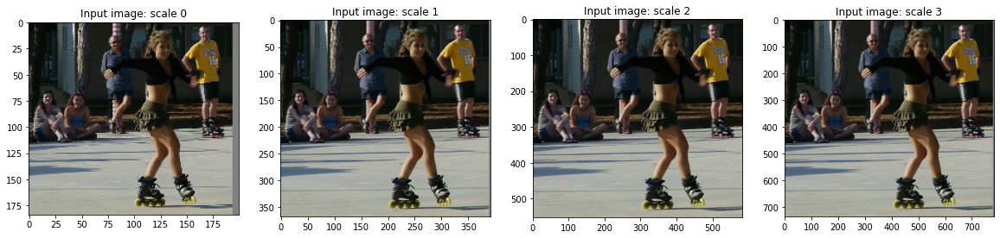

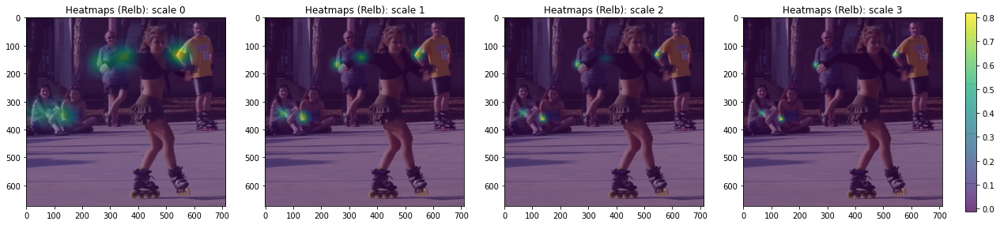

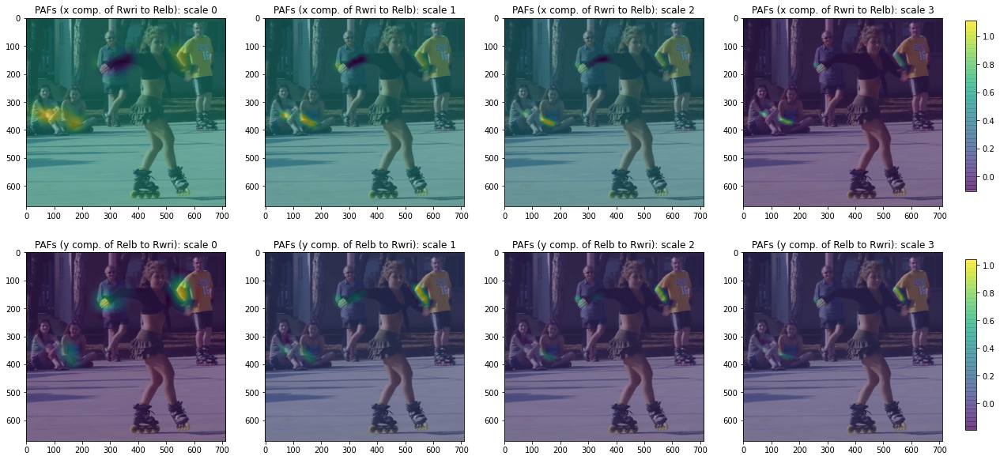

In [ ]:
!mv ./image_2470/out.zip ./

Heatmap for right knee. Note that the body part is encoded in the 3th channel so in this case right knee is
at index 9. All body parts are defined in config:
part_str = [nose, neck, Rsho, Relb, Rwri, Lsho, Lelb, Lwri, Rhip, Rkne, Rank, Lhip, Lkne, Lank, Leye, Reye, Lear, Rear, pt19]

<!-- list(enumerate('nose, neck, Rsho, Relb, Rwri, Lsho, Lelb, Lwri, Rhip, Rkne, Rank, Lhip, Lkne, Lank, Leye, Reye, Lear, Rear, pt19'.split(', ')))-->

<!--![alt text](https://github.com/CMU-Perceptual-Computing-Lab/openpose/raw/master/doc/media/keypoints_pose_18.png)-->
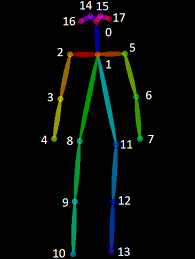

### Visualize keypoint heat maps and pafs

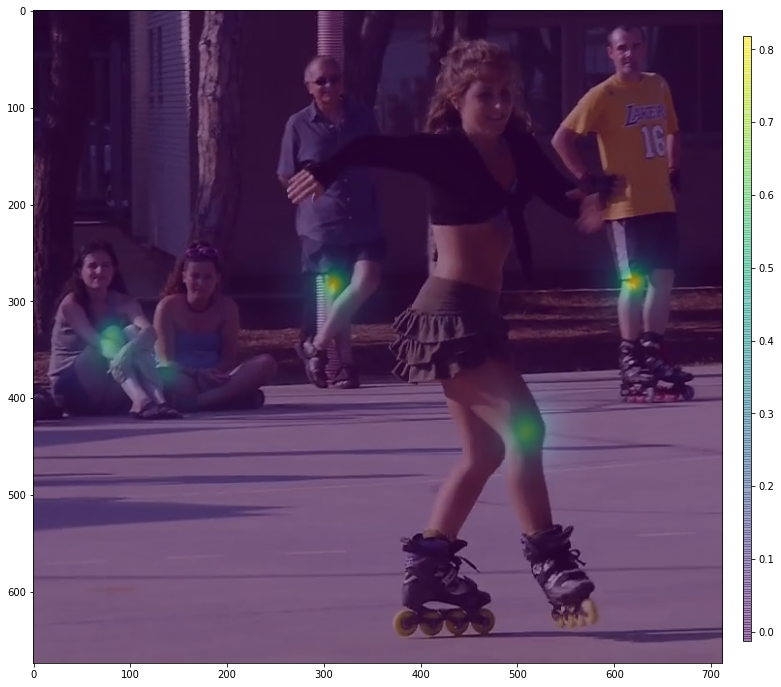

paf vectors for right elbow and right wrist

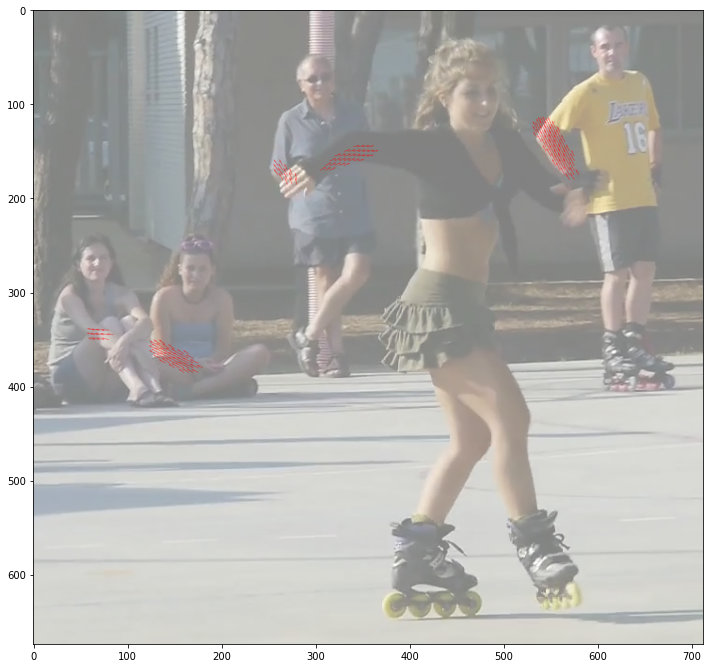

### Detect the body parts (keypoints) in the heat maps and visualize them

Visualise all detected body parts. Note that we use peaks in heatmaps

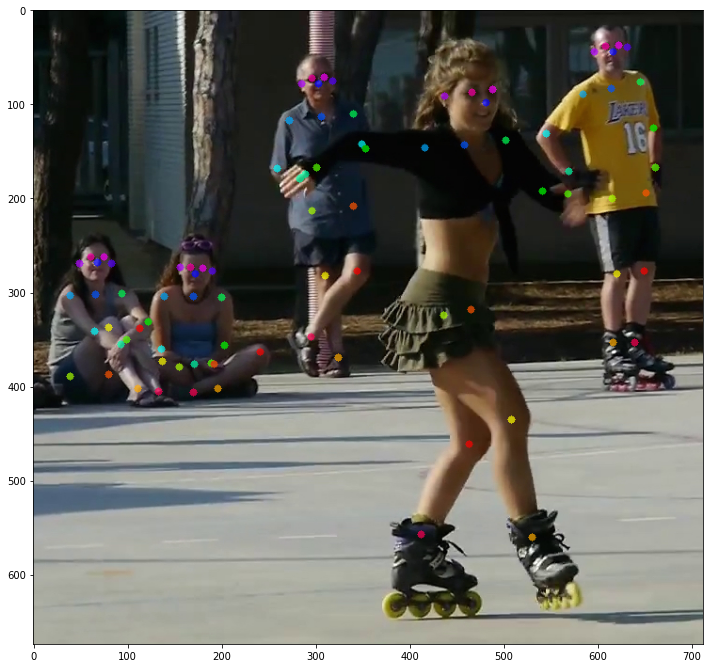

### Link the body parts and visualize them

In [ ]:
# find connection in the specified sequence, center 29 is in the position 15
limbSeq = [[2,3], [2,6], [3,4], [4,5], [6,7], [7,8], [2,9], [9,10], \
           [10,11], [2,12], [12,13], [13,14], [2,1], [1,15], [15,17], \
           [1,16], [16,18], [3,17], [6,18]]
# the middle joints heatmap correpondence
mapIdx = [[31,32], [39,40], [33,34], [35,36], [41,42], [43,44], [19,20], [21,22], \
          [23,24], [25,26], [27,28], [29,30], [47,48], [49,50], [53,54], [51,52], \
          [55,56], [37,38], [45,46]]

In [ ]:
connection_all = []
special_k = []
mid_num = 10

for k in range(len(mapIdx)):
    score_mid = paf_avg[:,:,[x-19 for x in mapIdx[k]]]
    candA = all_peaks[limbSeq[k][0]-1]
    candB = all_peaks[limbSeq[k][1]-1]
    nA = len(candA)
    nB = len(candB)
    indexA, indexB = limbSeq[k]
    if(nA != 0 and nB != 0):
        connection_candidate = []
        for i in range(nA):
            for j in range(nB):
                vec = np.subtract(candB[j][:2], candA[i][:2])
                norm = math.sqrt(vec[0]*vec[0] + vec[1]*vec[1])
                # failure case when 2 body parts overlaps
                if norm == 0:
                    continue
                vec = np.divide(vec, norm)

                startend = list(zip(np.linspace(candA[i][0], candB[j][0], num=mid_num), \
                               np.linspace(candA[i][1], candB[j][1], num=mid_num)))

                vec_x = np.array([score_mid[int(round(startend[I][1])), int(round(startend[I][0])), 0] \
                                  for I in range(len(startend))])
                vec_y = np.array([score_mid[int(round(startend[I][1])), int(round(startend[I][0])), 1] \
                                  for I in range(len(startend))])

                score_midpts = np.multiply(vec_x, vec[0]) + np.multiply(vec_y, vec[1])
                score_with_dist_prior = sum(score_midpts)/len(score_midpts) + min(0.5*oriImg.shape[0]/norm-1, 0)
                criterion1 = len(np.nonzero(score_midpts > param['thre2'])[0]) > 0.8 * len(score_midpts)
                criterion2 = score_with_dist_prior > 0
                if criterion1 and criterion2:
                    connection_candidate.append([i, j, score_with_dist_prior, score_with_dist_prior+candA[i][2]+candB[j][2]])

        connection_candidate = sorted(connection_candidate, key=lambda x: x[2], reverse=True)
        connection = np.zeros((0,5))
        for c in range(len(connection_candidate)):
            i,j,s = connection_candidate[c][0:3]
            if(i not in connection[:,3] and j not in connection[:,4]):
                connection = np.vstack([connection, [candA[i][3], candB[j][3], s, i, j]])
                if(len(connection) >= min(nA, nB)):
                    break

        connection_all.append(connection)
    else:
        special_k.append(k)
        connection_all.append([])

In [ ]:
# last number in each row is the total parts number of that person
# the second last number in each row is the score of the overall configuration
subset = -1 * np.ones((0, 20))
candidate = np.array([item for sublist in all_peaks for item in sublist])

for k in range(len(mapIdx)):
    if k not in special_k:
        partAs = connection_all[k][:,0]
        partBs = connection_all[k][:,1]
        indexA, indexB = np.array(limbSeq[k]) - 1

        for i in range(len(connection_all[k])): #= 1:size(temp,1)
            found = 0
            subset_idx = [-1, -1]
            for j in range(len(subset)): #1:size(subset,1):
                if subset[j][indexA] == partAs[i] or subset[j][indexB] == partBs[i]:
                    subset_idx[found] = j
                    found += 1

            if found == 1:
                j = subset_idx[0]
                if(subset[j][indexB] != partBs[i]):
                    subset[j][indexB] = partBs[i]
                    subset[j][-1] += 1
                    subset[j][-2] += candidate[partBs[i].astype(int), 2] + connection_all[k][i][2]
            elif found == 2: # if found 2 and disjoint, merge them
                j1, j2 = subset_idx
                print ("found = 2")
                membership = ((subset[j1]>=0).astype(int) + (subset[j2]>=0).astype(int))[:-2]
                if len(np.nonzero(membership == 2)[0]) == 0: #merge
                    subset[j1][:-2] += (subset[j2][:-2] + 1)
                    subset[j1][-2:] += subset[j2][-2:]
                    subset[j1][-2] += connection_all[k][i][2]
                    subset = np.delete(subset, j2, 0)
                else: # as like found == 1
                    subset[j1][indexB] = partBs[i]
                    subset[j1][-1] += 1
                    subset[j1][-2] += candidate[partBs[i].astype(int), 2] + connection_all[k][i][2]

            # if find no partA in the subset, create a new subset
            elif not found and k < 17:
                row = -1 * np.ones(20)
                row[indexA] = partAs[i]
                row[indexB] = partBs[i]
                row[-1] = 2
                row[-2] = sum(candidate[connection_all[k][i,:2].astype(int), 2]) + connection_all[k][i][2]
                subset = np.vstack([subset, row])

In [ ]:
# delete some rows of subset which has few parts occur
deleteIdx = [];
for i in range(len(subset)):
    if subset[i][-1] < 4 or subset[i][-2]/subset[i][-1] < 0.4:
        deleteIdx.append(i)
subset = np.delete(subset, deleteIdx, axis=0)

Visualize linked body parts

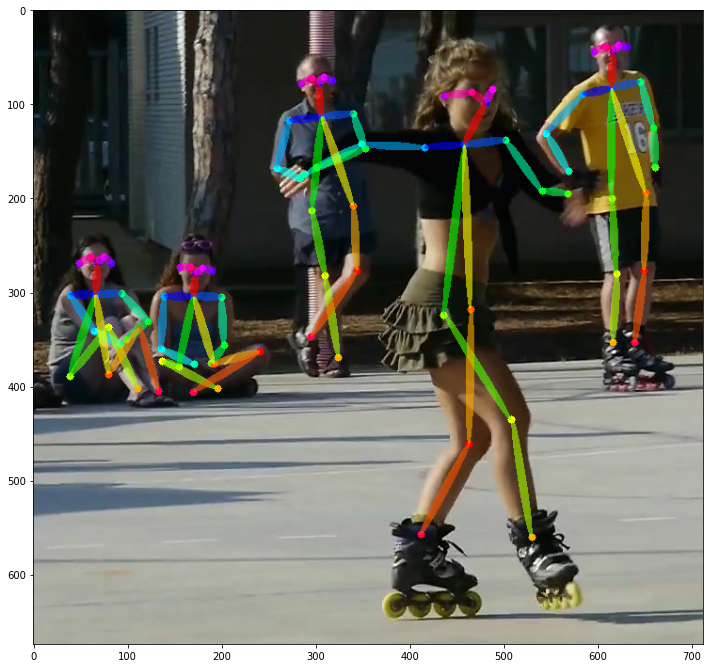

In [ ]:
# visualize 2
stickwidth = 4

for i in range(17):
    for n in range(len(subset)):
        index = subset[n][np.array(limbSeq[i])-1]
        if -1 in index:
            continue
        cur_canvas = canvas.copy()
        Y = candidate[index.astype(int), 0]
        X = candidate[index.astype(int), 1]
        mX = np.mean(X)
        mY = np.mean(Y)
        length = ((X[0] - X[1]) ** 2 + (Y[0] - Y[1]) ** 2) ** 0.5
        angle = math.degrees(math.atan2(X[0] - X[1], Y[0] - Y[1]))
        polygon = cv2.ellipse2Poly((int(mY),int(mX)), (int(length/2), stickwidth), int(angle), 0, 360, 1)
        cv2.fillConvexPoly(cur_canvas, polygon, colors[i])
        canvas = cv2.addWeighted(canvas, 0.4, cur_canvas, 0.6, 0)

plt.imshow(canvas[:,:,[2,1,0]])
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(12, 12)